In [1]:
clear all

In [2]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy import io
import scipy.io as sio
%matplotlib inline 
import pylab
import csv
from Tkinter import Tk
from tkFileDialog import askopenfilename
from tkFileDialog import askdirectory
import nibabel as nb
from scipy import io
from nifti import NiftiImage
import nibabel as nb
from scipy.interpolate import interp1d
from scipy import ndimage

# Open data

In [3]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)

/media/sophie2/862_863/160817/863ss2onc250_862ss2onc250zx2cregcregc862U10sMpsfkf199Smith0_4_60TS.mat


In [4]:
Ua=sio.loadmat(filename)
DT=Ua['TSo']
DT.shape

(2916, 199)

In [5]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)
Ua2=sio.loadmat(filename)
DTroi=Ua2['TSzmapo']
DTroi.shape

/media/sophie2/862_863/160817/863ss2onc250_862ss2onc250zx2cregcregc862U10sMpsfkf199Smith0_4_60TSzmap.mat


(2916, 199)

In [6]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename2 = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename2)

/media/sophie2/862_863/160817/863ss2onc250_862ss2onc250zx2cregcregc862U10sMpsfkf199Smith0_4_60IC.nii


In [7]:
img1 = nb.load(filename2)
data = img1.get_data()
S=data.shape
S

(174, 93, 12, 199)

In [8]:
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)

/media/sophie2/862_863/862ForAlignement/862ss2TimeFluoOn.mat


In [9]:
Ua=sio.loadmat(filename)
Time_fluo862=np.squeeze(Ua['TimeFluoOn'])

In [10]:
Time_fluoICA=Time_fluo862[range(251,Time_fluo862.shape[0])]

Z-score

In [14]:
Demean=np.zeros(S)
Dmaps=np.zeros(S)
Dvar=np.zeros(S)
Var=np.zeros(S[3])
D2=np.zeros([S[0],S[1],5,S[3]])
Tvar=np.zeros(S[3])

In [15]:
for i in range(S[3]):
    Demean[:,:,:,i]=data[:,:,:,i]-np.mean(np.mean(np.mean(data[:,:,:,i],0),0),0)

In [16]:
for i in range(S[3]):
    Dsq=np.reshape(Demean[:,:,:,i],S[0]*S[1]*S[2])
    Var[i]=np.sqrt(np.var(Dsq))
    Dvar=Demean[:,:,:,i]/Var[i]
    Dmaps[:,:,:,i]=Dvar-2
    Tvar[i]=np.var(DT[i,:])
Dmaps[Dmaps<0]=0

# Open Masks

In [24]:
del Masks

In [25]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
from Tkinter import Tk
from tkFileDialog import askopenfilename

Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filenameM = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filenameM)
img1 = nb.load(filenameM)
Masks = img1.get_data()
Sm=Masks.shape
Masks=np.array(Masks)

/home/sophie/Downloads/862ResizedMapsfullpsftrimmed.nii


In [26]:
Sm

(174, 93, 12, 86)

In [27]:
filenameM='/home/sophie/Desktop/Registration/RegionList'
with open(filenameM) as f:
    content = f.readlines()
Names=[Line.split('\t') for Line in content]
RegionName=[Names[i][0] for i in range(75)]
Num=[int(Names[i][2]) for i in range(75)]

# Average in masks to sort components by brain region

In [28]:
M=np.zeros((S[3],86))
Mapmean=np.zeros(S[3])
MMasks=np.zeros(86)
for i in range(S[3]):
    Mapmean[i]=np.mean(np.mean(np.mean(Dmaps[:,:,:,i])))
    for j in range(86):
        MMasks[j]=np.mean(np.mean(np.mean(Masks[:,:,:,j])))
        if MMasks[j]:
            M[i,j]=np.mean(np.mean(np.mean(Masks[:,:,:,j]*Dmaps[:,:,:,i])))/(MMasks[j]*Mapmean[i])

In [29]:
S=M.shape
M2=np.zeros((S[0],75))
for j in range(86):
    J=np.array([l for l in range(75) if Num[l]==j+1])
    if J.shape[0] != 0:
        J=J[0]
        M2[:,J]=M[:,j]
Mnorm=M2
for i in range(75):
    Mnorm[:,i]=M2[:,i]/np.max(M2[:,i])

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide


In [33]:
from rpy2 import robjects
robjects.r['load']('/home/sophie/JefferisData.Rdata')
JefferisData=robjects.r['x']
e=np.array(JefferisData)
enorm=e[10:85,:].astype(float)
for i in range(75):
    enorm[i,:]=np.divide(enorm[i,:],np.max(enorm[i,:]))

In [68]:
Mnorm[np.isnan(Mnorm)]=0

In [76]:
Scores=np.zeros((enorm.shape[1],M2.shape[0]))
for i in range(enorm.shape[1]):
    for j in range(M2.shape[0]):
        #Scores[i,j]=np.inner(enorm[:,i],Mnorm[j,:])
        Scores[i,j]=-sum(abs(enorm[:,i]-Mnorm[j,:]))

In [35]:
import csv
i=0
NeuronName=[]
with open('/home/sophie/fc_name_mapping.csv') as f:
    file_read = csv.reader(f)
    for row in file_read:
        NeuronName.append(row[3])
        i=i+1

In [73]:
CompMainName=S[0]*['']
CompNameAdd=np.zeros((S[0],75))
for i in range(S[0]):
    Max=np.max(M2[i,:])
    J=np.argmax(M2[i,:])
    for j in range(75):
        if M2[i,j]>0.2*Max:
            CompNameAdd[i,j]=1
    CompMainName[i]=Names[np.array(J)][0]

In [74]:
S=data.shape

0
1
AME_R
LO_R
LOP_R
PVLP_R
5
DvGlutMARCM-F002534_seg002
VGlut-F-500422
LO_R
LOP_R
ME_R
59
DvGlutMARCM-F018_seg1
VGlut-F-000001
LO_R
LOP_R
ME_R
GOR_R
69
DvGlutMARCM-F003829_seg002
VGlut-F-300549
LO_R
LOP_R
ME_R
PVLP_R
AOTU_R
GOR_R
LO_L
ME_L
GOR_L
75
DvGlutMARCM-F2176-montage_seg1
VGlut-F-100234
lobula


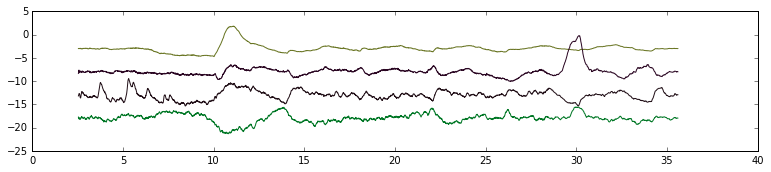

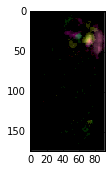

2
NO
IB_R
AOTU_R
GOR_R
SIP_L
PVLP_L
PLP_L
GOR_L
164
DvGlutMARCM-F830_seg1
VGlut-F-100062
nodulus


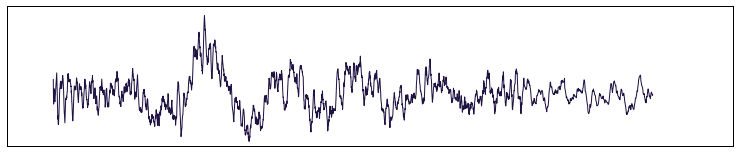

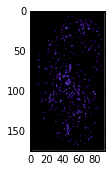

3
BU_R
ICL_R
AOTU_R
BU_L
SLP_L
128
FruMARCM-M001590_seg001
fru-M-200213
bulb


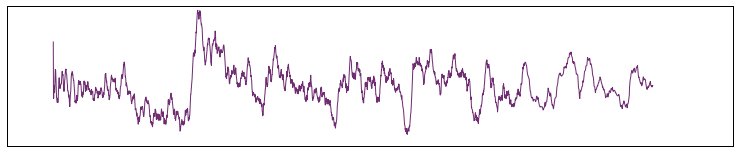

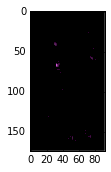

4
PB
IB_R
ICL_L
ATL_L
26
DvGlutMARCM-F561_seg1
VGlut-F-000156
protocerebral bridge


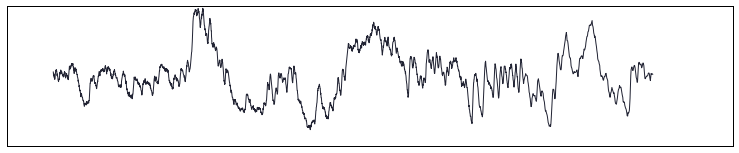

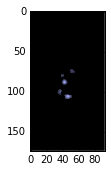

5
LH_R
SIP_R
MB_CA_R
43
DvGlutMARCM-F1730_seg1
VGlut-F-200319
LH_R
LAL_R
AL_R
PLP_R
SCL_R
LH_L
57
DvGlutMARCM-F1734_seg1
VGlut-F-300327
LH_R
103
GadMARCM-F000098_seg002
Gad1-F-600005
LH_R
PVLP_R
106
GadMARCM-F000098_seg002
Gad1-F-600005
lateral horn


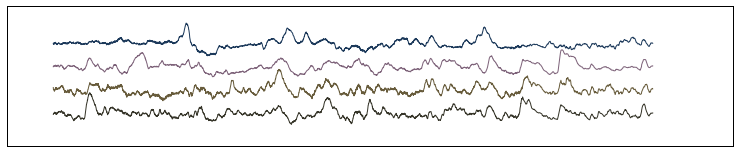

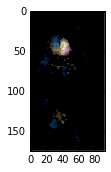

6
LAL_R
AL_R
AVLP_R
GA_R
28
DvGlutMARCM-F003392_seg001
VGlut-F-100293
LAL_R
VES_R
AL_R
GOR_R
87
TPHMARCM-F001394_seg002
Trh-F-100085
lateral accessory lobe


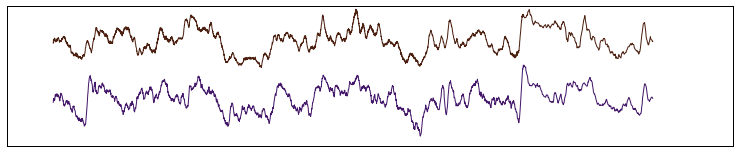

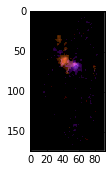

7
SAD
AMMC_R
IVLP_R
PLP_R
GOR_R
IPS_R
PRW
14
DvGlutMARCM-F815_seg1
VGlut-F-400233
saddle


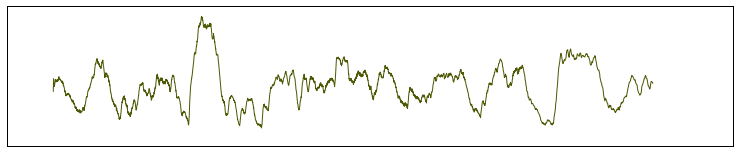

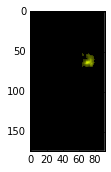

8
9
LAL_R
SAD
AMMC_R
AL_R
AVLP_R
PVLP_R
IVLP_R
7
THMARCM-581F_seg
TH-F-000025
antennal mechanosensory and motor center


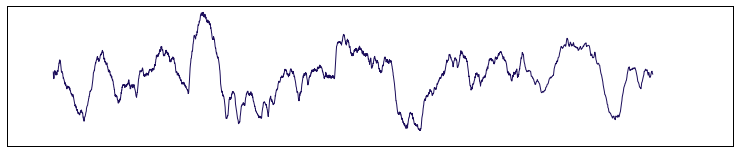

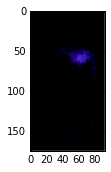

10
ICL_R
IB_R
AOTU_R
GOR_R
AVLP_L
AOTU_L
GOR_L
35
DvGlutMARCM-F003622_seg001
VGlut-F-000556
inferior clamp


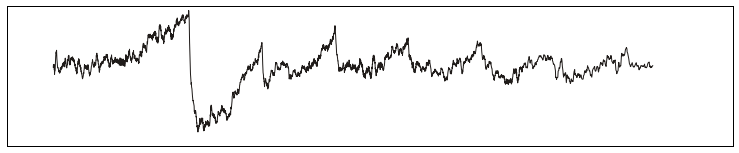

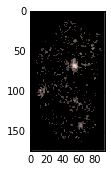

11
LAL_R
VES_R
AL_R
GOR_R
BU_L
PVLP_L
33
FruMARCM-M001633_seg001
fru-M-000084
vest


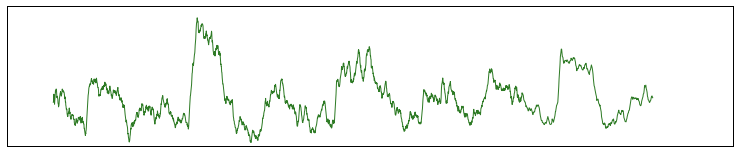

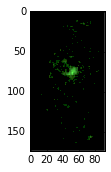

12
IB_R
GOR_R
SPS_R
IPS_R
SPS_L
1
DvGlutMARCM-F080_seg1
VGlut-F-200049
IB_R
FB
GOR_R
IB_L
17
TPHMARCM-071F_seg1
Trh-F-100028
inferior bridge


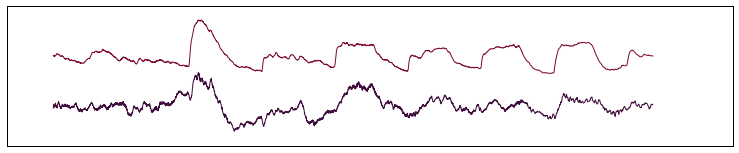

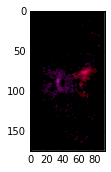

13
PB
ATL_R
BU_L
ATL_L
GOR_L
20
DvGlutMARCM-F1742_seg2
VGlut-F-100188
antler


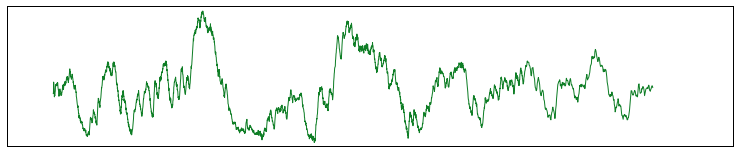

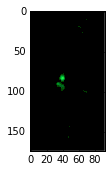

14
CRE_R
AL_R
GOR_R
CRE_L
AL_L
52
TPHMARCM-M001433_seg001
Trh-M-000031
crepine


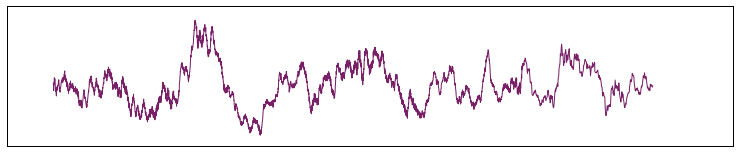

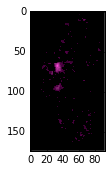

15
ICL_R
MB_PED_R
PVLP_R
GOR_R
CAN_L
PVLP_L
97
DvGlutMARCM-F003622_seg001
VGlut-F-000556
BU_R
ICL_R
MB_PED_R
MB_VL_R
AOTU_R
MB_CA_R
SCL_R
GA_R
GOR_L
105
DvGlutMARCM-F061_seg1
VGlut-F-200036
pedunculus of adult mushroom body


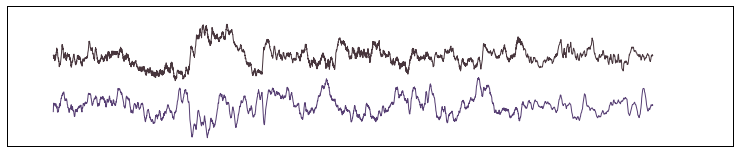

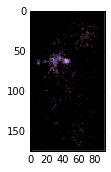

16
CRE_R
MB_PED_R
MB_VL_R
MB_ML_R
SIP_R
AOTU_R
25
TPHMARCM-M001763_seg002
Trh-M-200129
vertical lobe of adult mushroom body


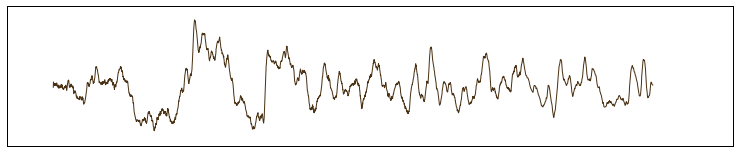

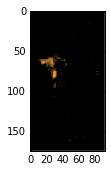

17
NO
CRE_R
MB_PED_R
MB_ML_R
SCL_R
12
TPHMARCM-M001434_seg001
Trh-M-200075
medial lobe of adult mushroom body


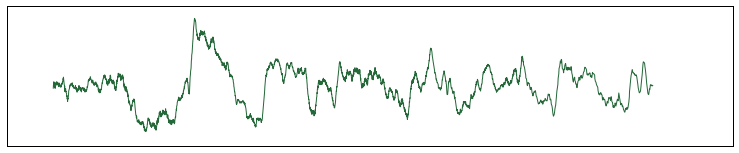

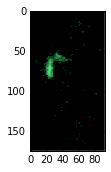

18
19
LO_R
LOP_R
ME_R
AOTU_R
22
DvGlutMARCM-F002825_seg001
VGlut-F-600437
LO_R
LOP_R
ME_R
60
DvGlutMARCM-F002804_seg001
VGlut-F-700175
lobula plate


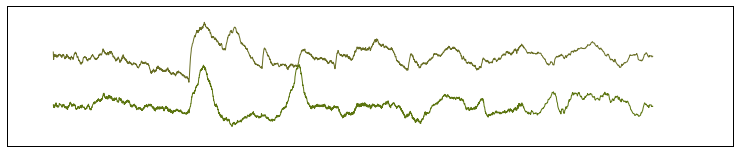

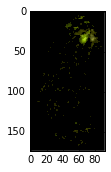

20
NO
EB
FB
79
ChaMARCM-F000069_seg001
Cha-F-000010
CAN_R
EB
FB
CRE_L
88
TPHMARCM-1088M_seg1
Trh-M-400087
EB
100
GadMARCM-F000290_seg001
Gad1-F-300071
ellipsoid body


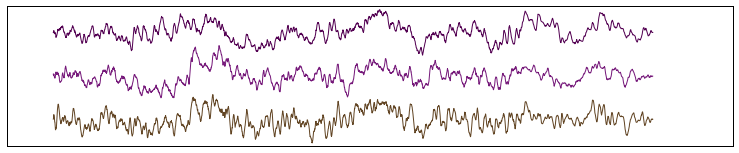

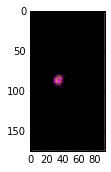

21
22
ME_R
3
TPHMARCM-1033M_seg1
Trh-M-700055
ME_R
4
TPHMARCM-1033M_seg1
Trh-M-700055
ME_R
8
TPHMARCM-1033M_seg1
Trh-M-700055
AME_R
ME_R
27
TPHMARCM-1033M_seg1
Trh-M-700055
LO_R
ME_R
29
TPHMARCM-1033M_seg1
Trh-M-700055
LO_R
LOP_R
ME_R
42
TPHMARCM-1033M_seg1
Trh-M-700055
LO_R
LOP_R
ME_R
GOR_R
CAN_L
ME_L
SIP_L
AVLP_L
PVLP_L
77
TPHMARCM-482M_seg1
Trh-M-100039
LO_R
ME_R
83
TPHMARCM-041F_seg1
Trh-F-300000
NO
ME_R
PVLP_R
AOTU_R
GOR_R
ME_L
AVLP_L
PVLP_L
EPA_L
120
TPHMARCM-317F-montage_seg1
Trh-F-000025
medulla


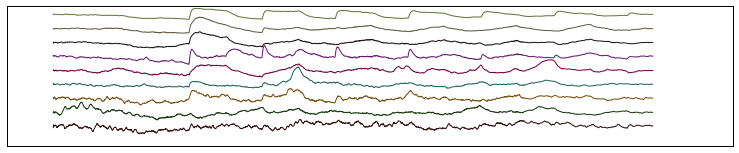

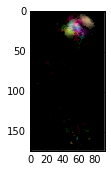

23
NO
FB
AOTU_L
51
TPHMARCM-1156M_seg2
Trh-M-100071
ICL_R
IB_R
FB
AOTU_R
GOR_R
BU_L
SLP_L
AVLP_L
GA_L
64
DvGlutMARCM-F362_seg1
VGlut-F-400074
FB
BU_L
138
DvGlutMARCM-F362_seg1
VGlut-F-400074
fan-shaped body


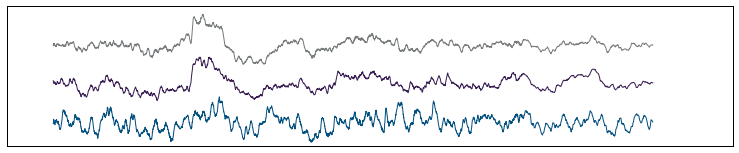

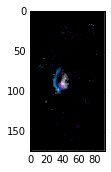

24
25
26
ICL_R
SMP_R
99
THMARCM-610M_seg
TH-M-000038
superior medial protocerebrum


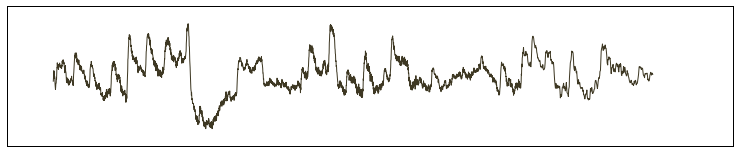

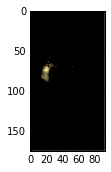

27
28
29
SAD
PVLP_R
IVLP_R
PLP_R
IPS_R
102
THMARCM-092M_seg1
TH-M-300016
wedge


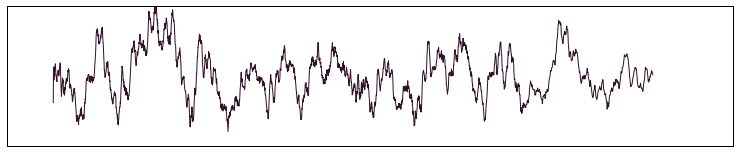

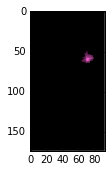

30
ICL_R
PVLP_R
PLP_R
GOR_R
SCL_R
PVLP_L
54
TPHMARCM-204M_seg1
Trh-M-200014
posterior lateral protocerebrum


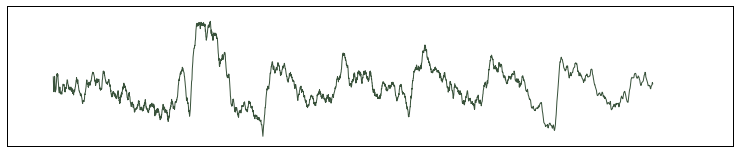

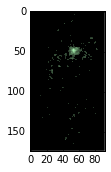

31
ICL_R
AOTU_R
CRE_L
SLP_L
SIP_L
AVLP_L
PVLP_L
AOTU_L
109
DvGlutMARCM-F830_seg1
VGlut-F-100062
NO
ICL_R
SLP_R
PVLP_R
AOTU_R
GOR_R
AVLP_L
PVLP_L
159
ChaMARCM-F000627_seg001
Cha-F-500128
anterior optic tubercle


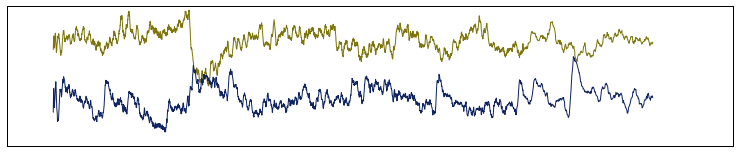

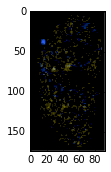

32
NO
ICL_R
PVLP_R
AOTU_R
GOR_R
PRW
AVLP_L
PVLP_L
GOR_L
139
FruMARCM-M001057_seg001
fru-M-500095
gorget


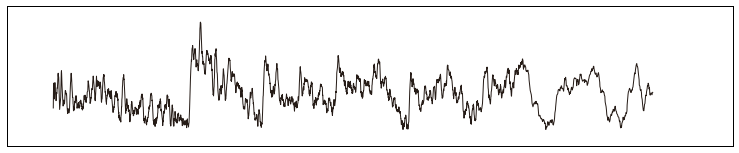

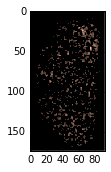

33
ICL_R
MB_PED_R
MB_CA_R
SCL_R
BU_L
MB_CA_L
SCL_L
58
DvGlutMARCM-F449_seg1
VGlut-F-000090
calyx of adult mushroom body


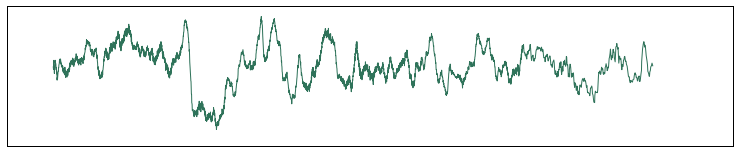

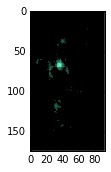

34
35
VES_R
IB_R
AOTU_R
GOR_R
SPS_R
IPS_R
IPS_L
31
FruMARCM-M001056_seg002
fru-M-500094
inferior posterior slope


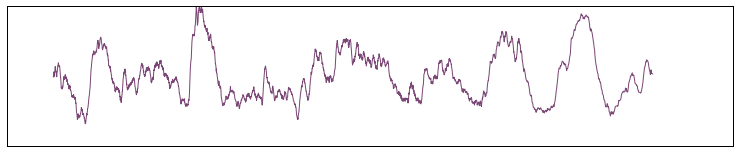

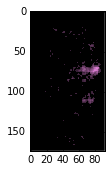

36
ICL_R
IB_R
SLP_R
GOR_R
MB_CA_R
SCL_R
GOR_L
74
TPHMARCM-204M_seg1
Trh-M-200014
superior clamp


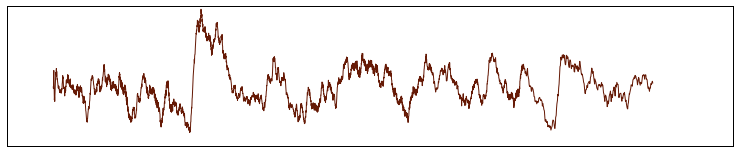

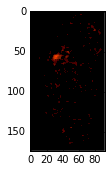

37
38
39
40
CRE_R
AL_R
AOTU_R
GA_R
CRE_L
AVLP_L
PVLP_L
GOR_L
62
DvGlutMARCM-F1349_seg1
VGlut-F-200271
gall


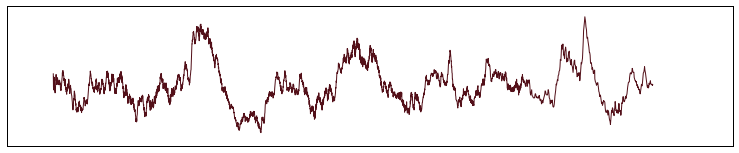

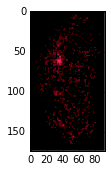

41
42
GOR_R
LO_L
BU_L
LOP_L
ME_L
10
DvGlutMARCM-F608_seg001
VGlut-F-300102
LO_L
AVLP_L
PVLP_L
92
ChaMARCM-F000004_seg002
Cha-F-200001
lobula


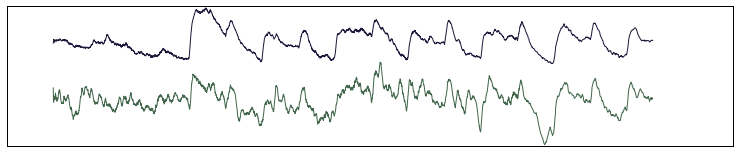

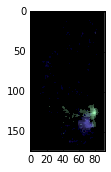

43
ME_R
BU_L
55
DvGlutMARCM-F158_seg1
VGlut-F-800007
AVLP_R
PVLP_R
AOTU_R
GOR_R
BU_L
AVLP_L
PVLP_L
169
FruMARCM-M001917_seg001
fru-M-800079
bulb


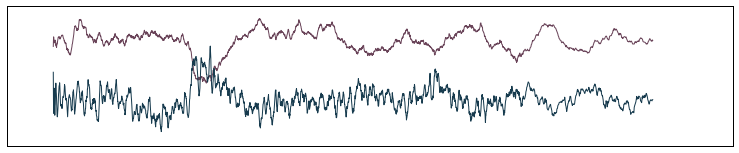

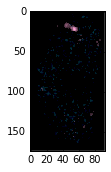

44
LH_L
AVLP_L
PVLP_L
137
ChaMARCM-F000367_seg002
Cha-F-600032
lateral horn


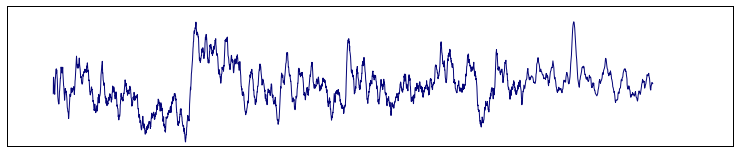

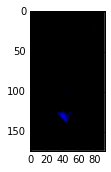

45
BU_L
LAL_L
CRE_L
AL_L
GOR_L
EPA_L
50
TPHMARCM-M001616_seg001
Trh-M-200087
lateral accessory lobe


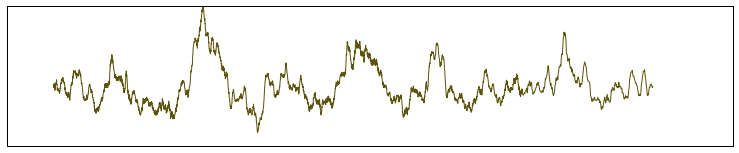

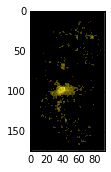

46
47
48
BU_R
EB
PRW
BU_L
ICL_L
AVLP_L
24
GadMARCM-F000682_seg001
Gad1-F-000086
inferior clamp


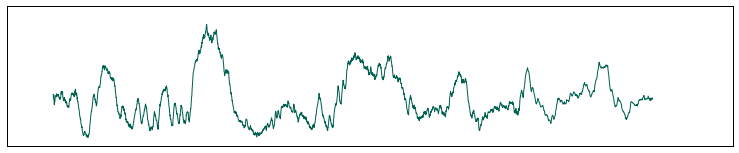

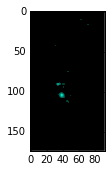

49
LAL_L
VES_L
AL_L
GOR_L
SCL_L
EPA_L
30
FruMARCM-M000222_seg001
fru-M-700017
vest


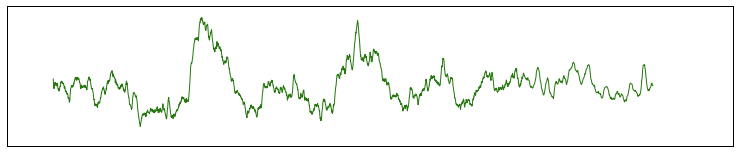

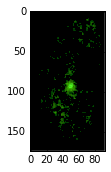

50
51
PB
ICL_R
IB_R
ATL_R
FB
ATL_L
GOR_L
18
DvGlutMARCM-F561_seg1
VGlut-F-000156
PB
IB_R
AOTU_R
GOR_R
ATL_L
146
THMARCM-592F_seg1
TH-F-000029
antler


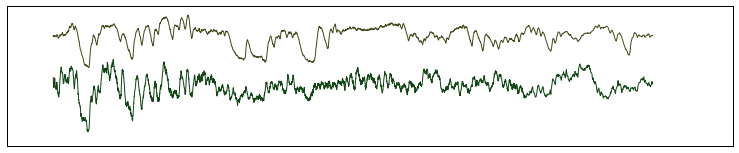

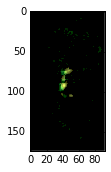

52
MB_ML_R
CRE_L
MB_ML_L
44
THMARCM-541M_seg1
TH-M-300055
crepine


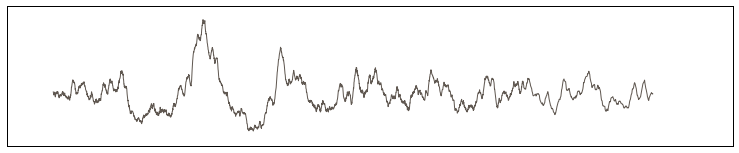

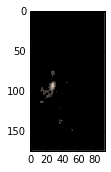

53
CRE_L
MB_PED_L
MB_ML_L
AVLP_L
PVLP_L
SCL_L
9
DvGlutMARCM-F002239_seg001
VGlut-F-000488
pedunculus of adult mushroom body


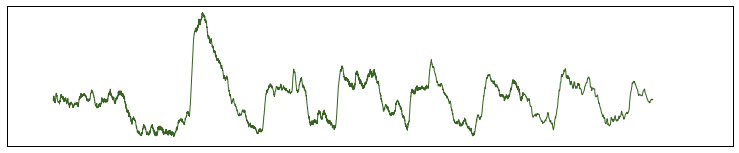

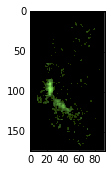

54
IB_R
CRE_L
MB_VL_L
SIP_L
SMP_L
GA_L
154
THMARCM-509F_seg1
TH-F-100060
vertical lobe of adult mushroom body


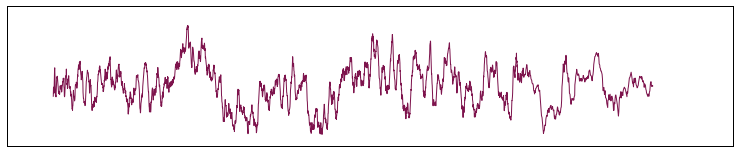

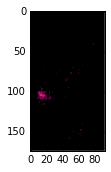

55
56
57
BU_R
ICL_R
IB_R
LOP_R
AOTU_R
IPS_R
LOP_L
2
DvGlutMARCM-F881_seg1
VGlut-F-400254
LO_L
LOP_L
ME_L
41
DvGlutMARCM-F1291_seg1
VGlut-F-200253
lobula plate


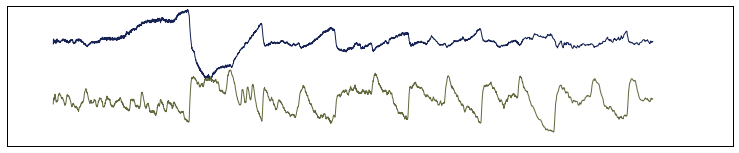

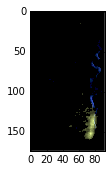

58
CRE_R
AL_R
AOTU_R
LAL_L
CRE_L
AL_L
GOR_L
SCL_L
61
TPHMARCM-M001433_seg001
Trh-M-000031
adult antennal lobe


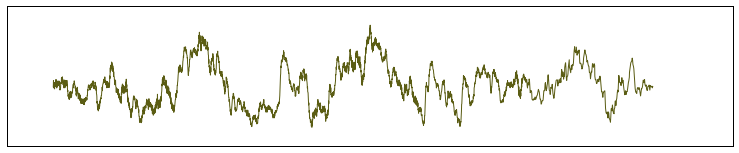

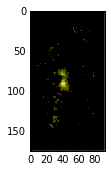

59
BU_R
BU_L
ME_L
6
TPHMARCM-001F_seg1
Trh-F-100000
LO_L
ME_L
13
TPHMARCM-001F_seg1
Trh-F-100000
LOP_L
ME_L
16
FruMARCM-M000894_seg001
fru-M-500076
LO_L
BU_L
LOP_L
ME_L
19
TPHMARCM-001F_seg1
Trh-F-100000
CAN_R
ME_L
SIP_L
39
TPHMARCM-001F_seg1
Trh-F-100000
LO_L
LOP_L
ME_L
46
DvGlutMARCM-F608_seg001
VGlut-F-300102
AOTU_R
GOR_R
CAN_L
ME_L
PVLP_L
53
TPHMARCM-001F_seg1
Trh-F-100000
LO_L
LOP_L
ME_L
AVLP_L
65
TPHMARCM-001F_seg1
Trh-F-100000
LO_L
ME_L
GOR_L
67
TPHMARCM-001F_seg1
Trh-F-100000
ME_L
80
TPHMARCM-001F_seg1
Trh-F-100000
NO
ICL_R
LO_L
IB_L
ME_L
AVLP_L
PVLP_L
GOR_L
82
DvGlutMARCM-F1120-montage_seg1
VGlut-F-200202
ME_R
ME_L
86
TPHMARCM-001F_seg1
Trh-F-100000
ME_L
93
TPHMARCM-001F_seg1
Trh-F-100000
LO_L
BU_L
ME_L
104
DvGlutMARCM-F608_seg001
VGlut-F-300102
ME_L
116
TPHMARCM-001F_seg1
Trh-F-100000
BU_R
AVLP_R
ME_L
AVLP_L
PVLP_L
EPA_L
127
DvGlutMARCM-F002951_seg001
VGlut-F-900062
BU_R
LO_L
ME_L
133
TPHMARCM-001F_seg1
Trh-F-100000
medulla


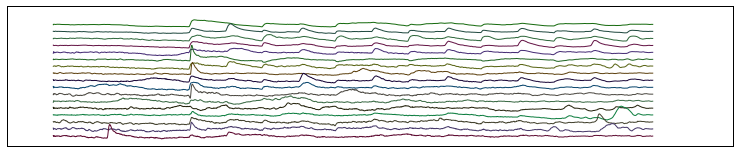

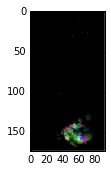

60
BU_R
ME_R
LH_L
ME_L
SLP_L
PVLP_L
SCL_L
72
ChaMARCM-F000878_seg002
Cha-F-000158
GOR_R
CRE_L
SLP_L
SIP_L
SMP_L
AVLP_L
GOR_L
91
DvGlutMARCM-F190_seg1
VGlut-F-000024
superior lateral protocerebrum


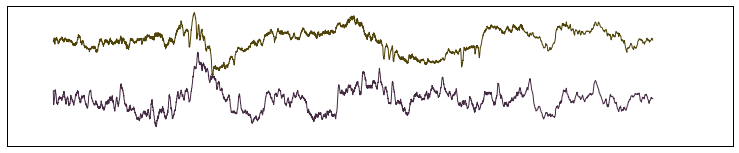

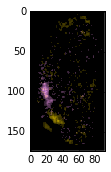

61
GOR_R
BU_L
CRE_L
MB_PED_L
MB_VL_L
MB_ML_L
SIP_L
AOTU_L
81
DvGlutMARCM-F003330_seg001
VGlut-F-000498
superior intermediate protocerebrum


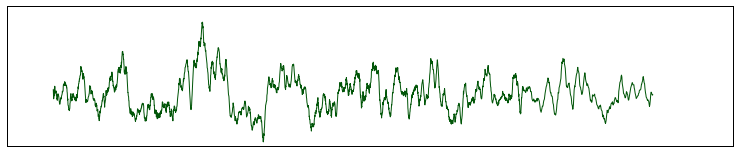

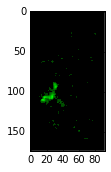

62
ME_L
SMP_L
63
DvGlutMARCM-F402_seg1
VGlut-F-000077
superior medial protocerebrum


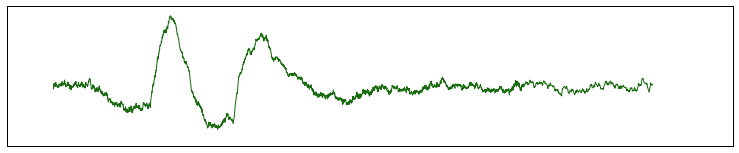

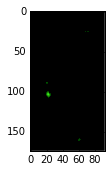

63
AVLP_R
PVLP_R
AOTU_R
GOR_R
AVLP_L
PVLP_L
AOTU_L
66
DvGlutMARCM-F1222_seg1
VGlut-F-400341
PVLP_R
AOTU_R
GOR_R
LO_L
BU_L
AVLP_L
PVLP_L
GOR_L
149
DvGlutMARCM-F1120-montage_seg1
VGlut-F-200202
anterior ventrolateral protocerebrum


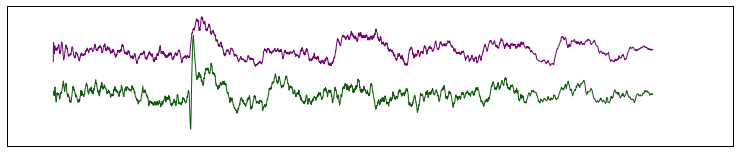

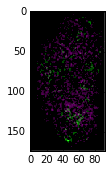

64
AME_R
LO_L
LOP_L
ME_L
SLP_L
PVLP_L
PLP_L
SCL_L
21
DvGlutMARCM-F151-X2_seg1
VGlut-F-000013
posterior ventrolateral protocerebrum


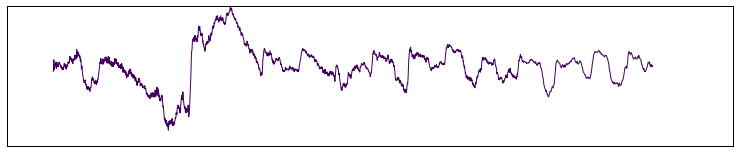

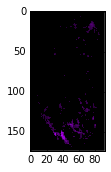

65
SAD
IPS_R
AMMC_L
AVLP_L
IVLP_L
PLP_L
IPS_L
36
FruMARCM-M000210_seg001
fru-M-400001
wedge


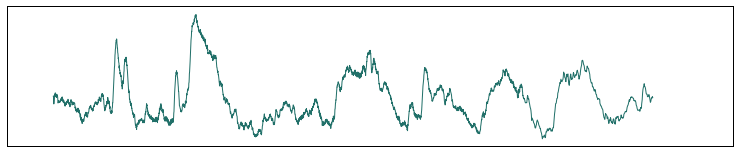

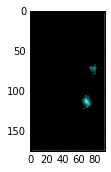

66
67
68
AOTU_R
GOR_R
LO_L
ME_L
AVLP_L
PVLP_L
GOR_L
70
DvGlutMARCM-F1120-montage_seg1
VGlut-F-200202
gorget


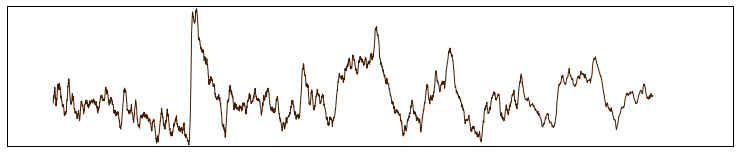

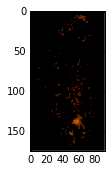

69
SLP_L
SMP_L
MB_CA_L
90
DvGlutMARCM-F577_seg1
VGlut-F-000167
calyx of adult mushroom body


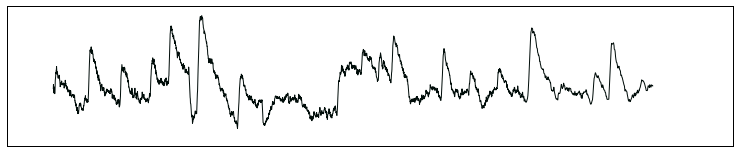

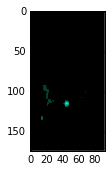

70
AVLP_L
PVLP_L
GOR_L
SPS_L
EPA_L
37
FruMARCM-F000428_seg001
fru-F-300032
superior posterior slope


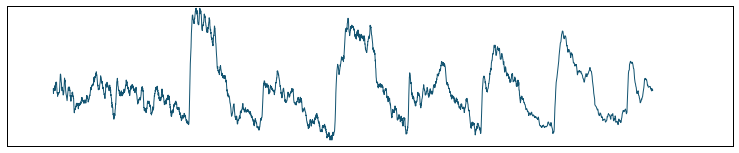

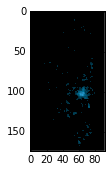

71
IPS_R
VES_L
AOTU_L
SPS_L
IPS_L
EPA_L
11
ChaMARCM-F000364_seg001
Cha-F-900026
inferior posterior slope


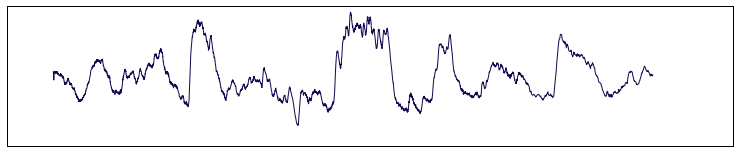

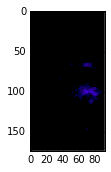

72
73


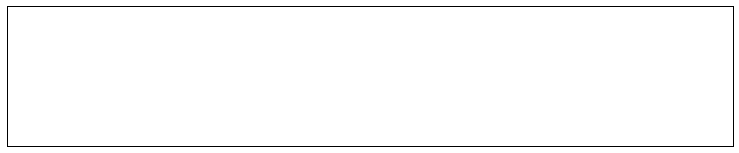

In [77]:
pylab.rcParams['figure.figsize'] = (13, 2.5)

h=5
tot=0
GoodICAnat=np.zeros(S[3])

for l in range(74):
    Final_maps=np.zeros((S[0],S[1],3))
    Fmap=np.zeros((S[0],S[1],3))
    C=np.zeros(3)
    print(l)
    n=0
    for i in range(len(CompMainName)):                    
        Dmmv=np.mean(data[:,:,:,i],2) 
        Dmmv[Dmmv<0.2*np.max(np.max(np.max(Dmmv)))]=0
        C=np.squeeze(np.random.rand(3,1))
        labeled, nrobject=ndimage.label(Dmmv>0)
        
        if CompMainName[i]==Names[l][0] and (sum(CompNameAdd[i,:])<10) and nrobject<2000:
            n=n+1            
            
            for k in range(3):
                Fmap[:,:,k]=0.7*Dmmv*C[k]/np.max(C)
            Final_maps=Final_maps+Fmap
            plt.plot(Time_fluoICA.T,(DT[:,i]/np.sqrt(np.var(DT[:,i]))-h*n+2),color=C/2)        
            tot=tot+1
            GoodICAnat[i]=1
            #print(i)
            for j in range(75):
                if CompNameAdd[i,j]==1:                
                    print(Names[np.array(j)][0])
            print(i)
            I=np.argmax(Scores[:,i])
            #print(I)
            print(e[0][I])
            print(NeuronName[np.int(np.float(e[3][I]))])
            
    #plt.plot(Time_fluoICA.T,Xk[:,0]/np.std(Xk[:,0])+2,color=(1,0,0))   
    #plt.plot(Time_fluoICA.T,Xk[:,1]/np.std(Xk[:,1])+2,color=(0.5,0.5,0))
    #plt.plot(Time_fluoICA.T,Xk[:,4]/np.std(Xk[:,4])+6,color=(1,0,1))
    #plt.plot(Time_fluoICA.T,Xk[:,6]/np.std(Xk[:,6])+12,color=(0,1,0))
    #plt.plot(Time_fluoICA.T,Xk[:,7]/np.std(Xk[:,7])+12,color=(0,0,1))
    #plt.plot(Time_fluoICA.T,2*Xk[:,2]/np.max(Xk[:,2])+1.5,color=(1,0,1))    
    if n!=0:
        print(Names[l][1])

        plt.show()
        FM=Final_maps/np.max(np.max(Final_maps))
        FM[FM<0.1]=0
        plt.imshow(FM,interpolation='none')
        plt.show()
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        
# Open template

# Last pruning by hand

In [26]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
from Tkinter import Tk
from tkFileDialog import askopenfilename

Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filenamet = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filenamet)
nimt=NiftiImage(filenamet)
Dtemp=np.squeeze(nimt.data.T)
Dtemp.shape

/home/sophie/Desktop/Registration/862_863/Template4alignement2anatomypsf.nii


(174, 93, 12)

In [27]:
%%javascript
IPython.OutputArea.auto_scroll_threshold =4000;

In [28]:
if S[2]>5:
    Nstack=5
    Int100=[(i+1)*100/Nstack for i in range(Nstack)]
    Percs=np.percentile(range(S[2]),Int100)
    Indices=np.split(range(S[2]),Percs)
    D1=np.zeros([S[0],S[1],Nstack])
    Dmean=np.squeeze(data[:,:,range(Nstack),2])
    for i in range(Nstack):
        Vmean=np.mean(Dtemp[:,:,Indices[i]],2)
        Dmean[:,:,i]=Vmean
else:
    Nstack=S[2]
    D1=np.zeros([S[0],S[1],S[2]])
    Dmean=data[:,:,range(S[2])]  
    Dmean=np.squeeze(Dtemp[:,:,:])

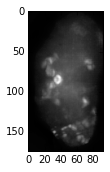

In [29]:
plt.imshow(Dmean[:,:,1],cmap=plt.cm.gray)

In [30]:
S

(174, 93, 12, 199)

In [37]:
my_cmap=plt.cm.jet
my_cmap.set_bad(alpha=0)
Good_ICs=np.zeros(S[3])
Label_ICs=[]
pylab.rcParams['figure.figsize'] = (15, 4)

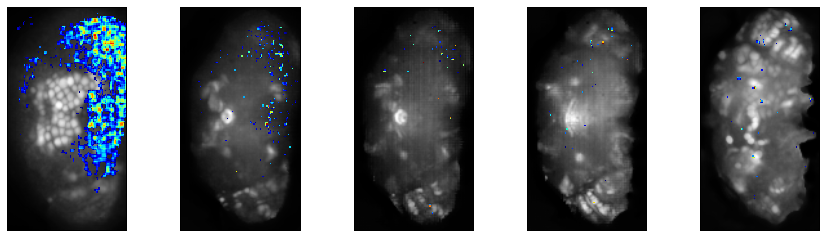

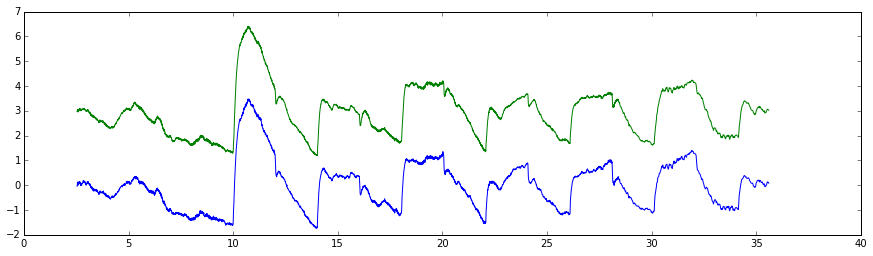

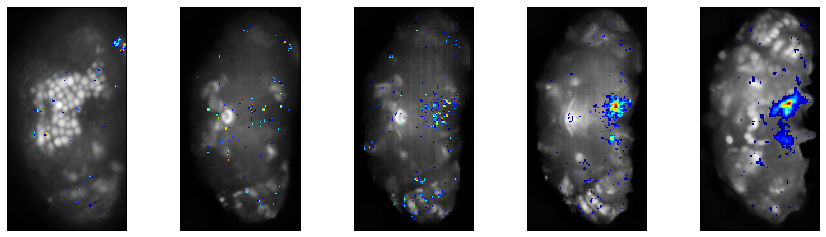

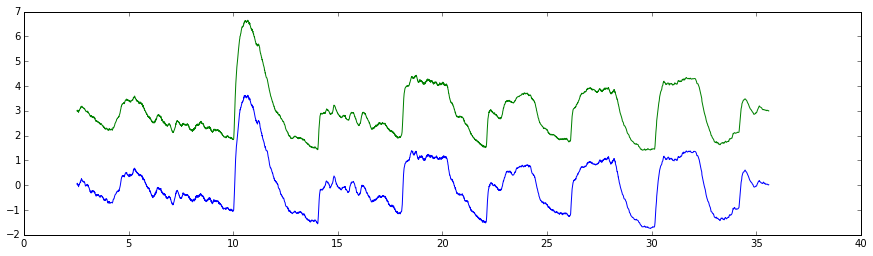

a


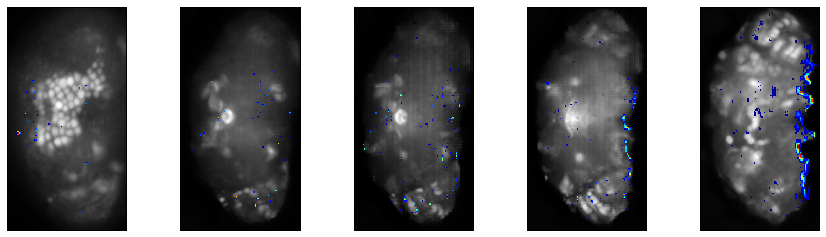

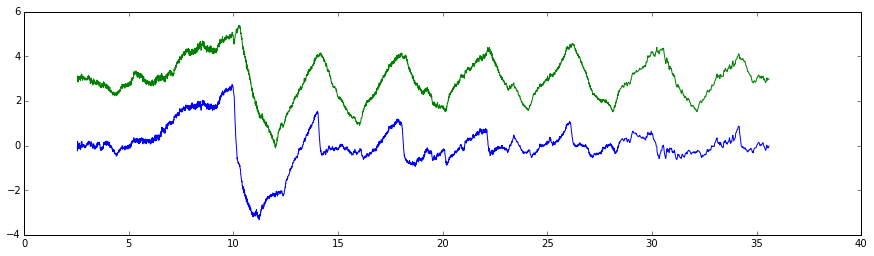

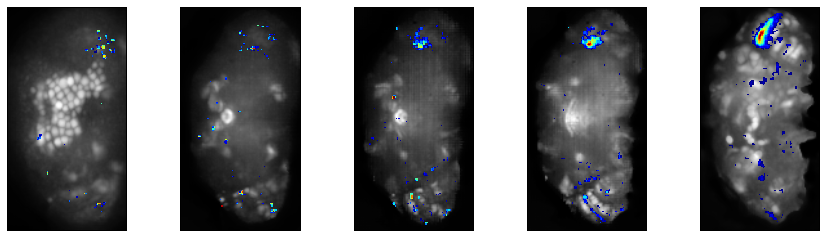

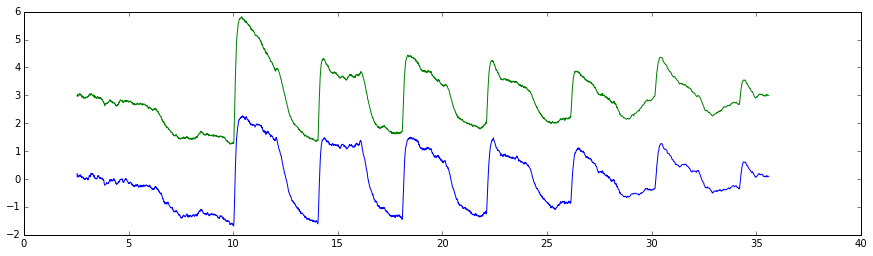

a


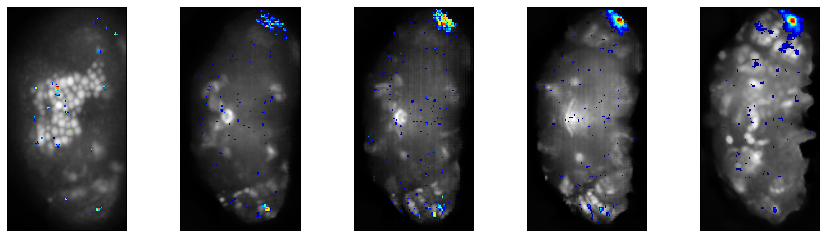

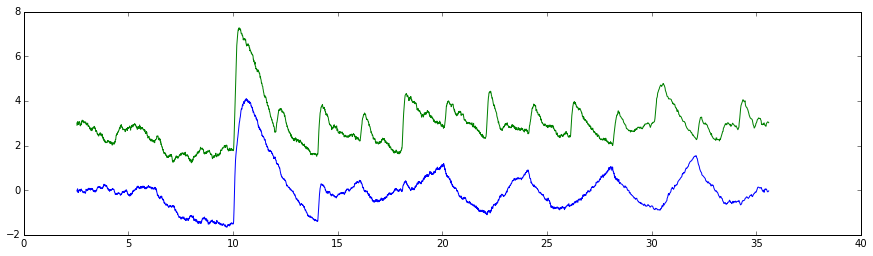

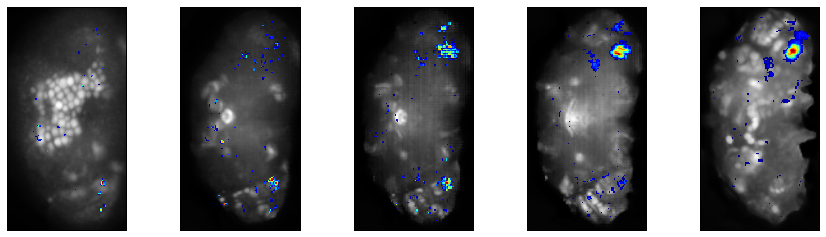

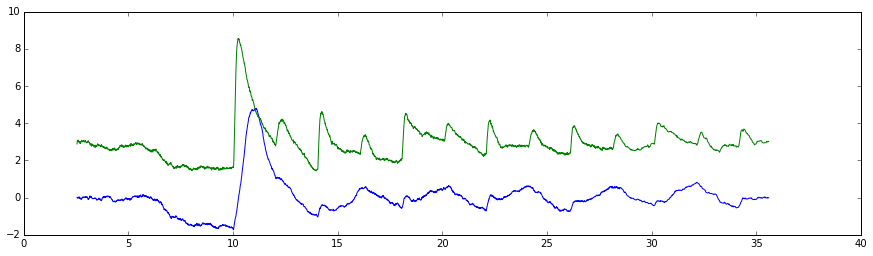

a


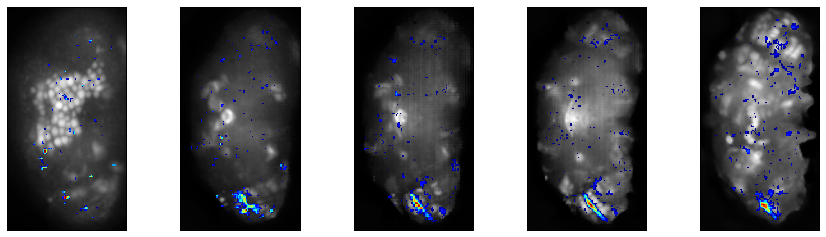

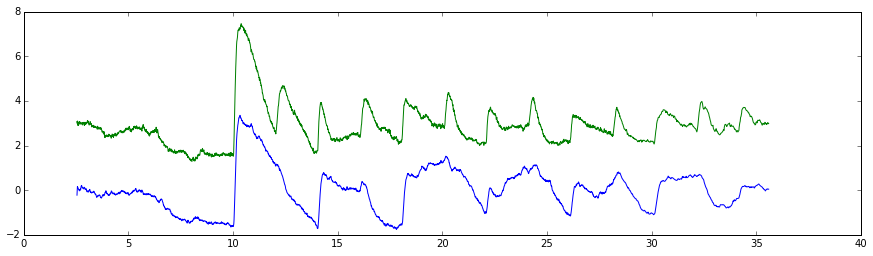

a


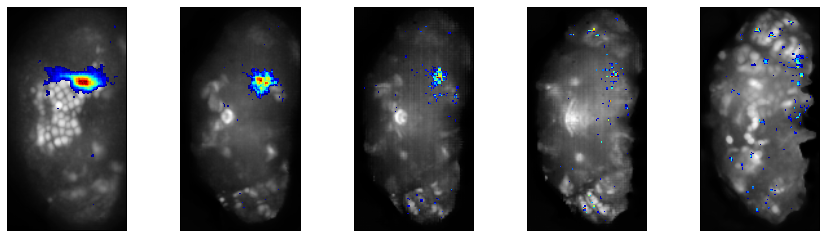

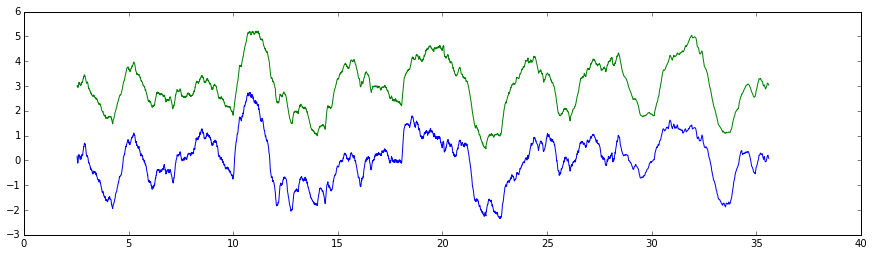

a


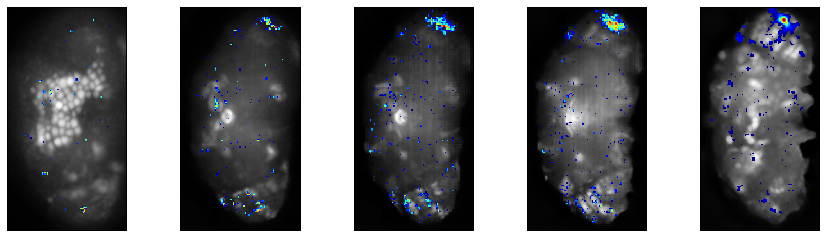

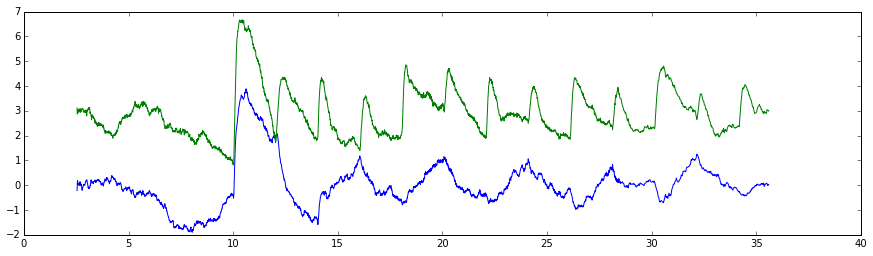

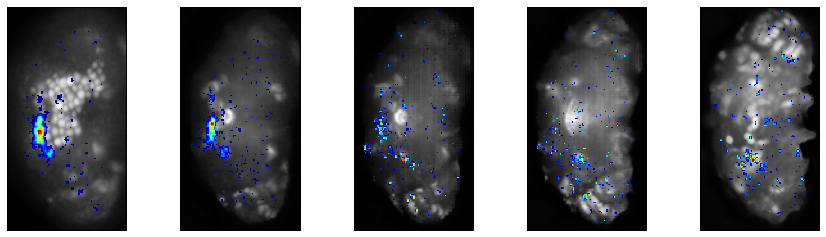

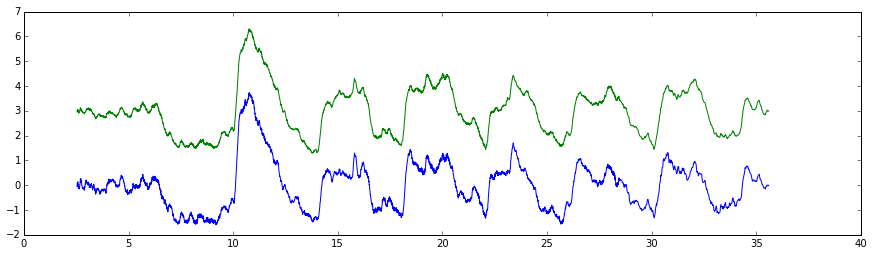

a


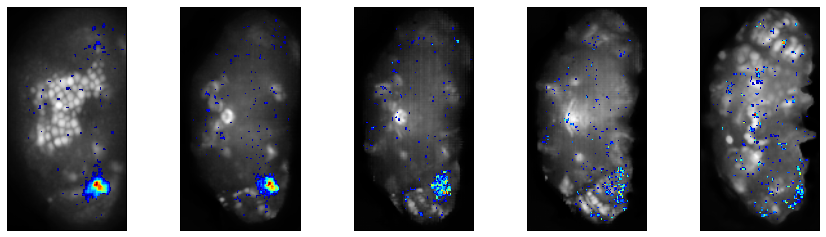

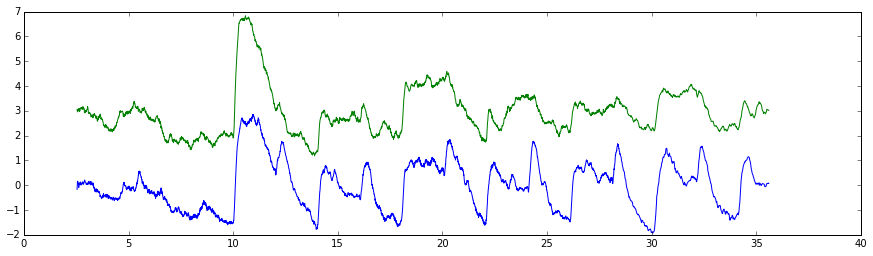

a


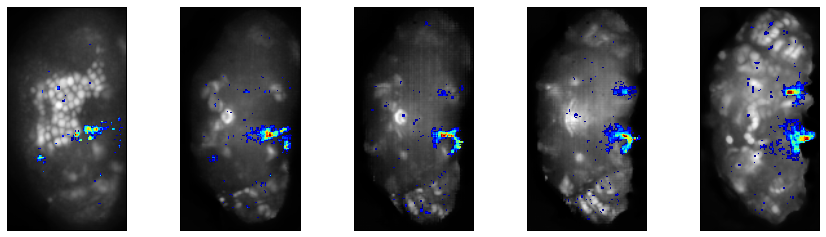

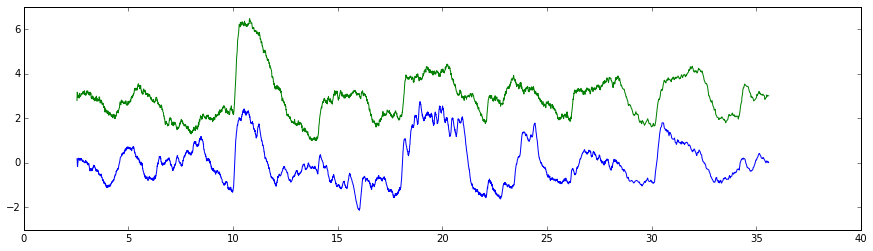

a


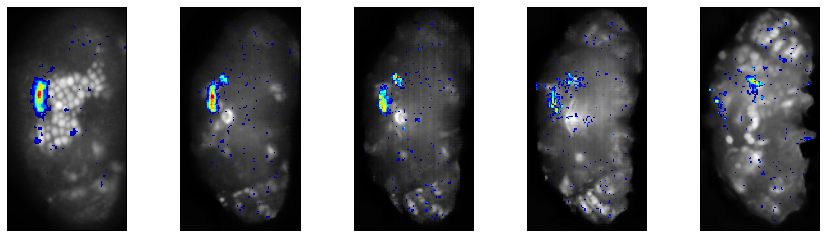

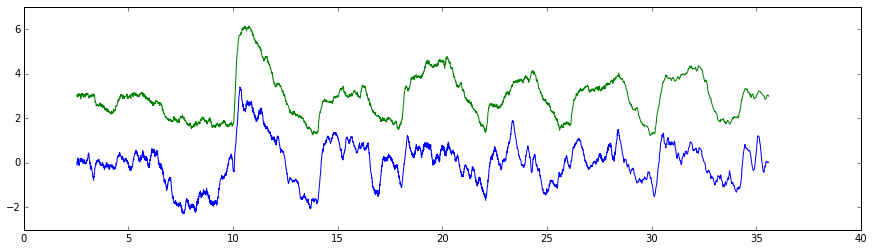

a


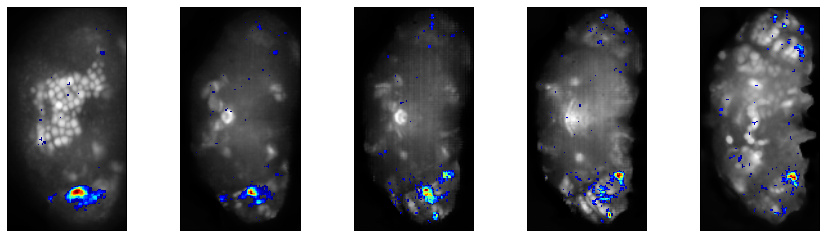

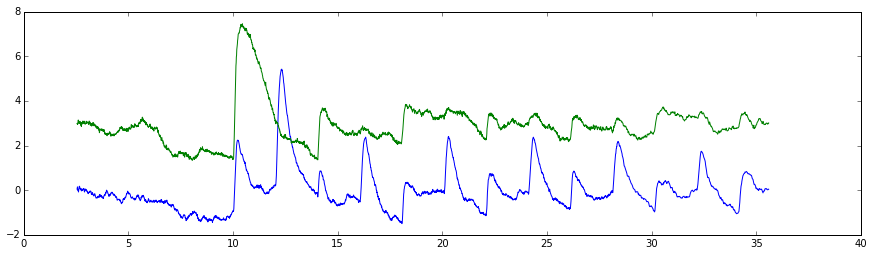

a


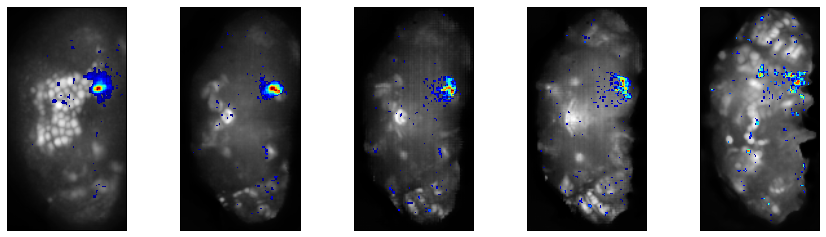

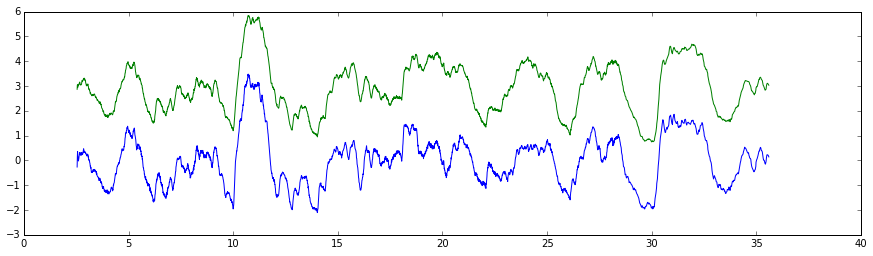

a


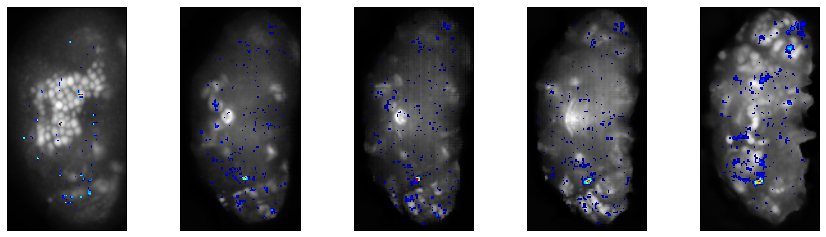

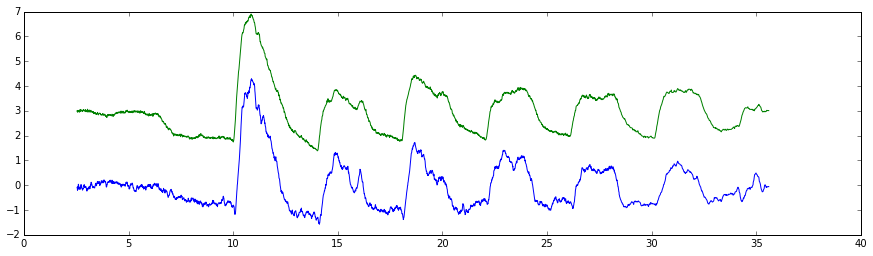

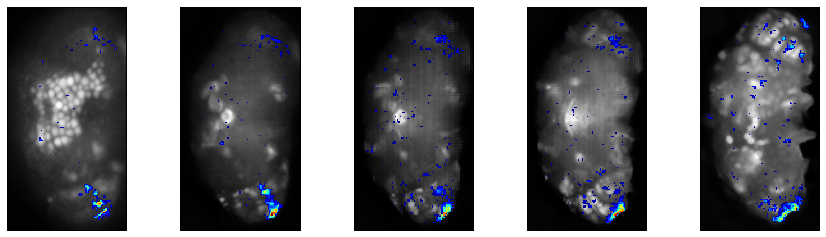

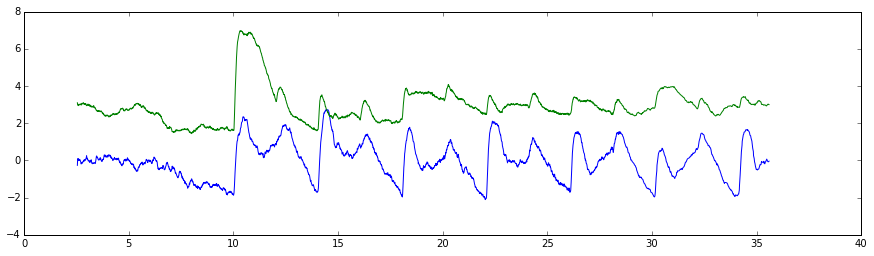

a


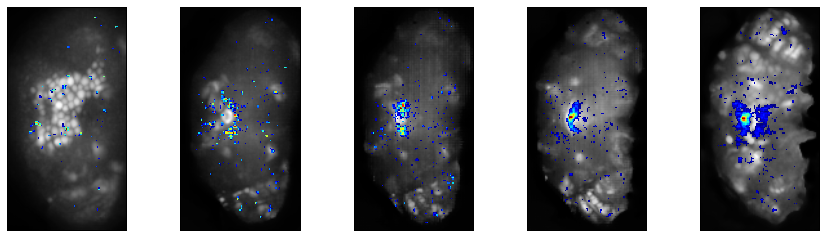

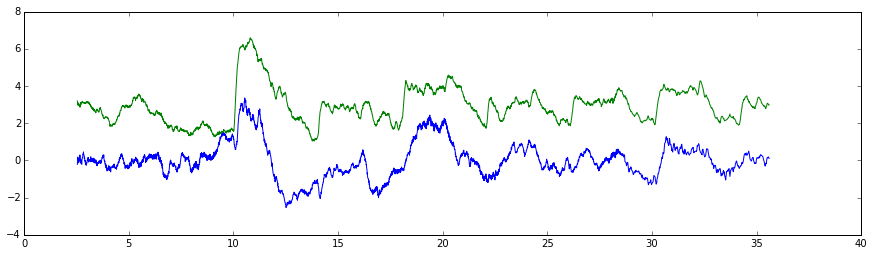

a


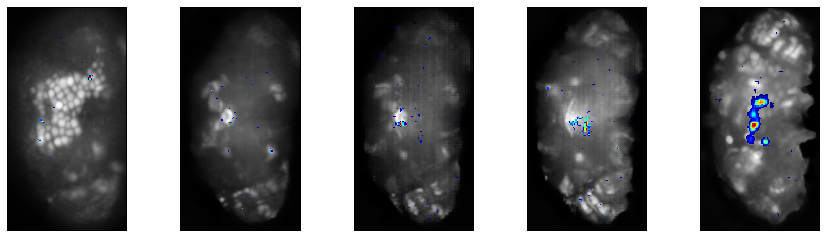

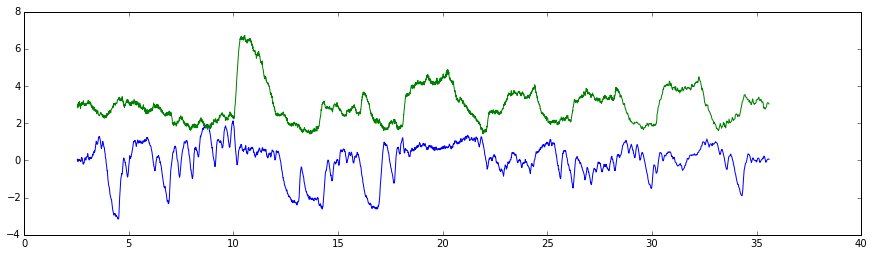

a


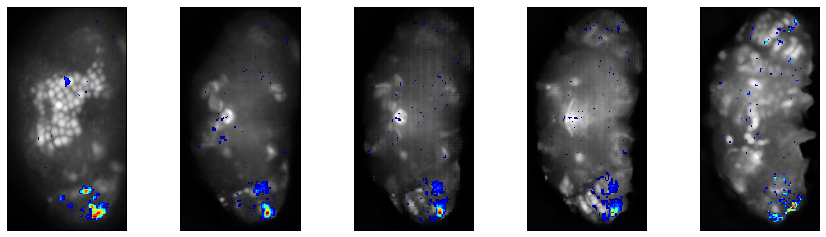

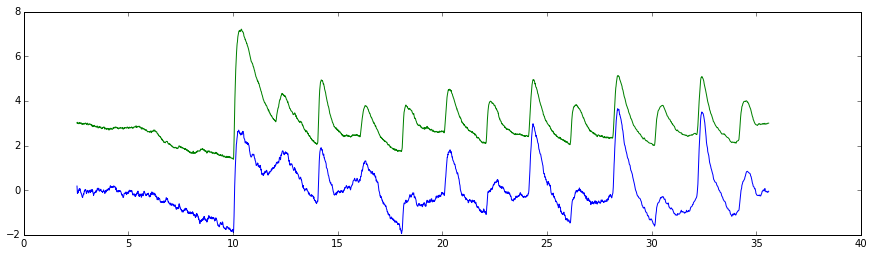

a


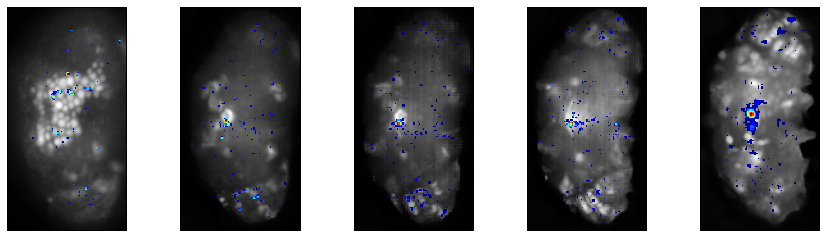

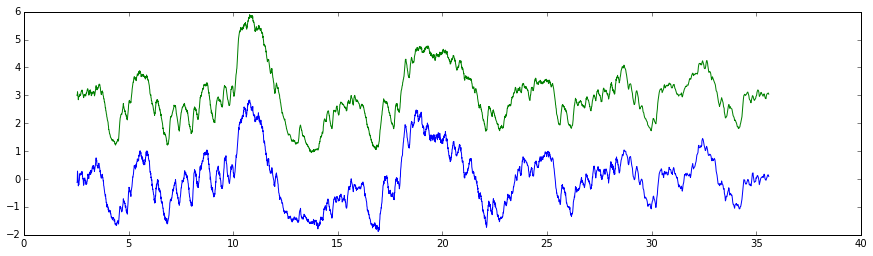

a


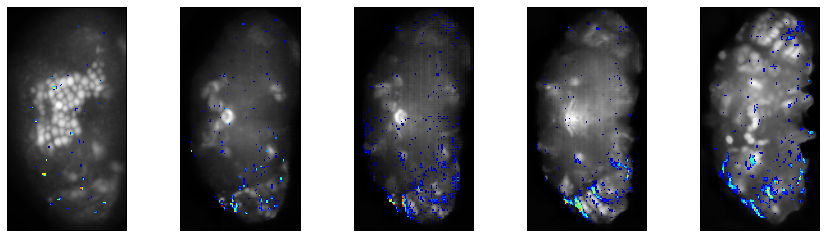

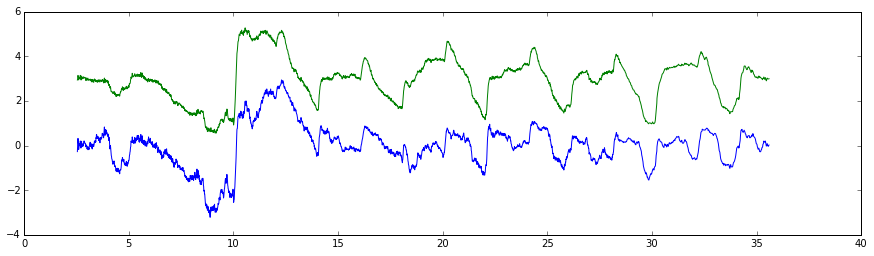

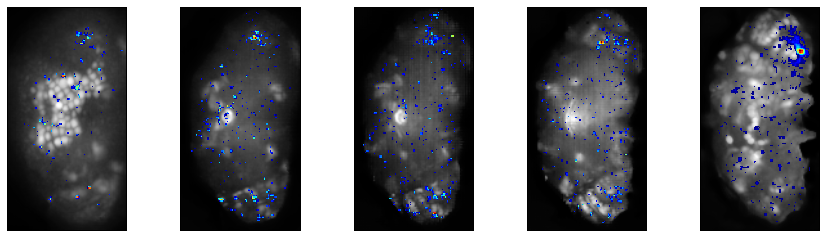

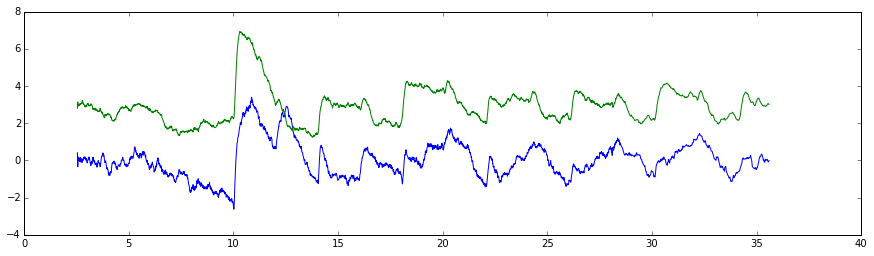

a


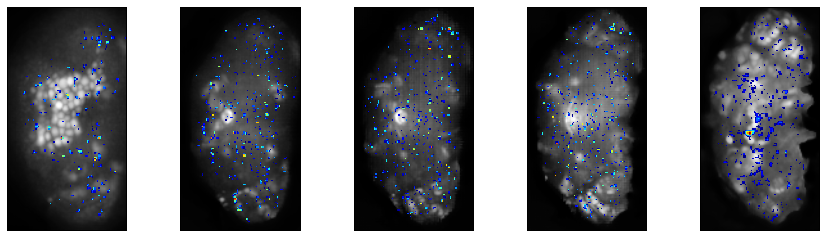

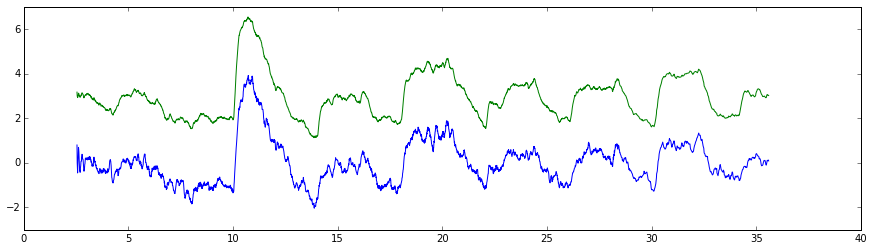

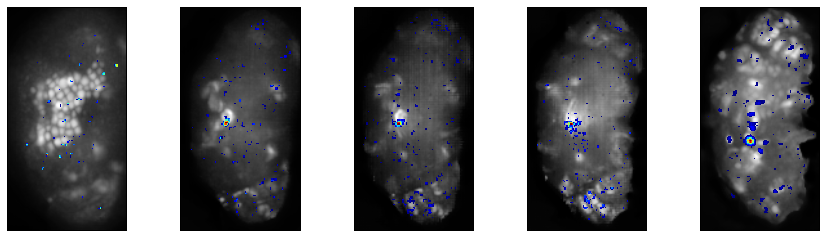

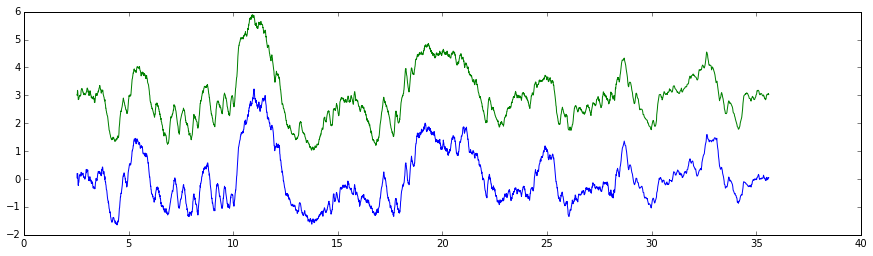

a


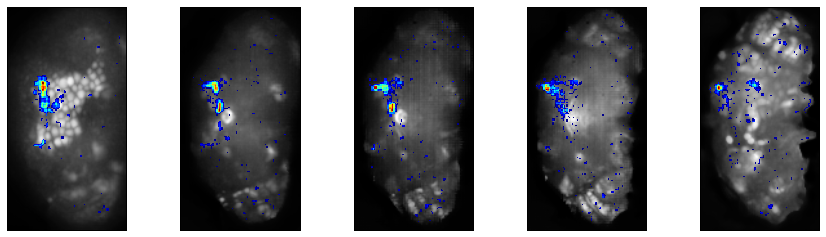

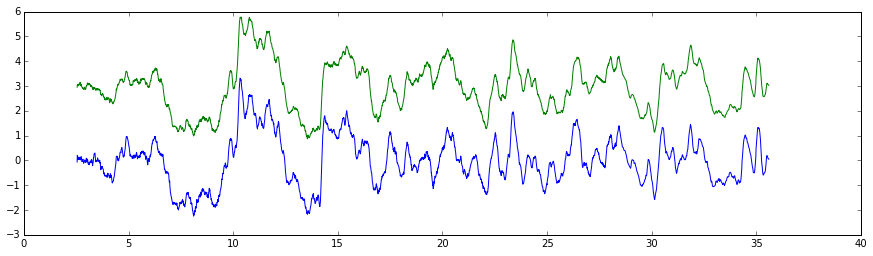

a


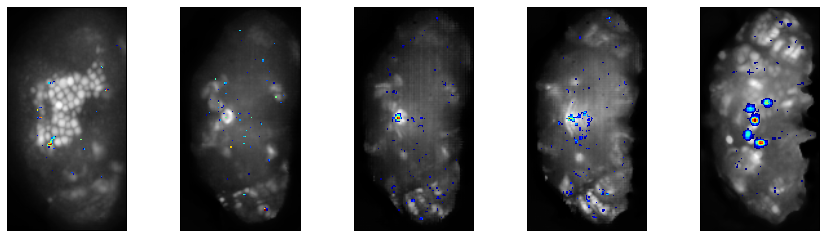

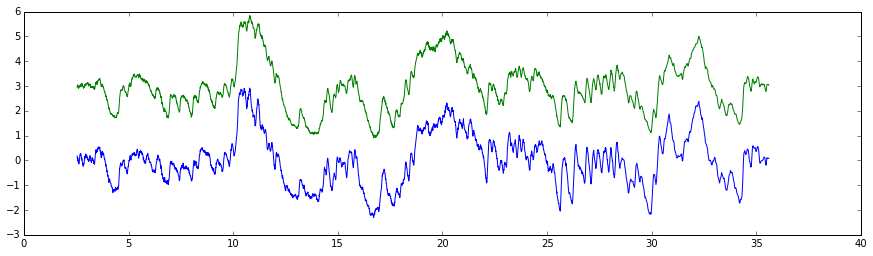

a


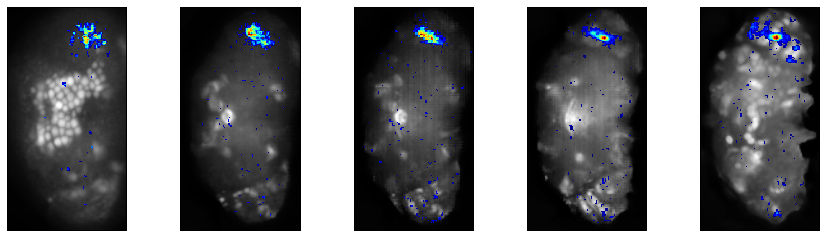

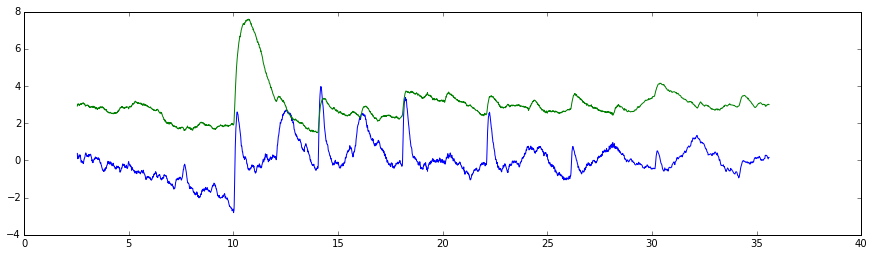

a


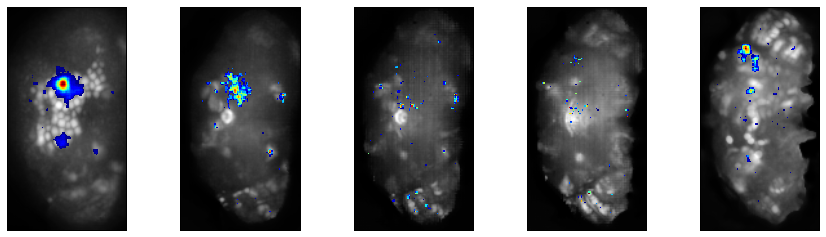

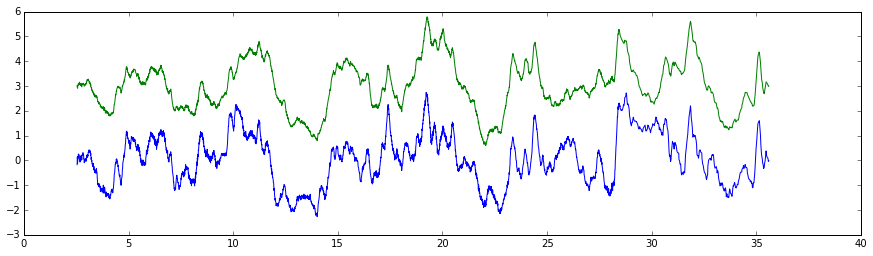

a


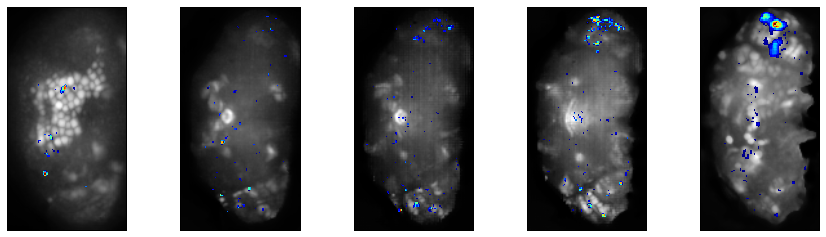

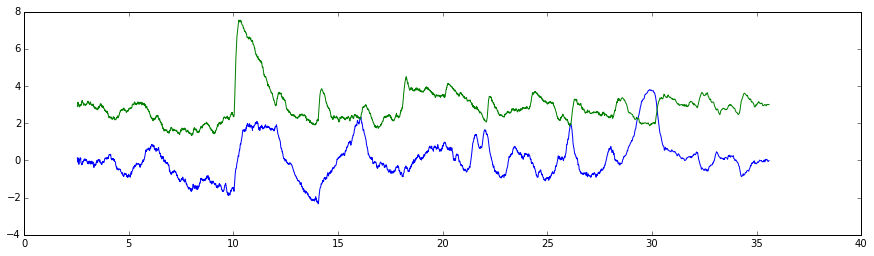

a


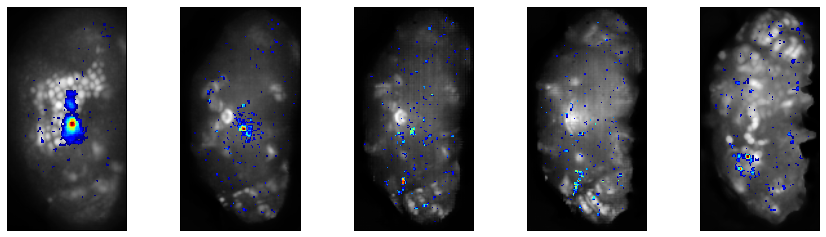

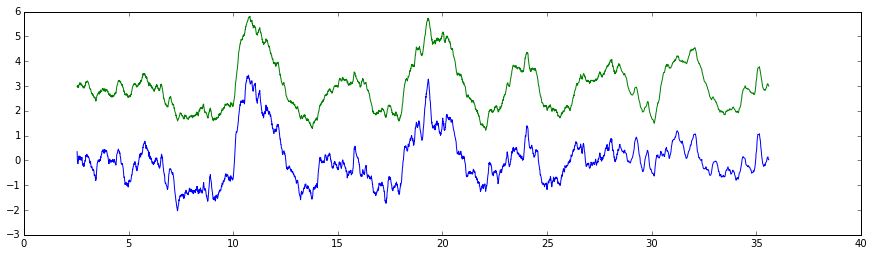

a


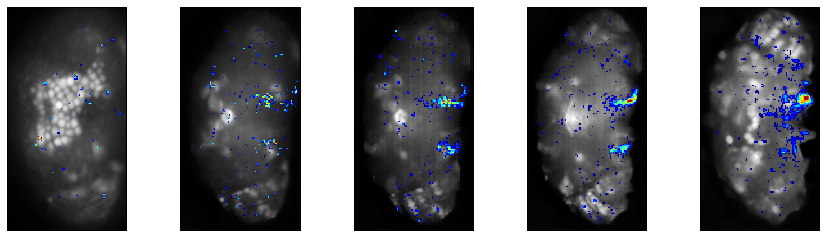

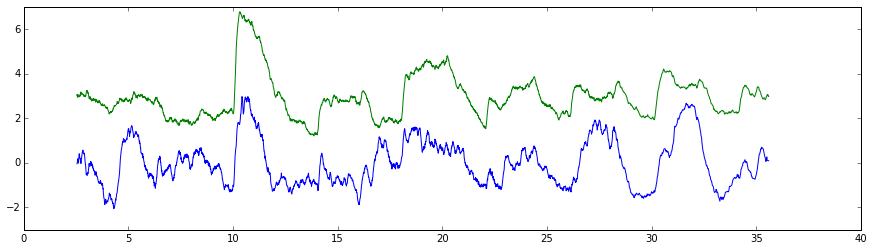

a


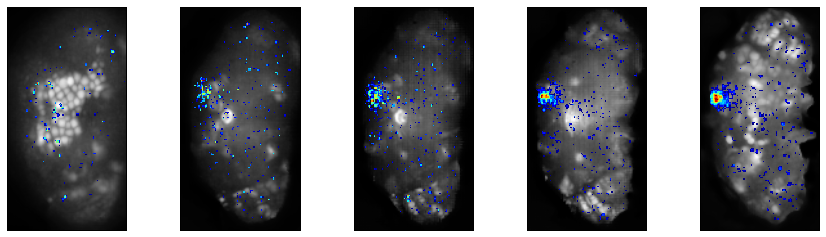

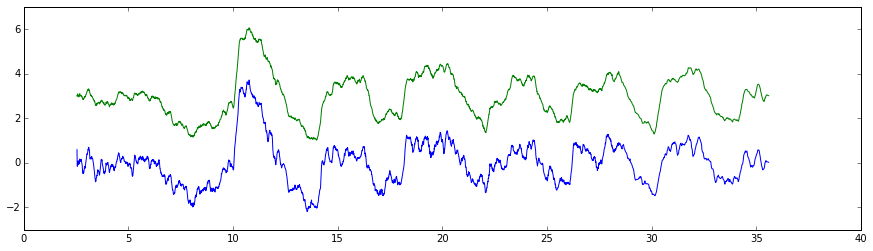

a


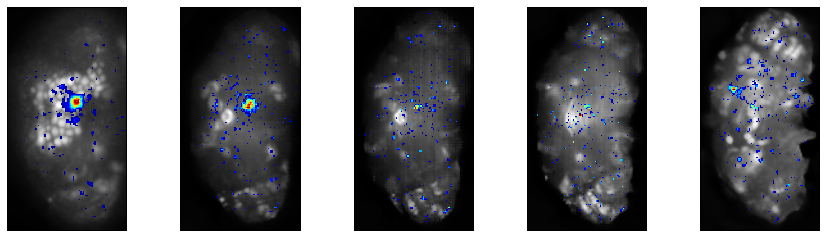

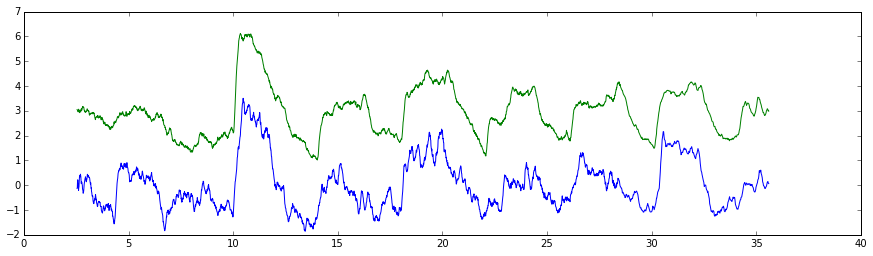

a


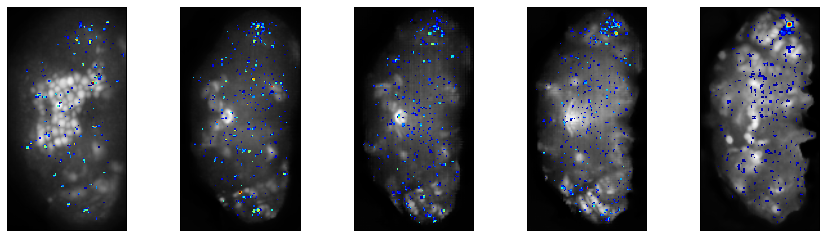

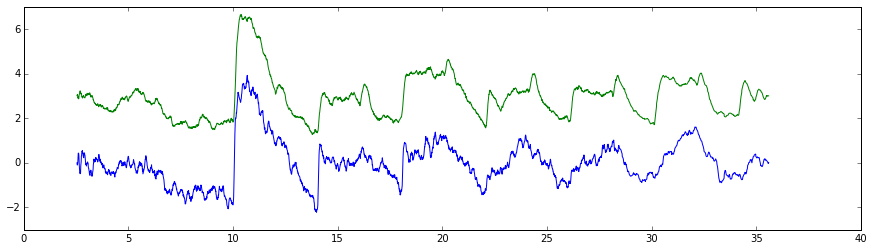

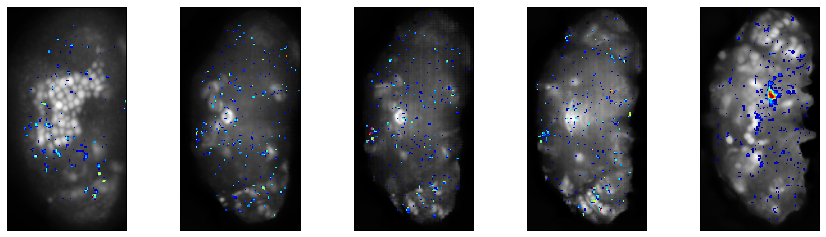

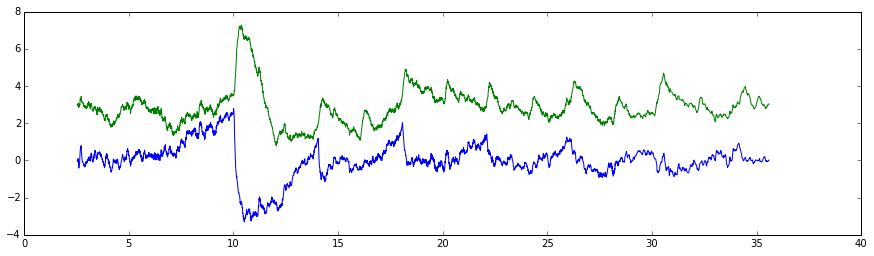

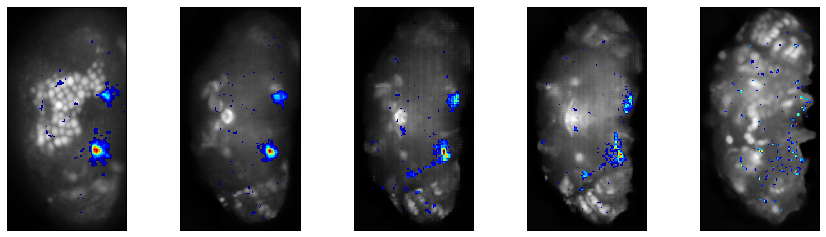

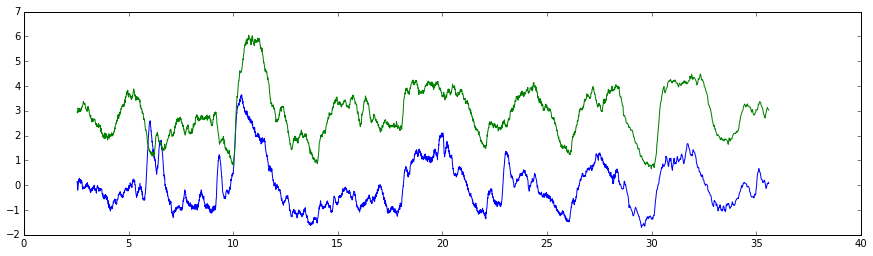

a


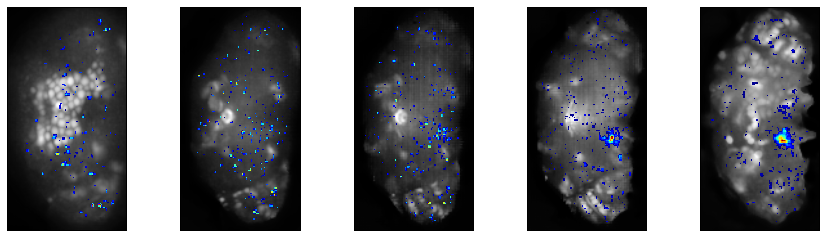

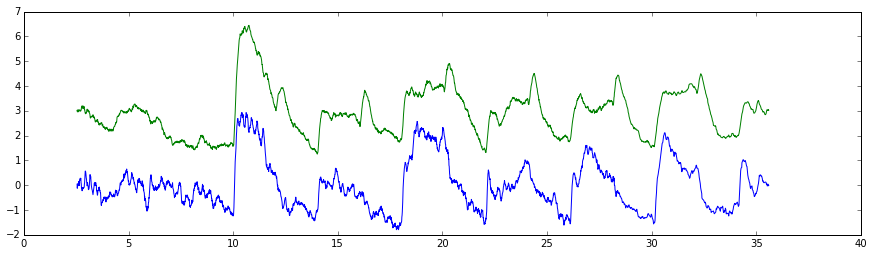

a


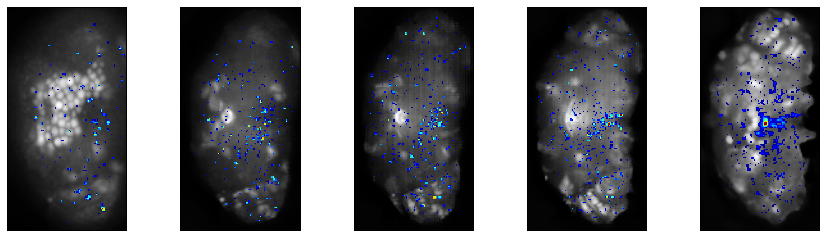

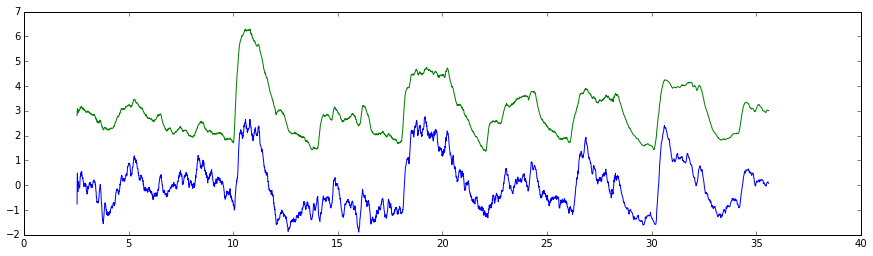

a


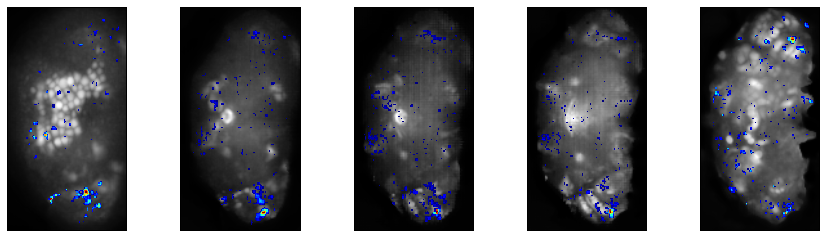

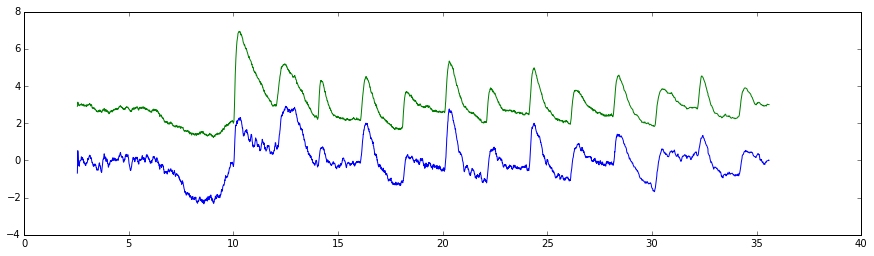

aa


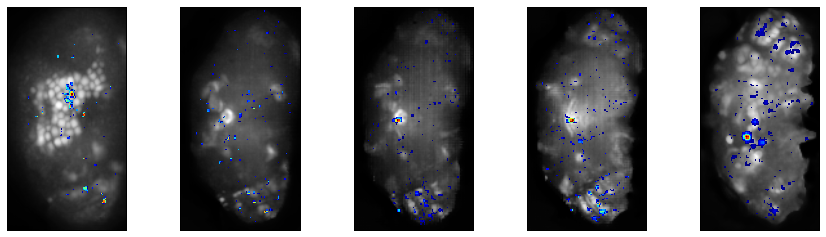

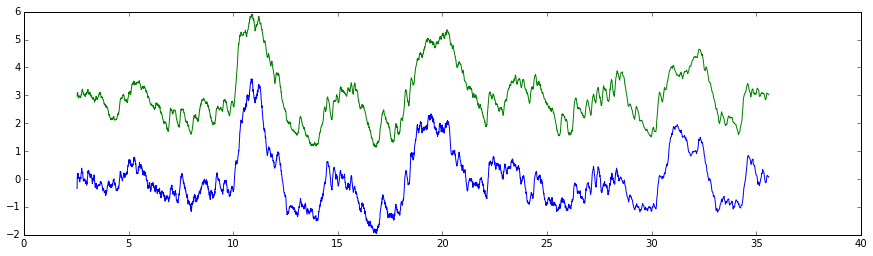

a


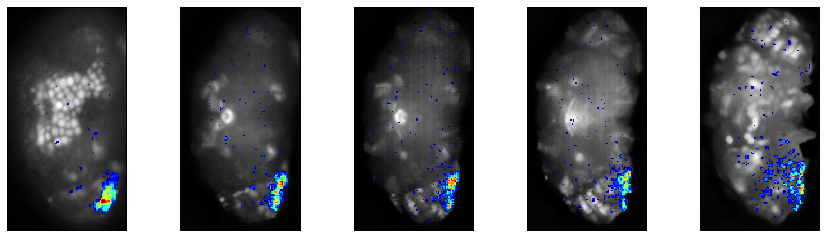

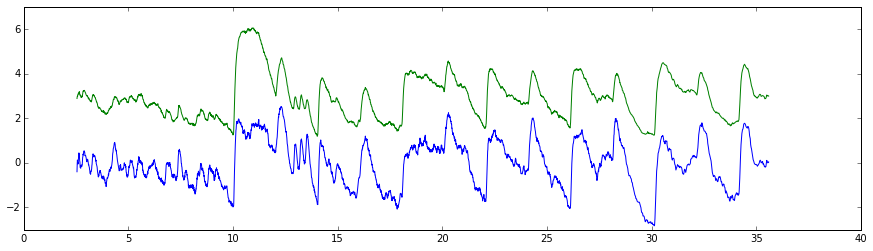

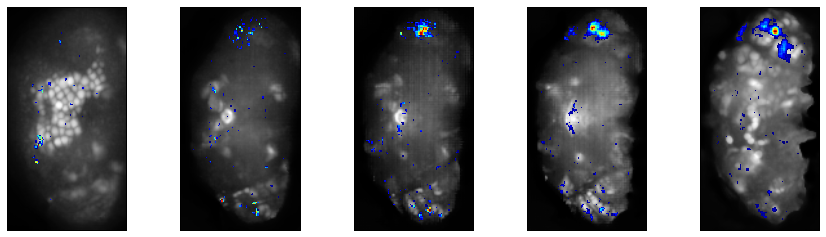

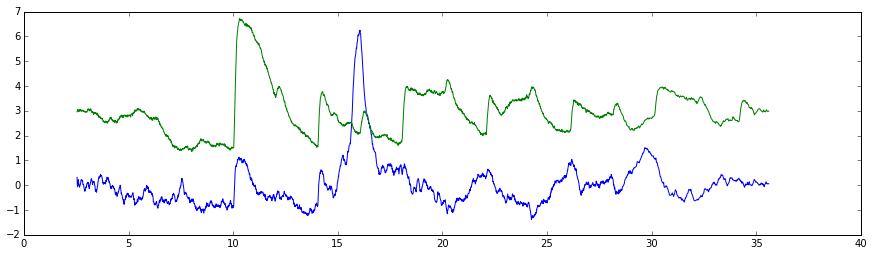

a


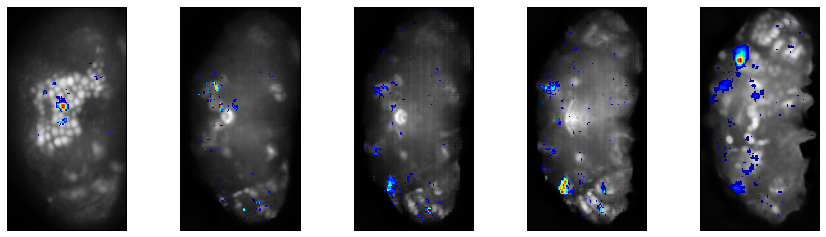

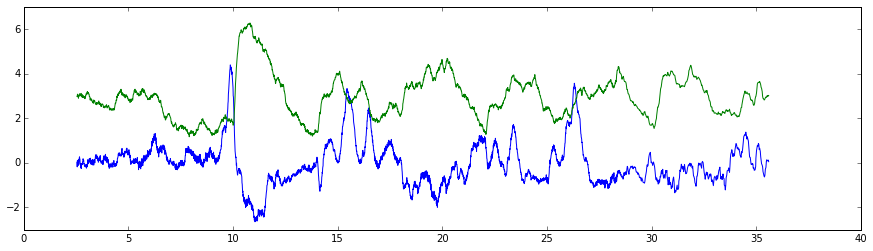

a


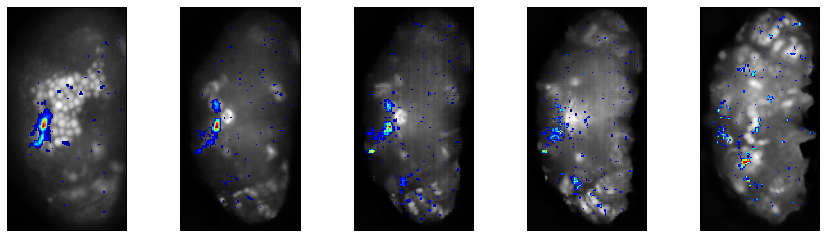

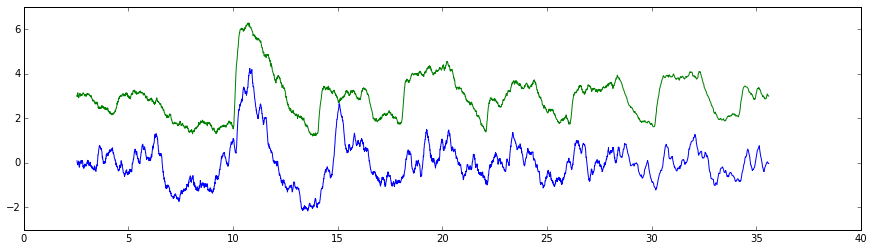

a


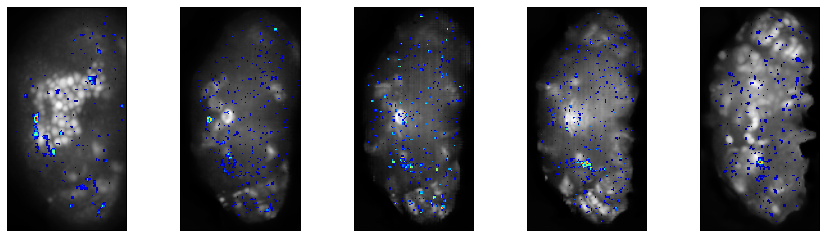

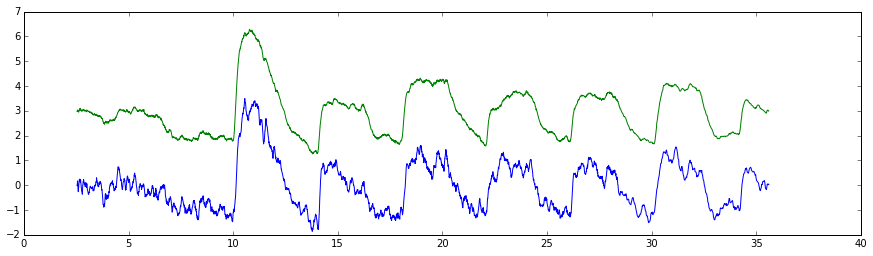

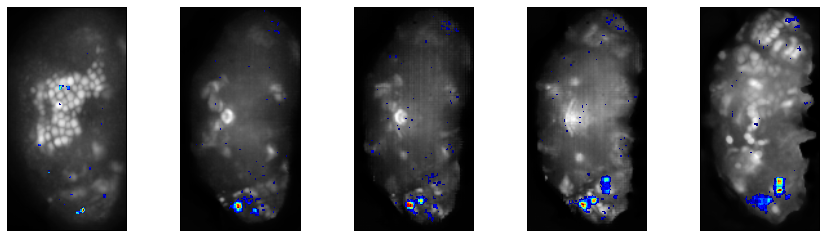

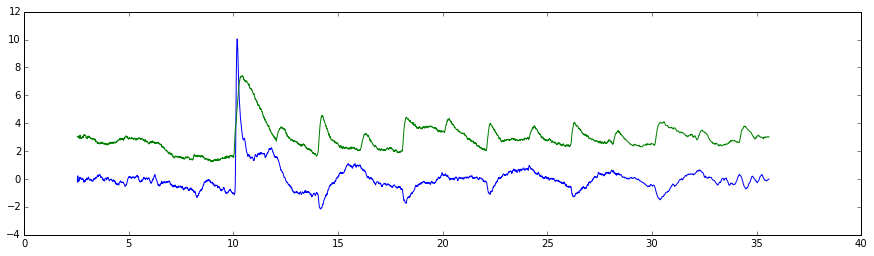

a


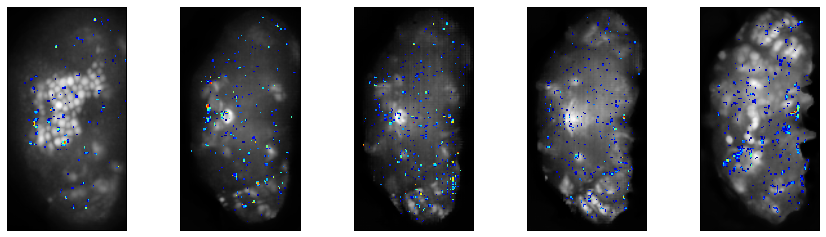

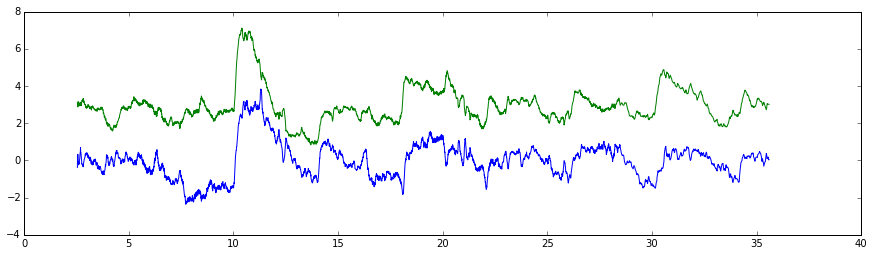

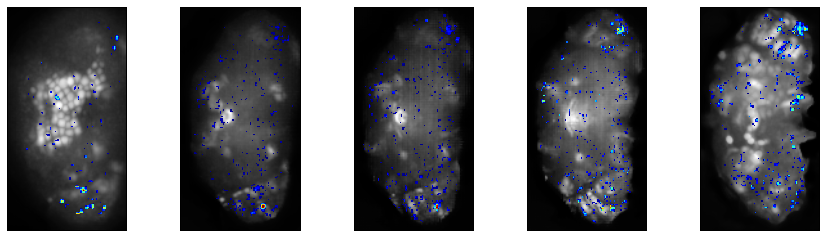

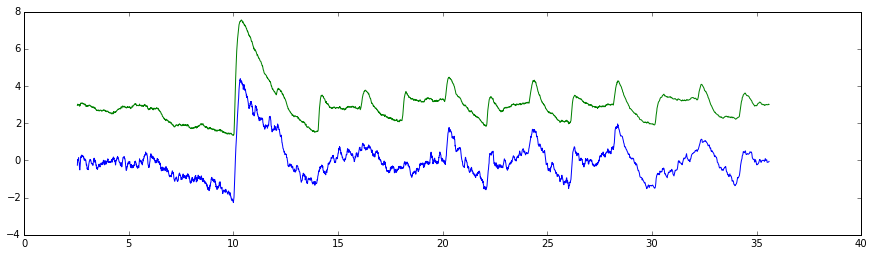

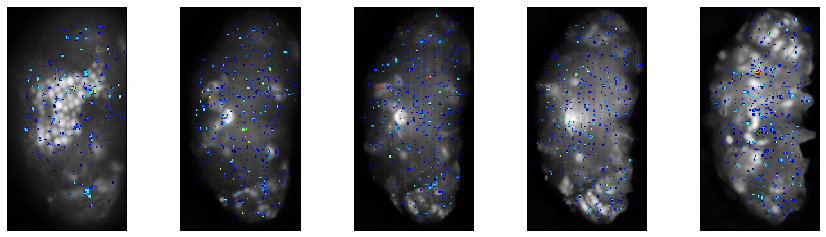

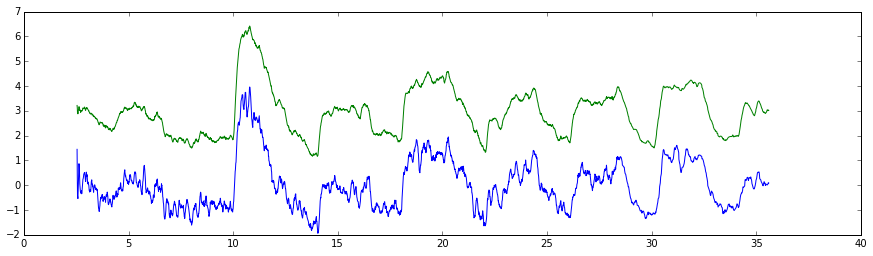

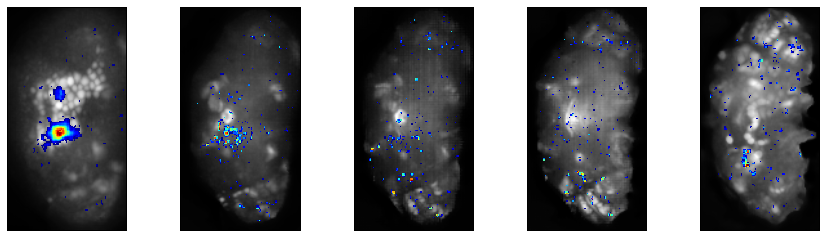

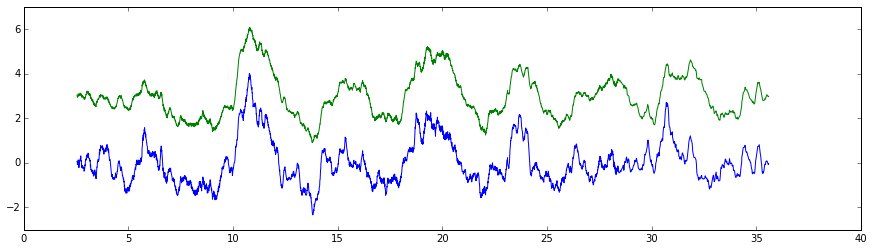

a


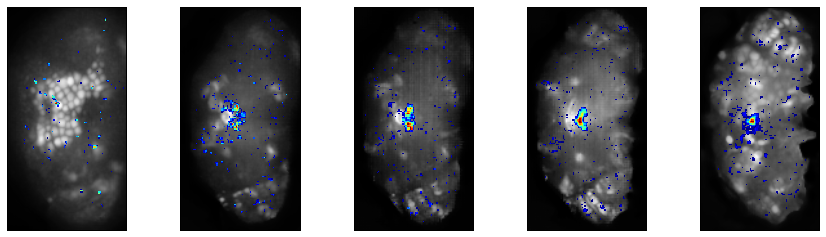

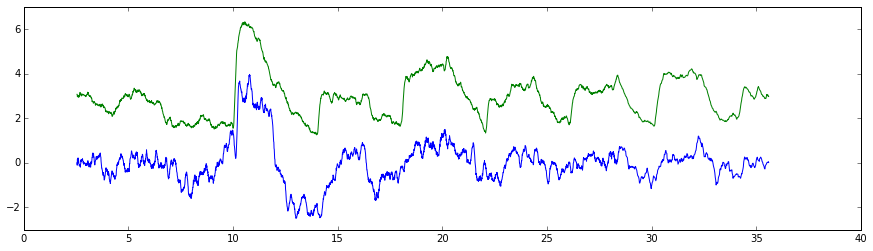

a


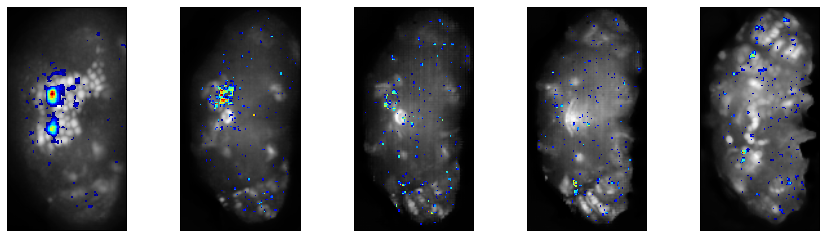

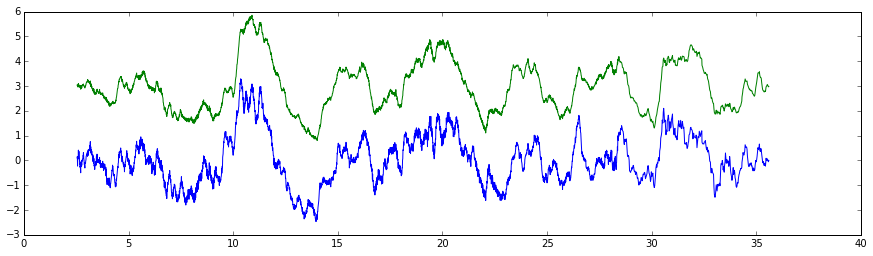

a


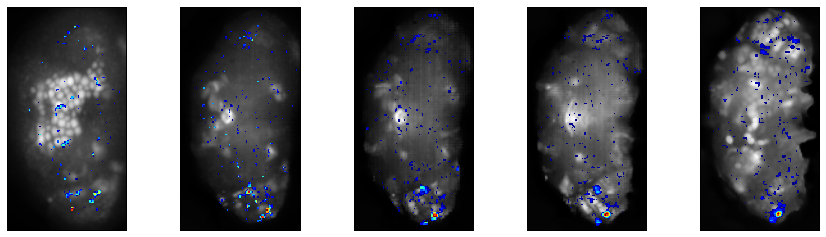

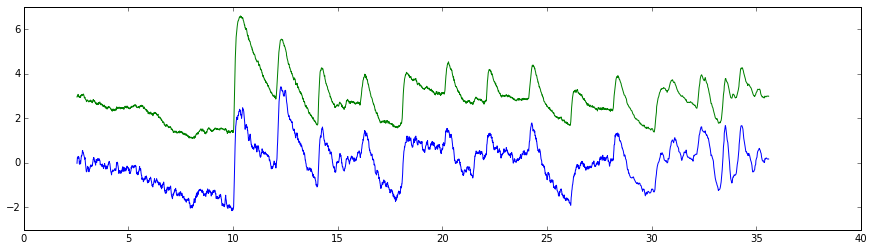

a


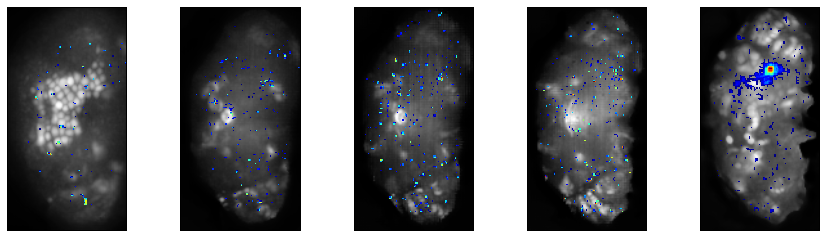

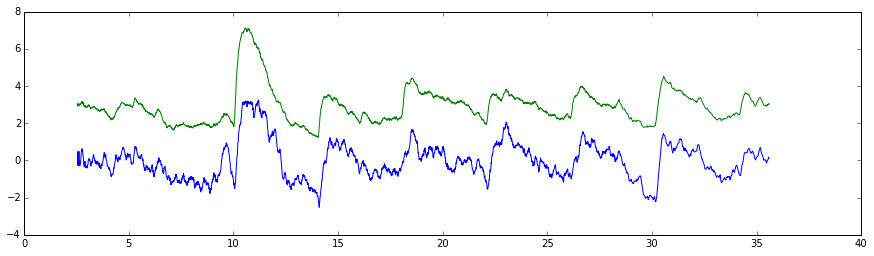

a


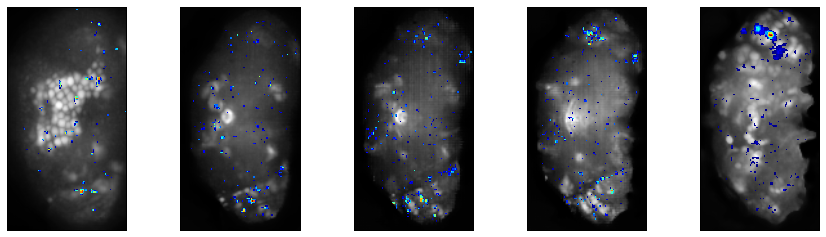

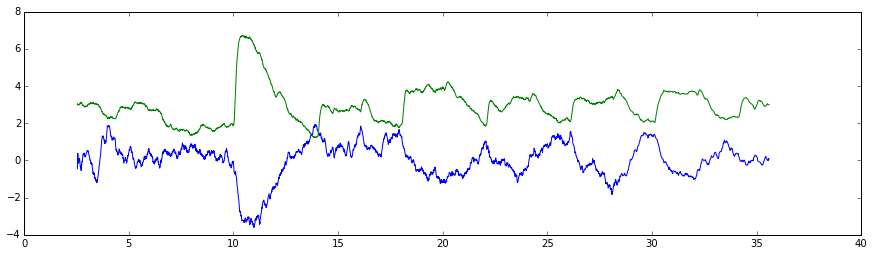

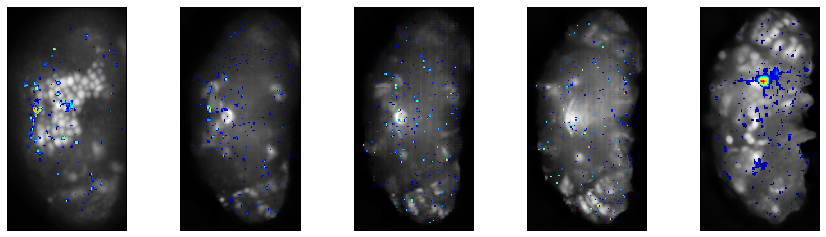

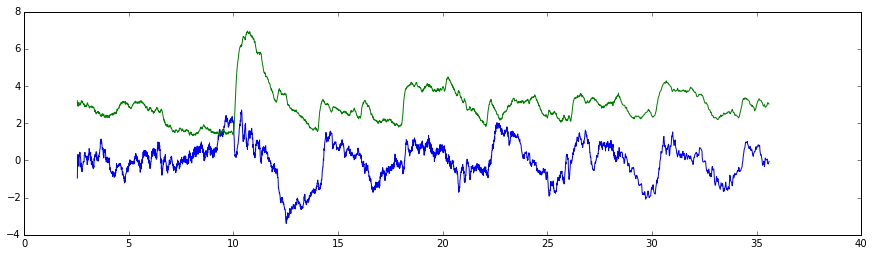

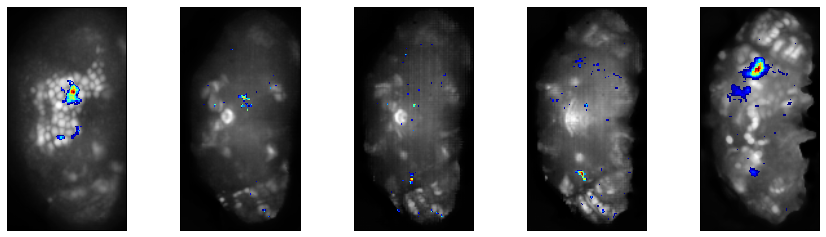

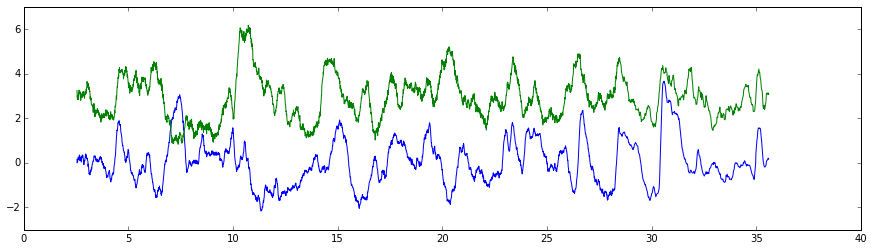

a


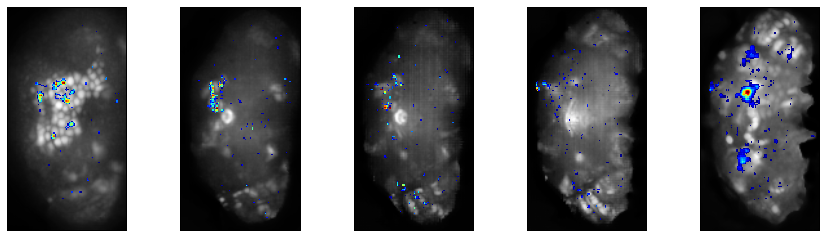

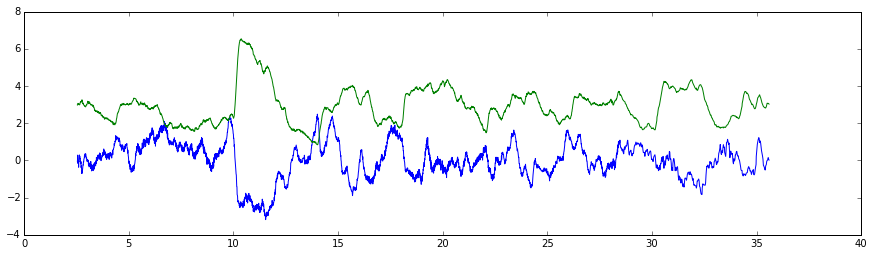

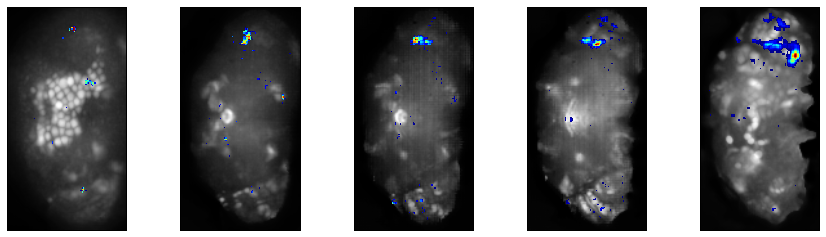

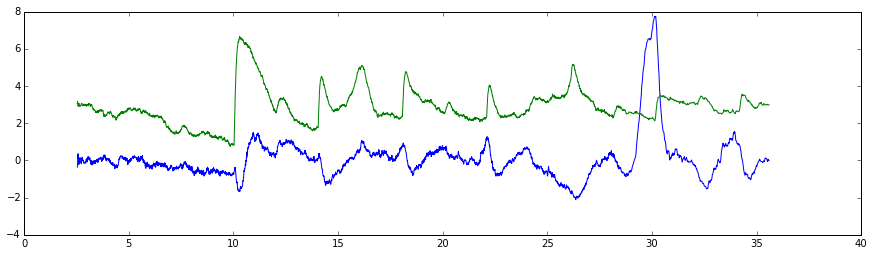

a


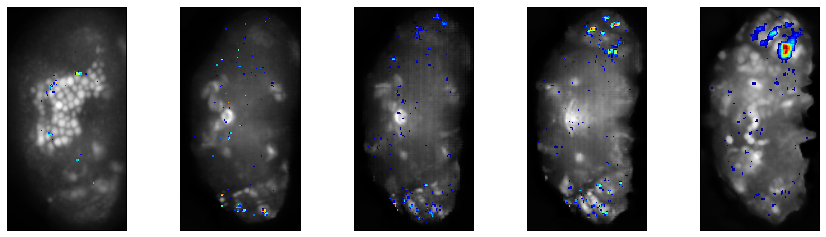

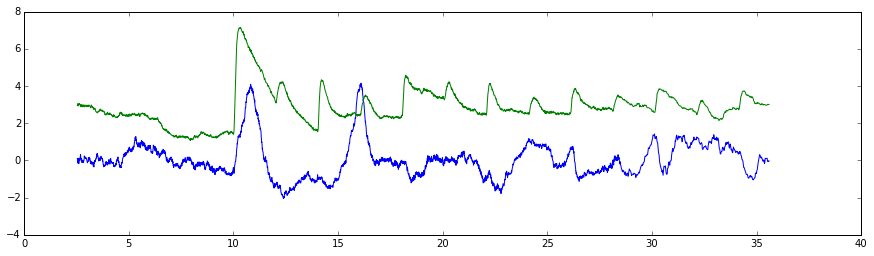

a


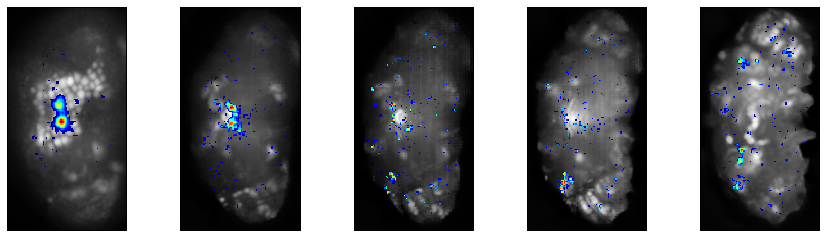

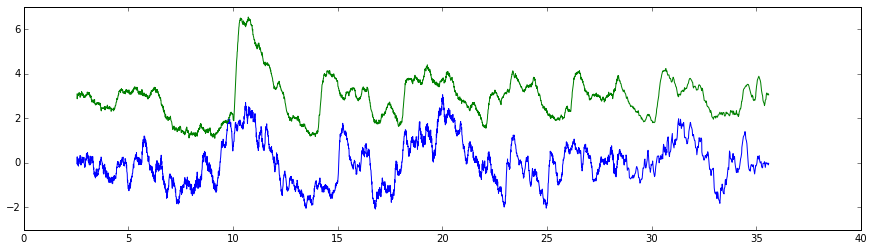

a


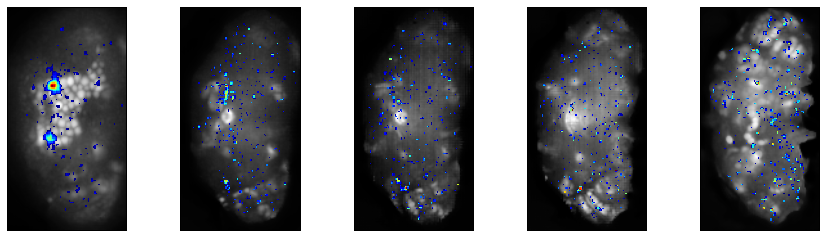

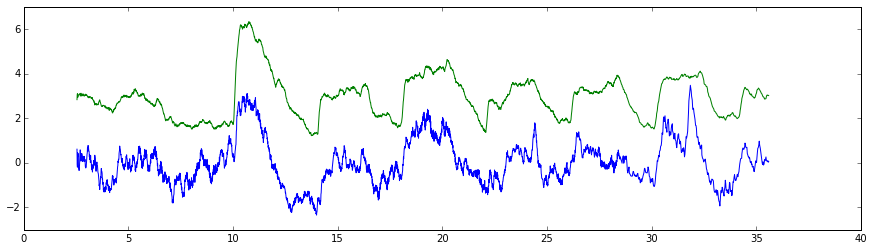

a


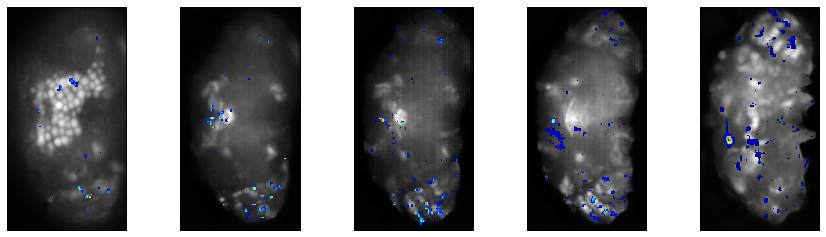

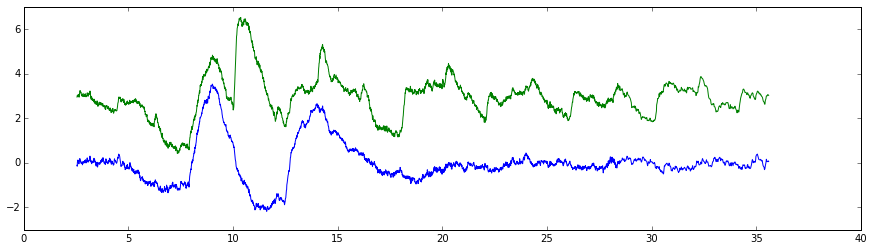

a


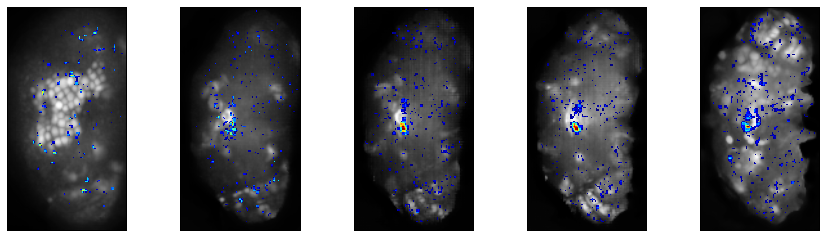

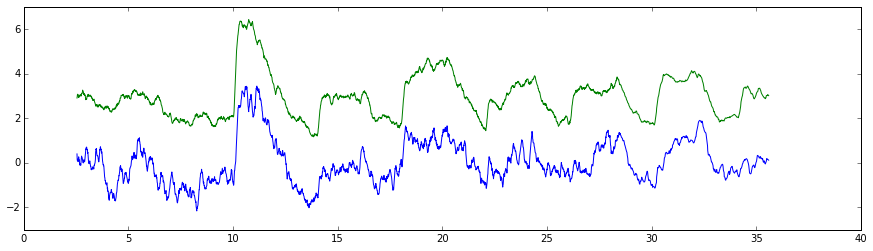

a


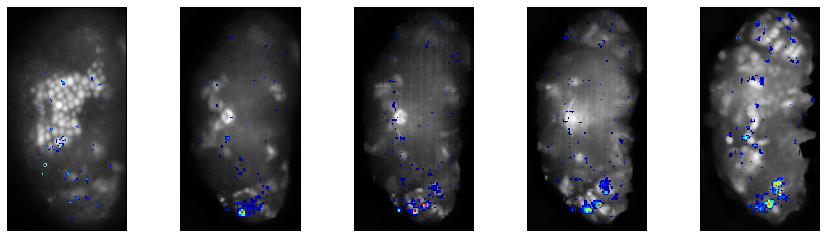

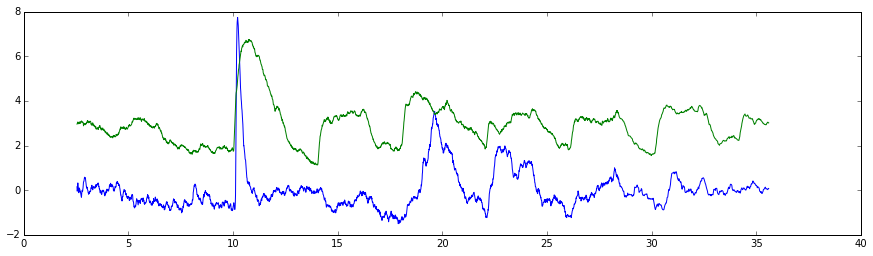

a


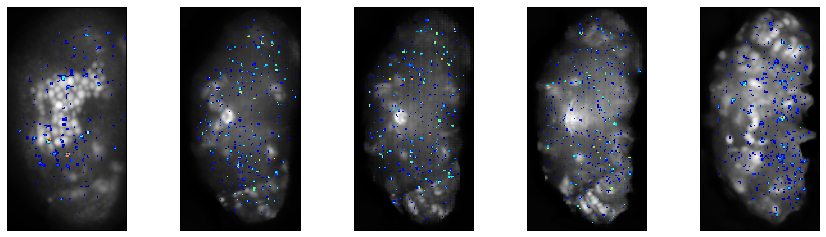

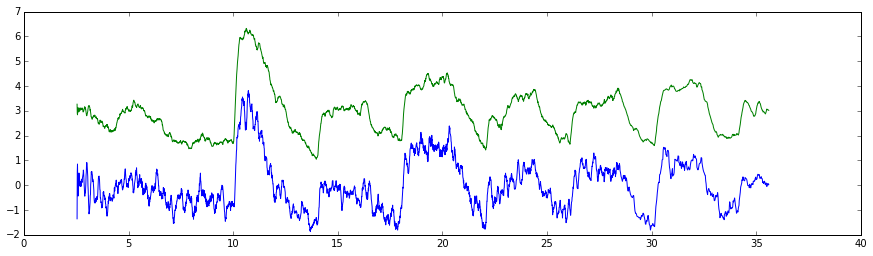

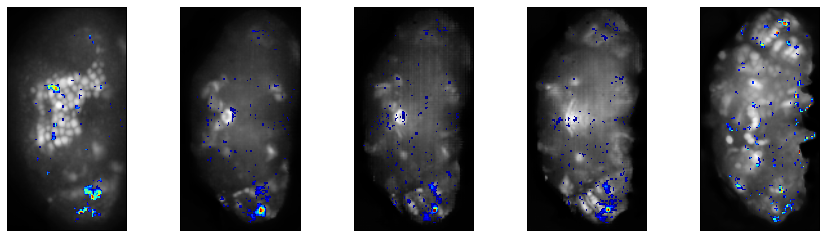

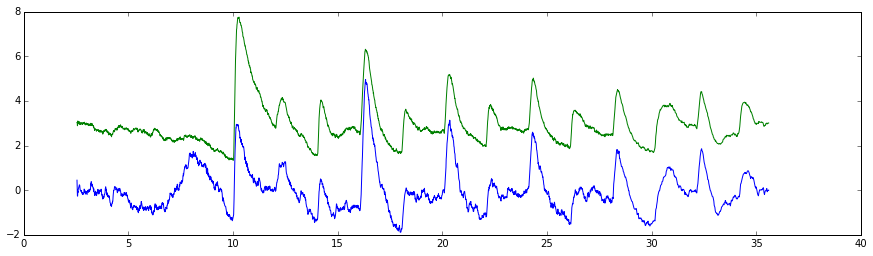

a


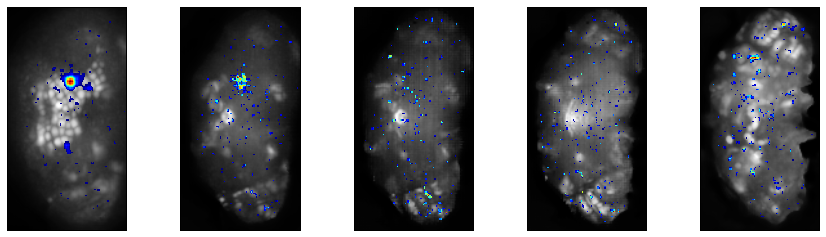

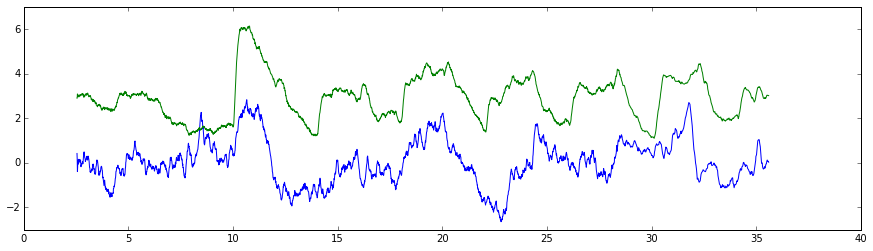

a


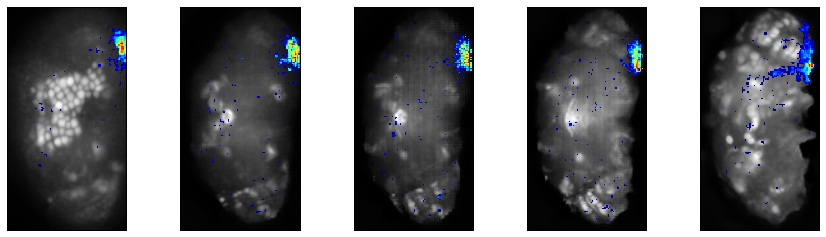

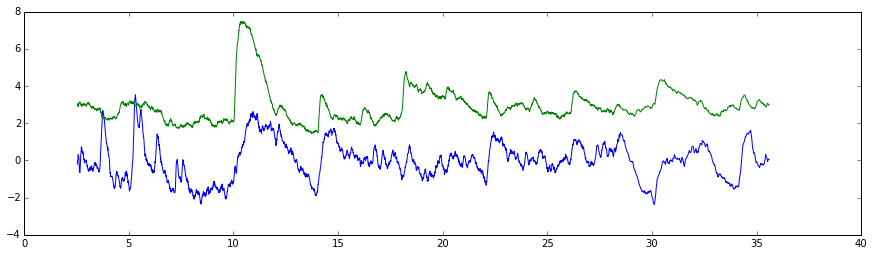

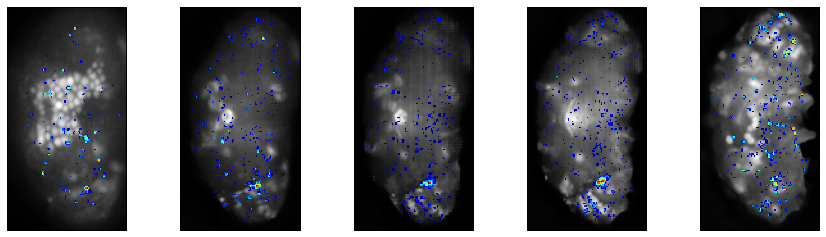

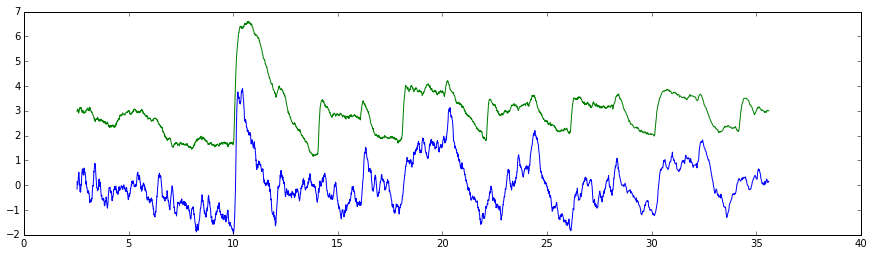

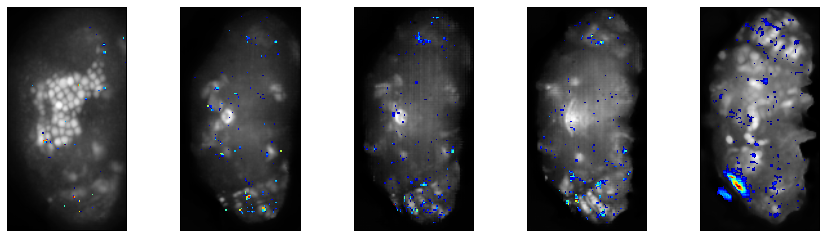

...

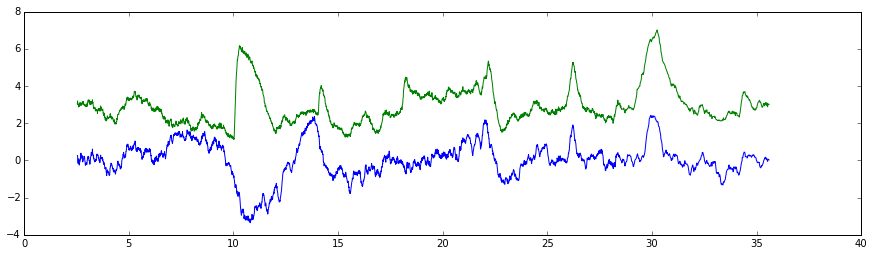

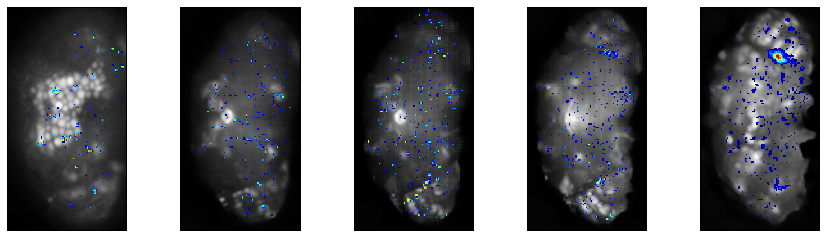

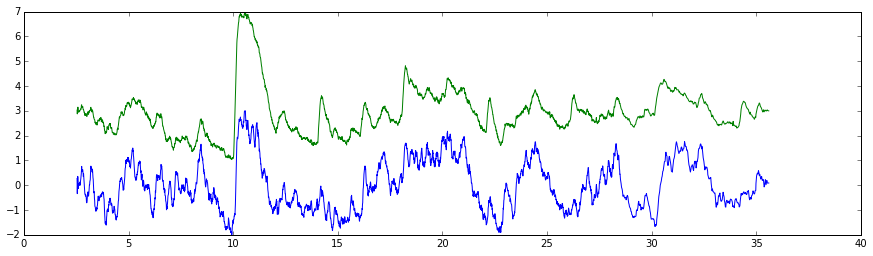

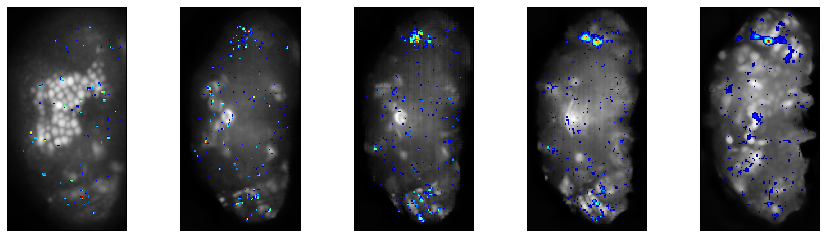

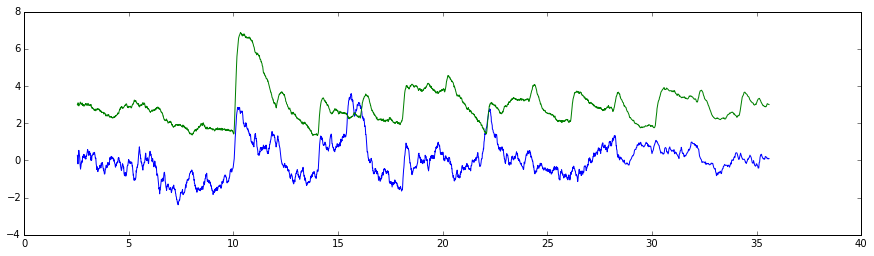

a


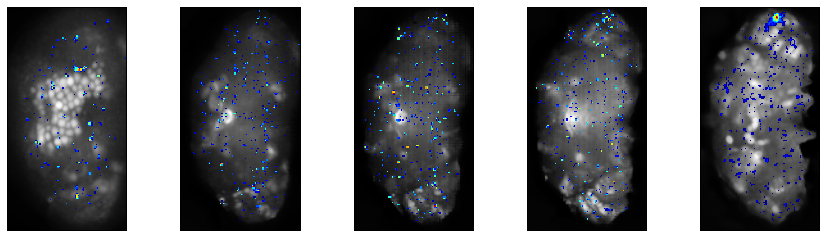

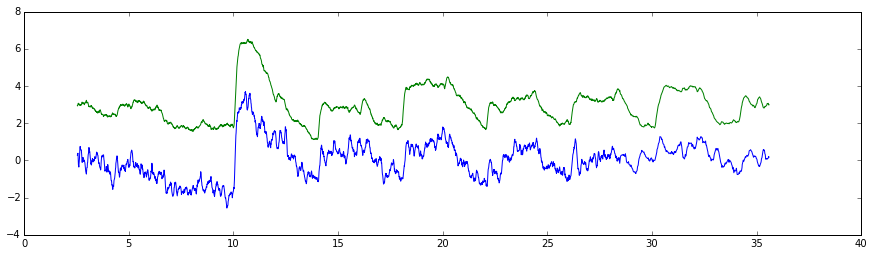

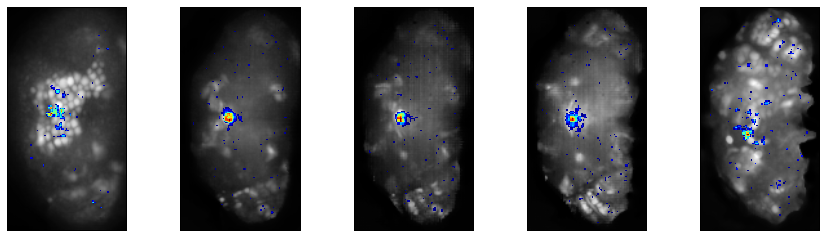

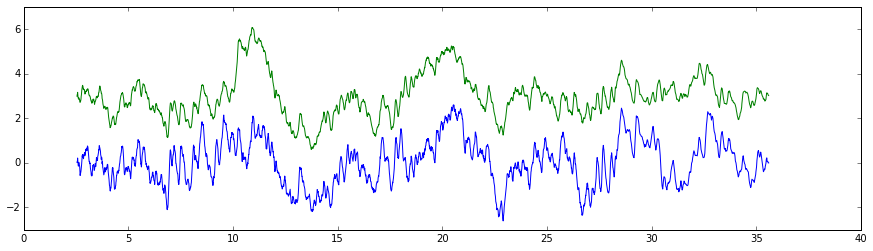

a


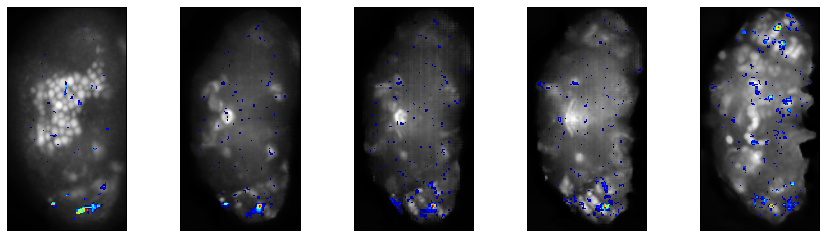

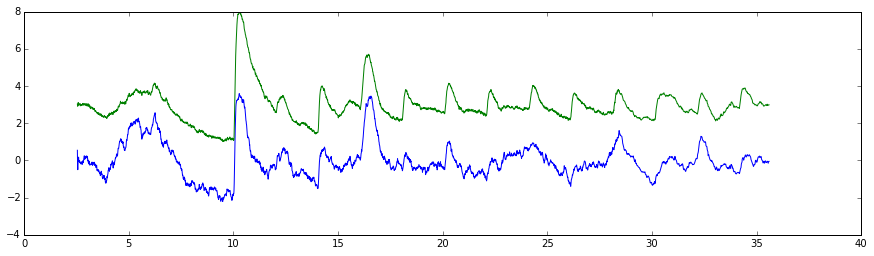

a


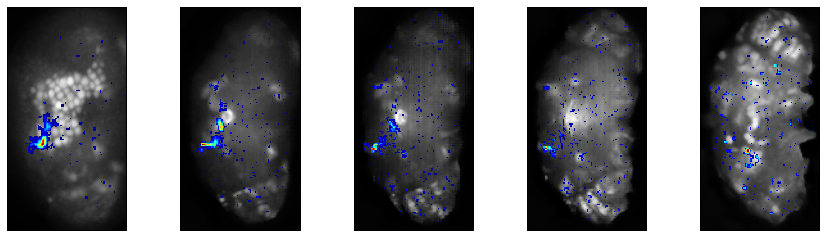

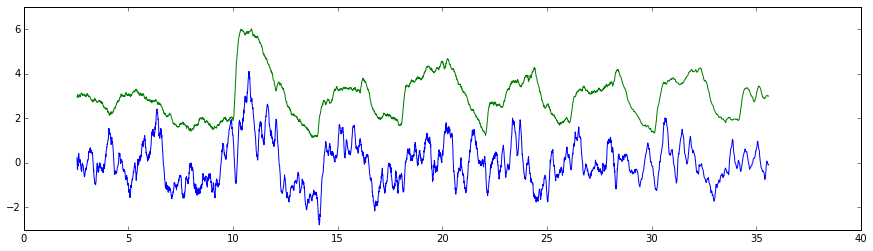

a


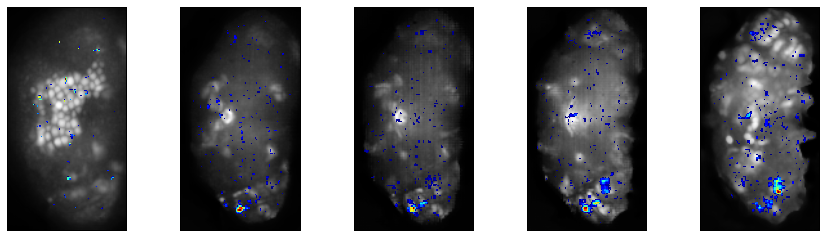

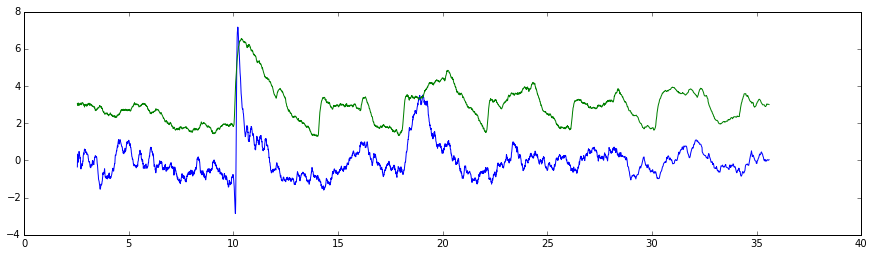

a


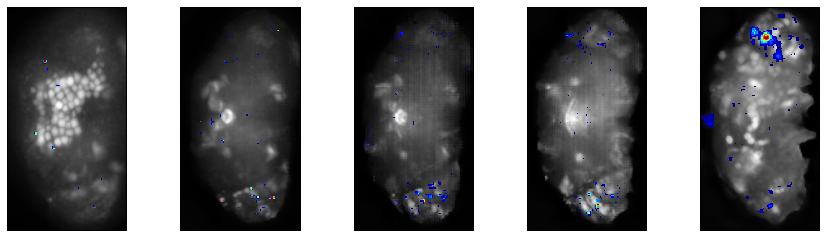

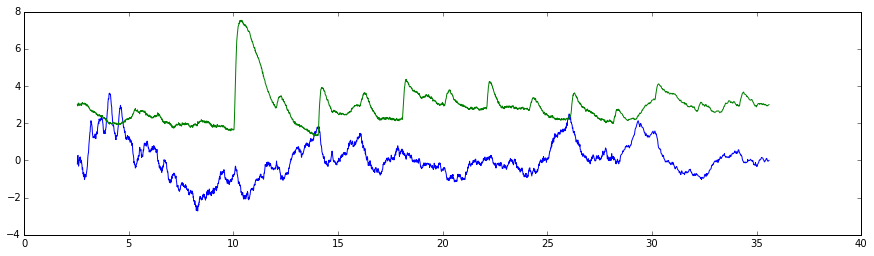

a


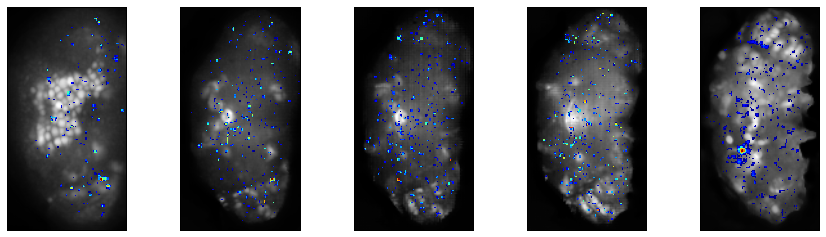

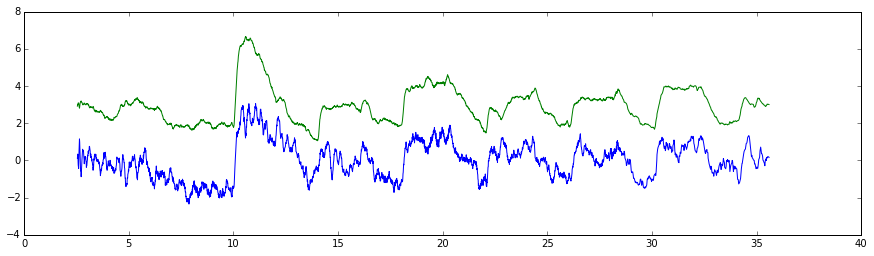

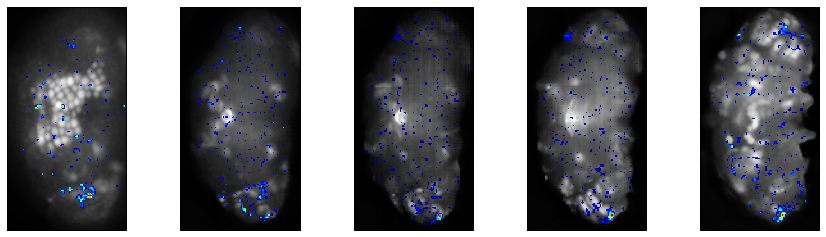

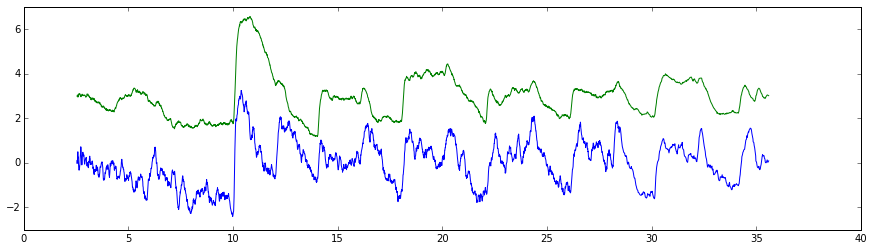

a


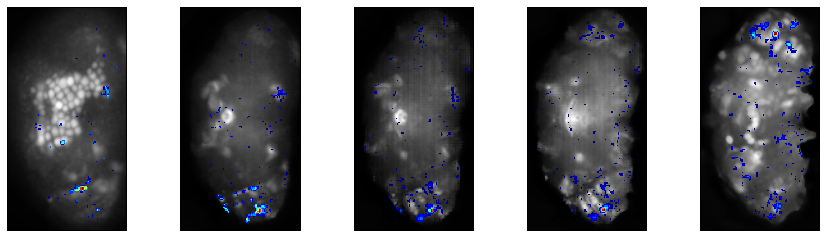

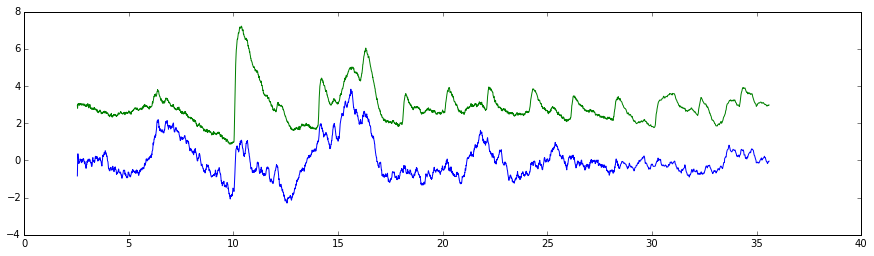

a


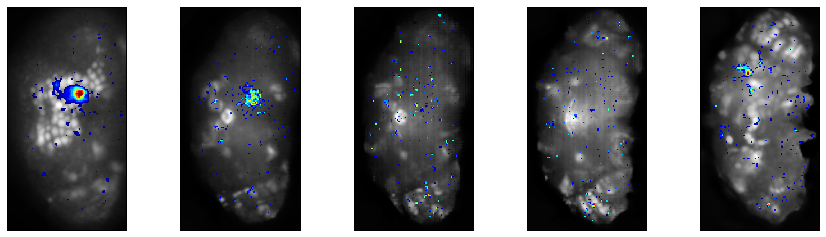

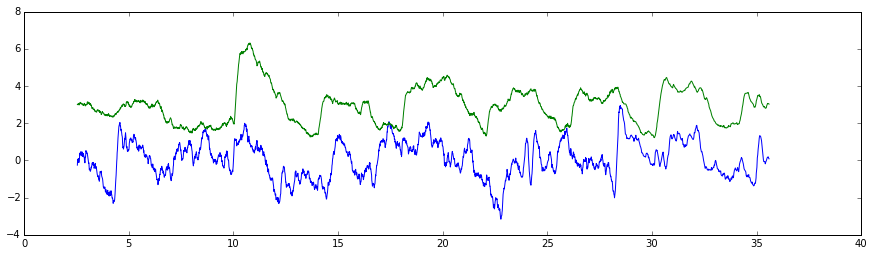

a


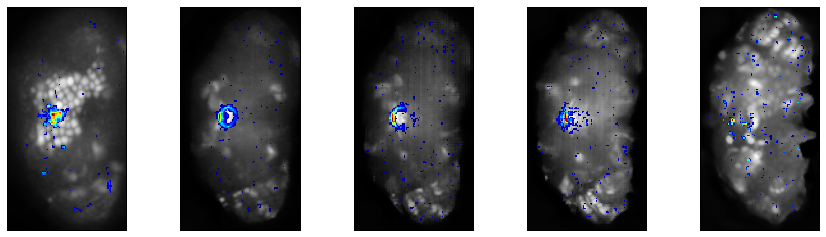

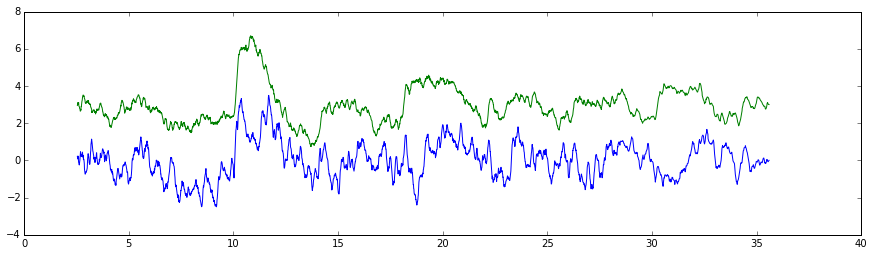

a


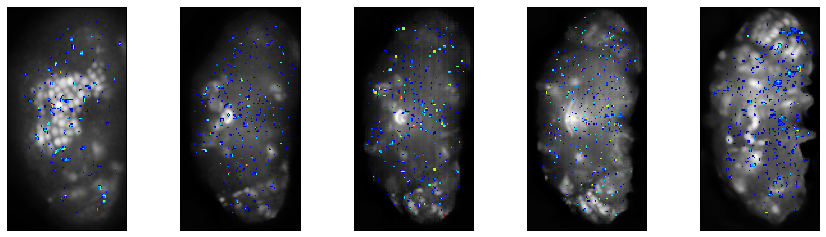

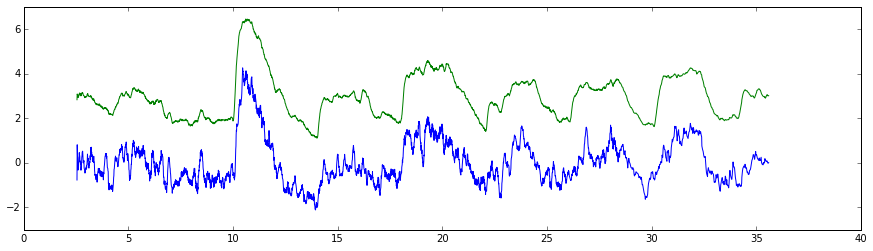

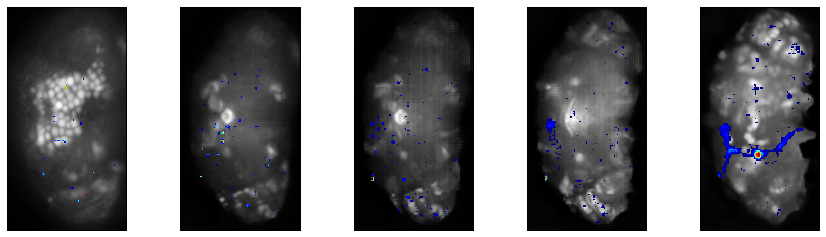

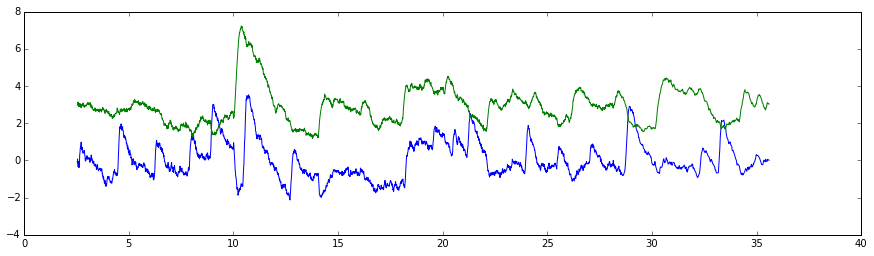

a


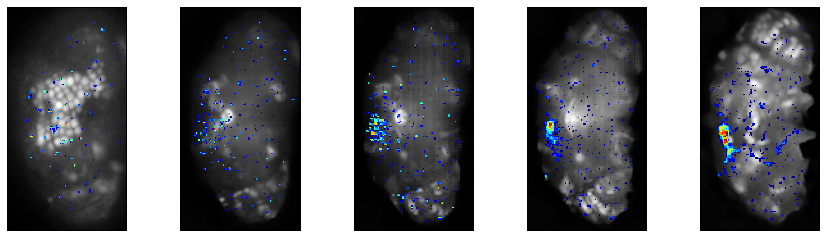

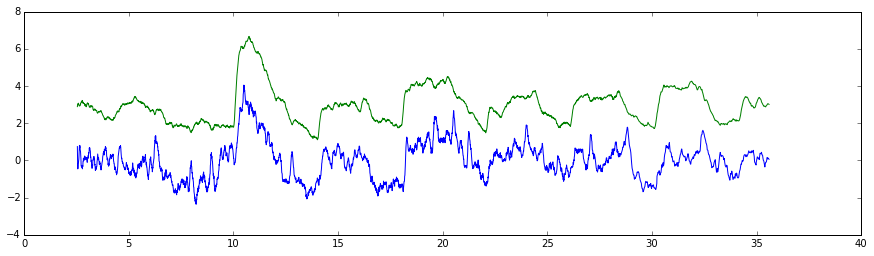

a


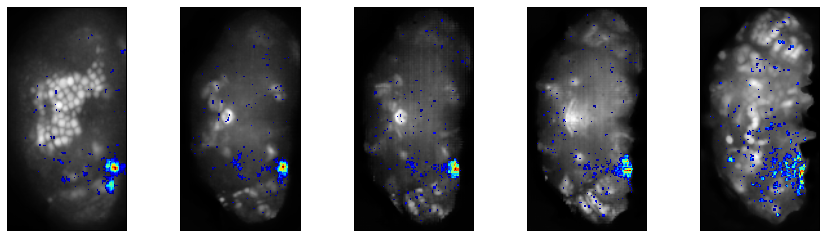

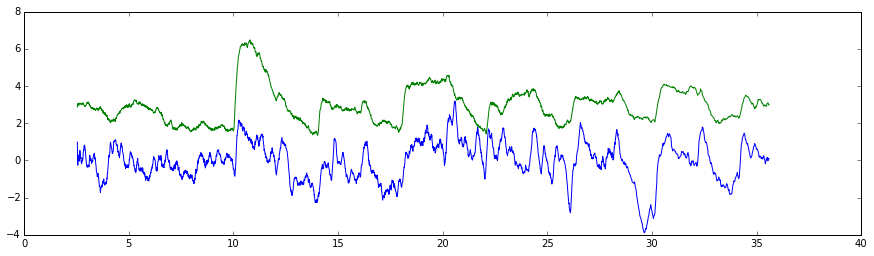

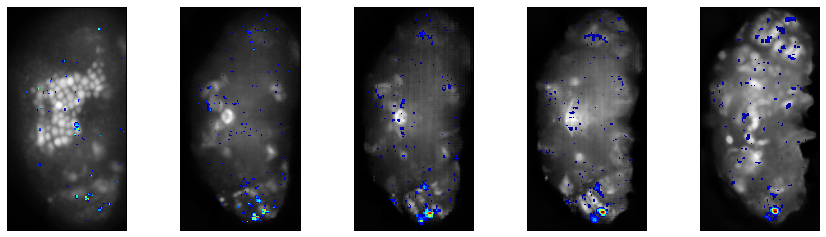

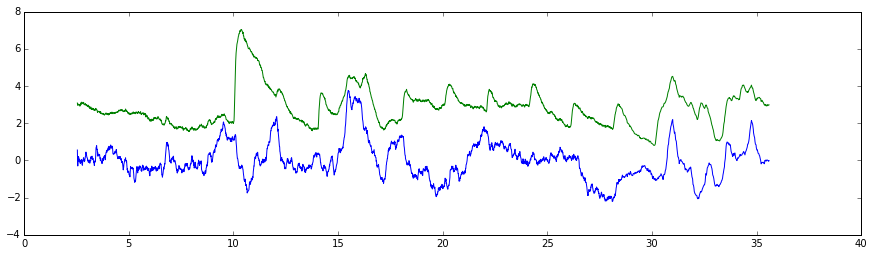

a


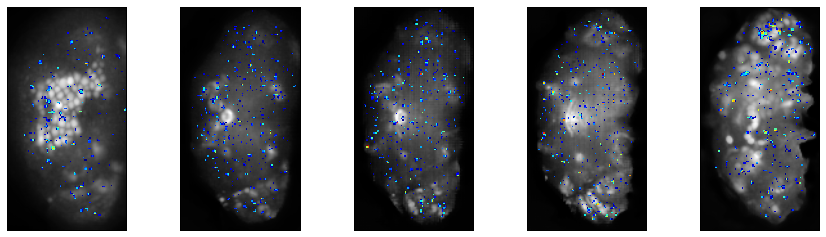

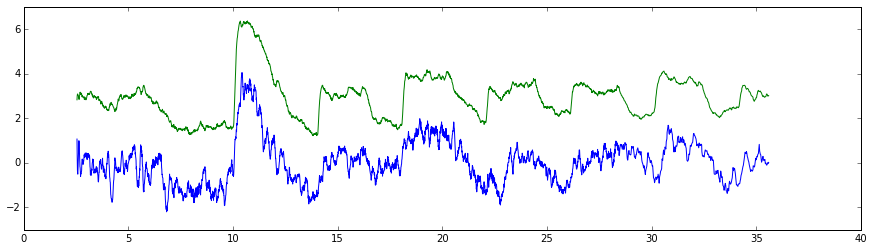

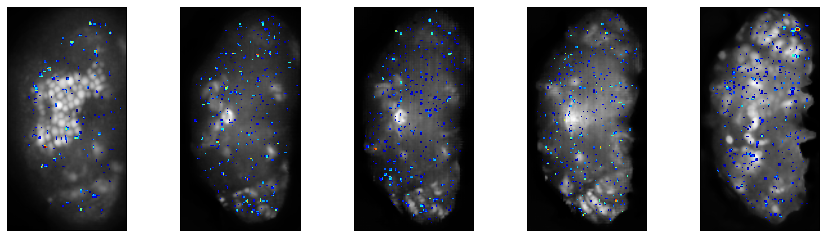

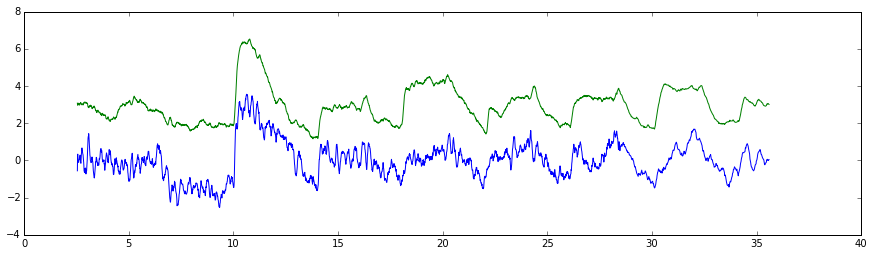

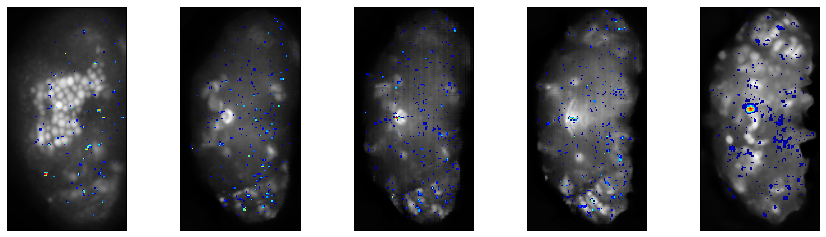

...

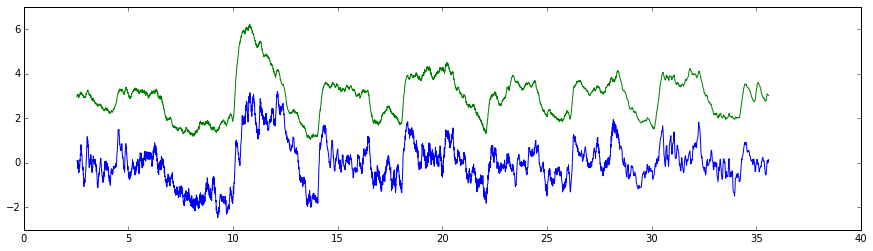

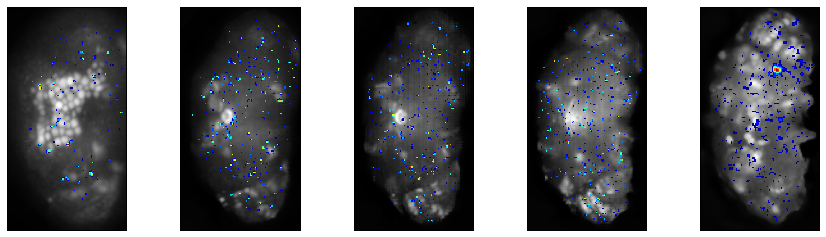

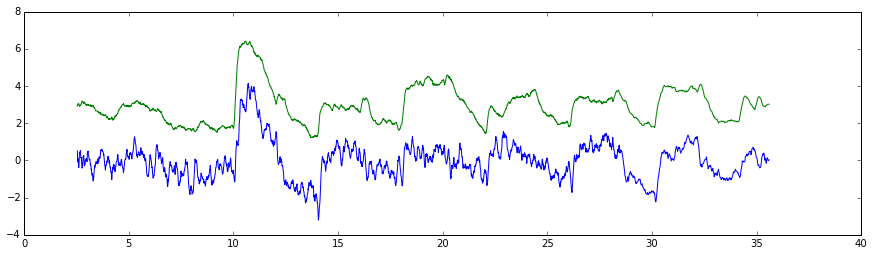

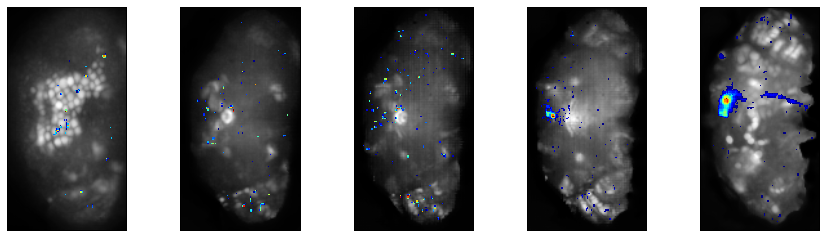

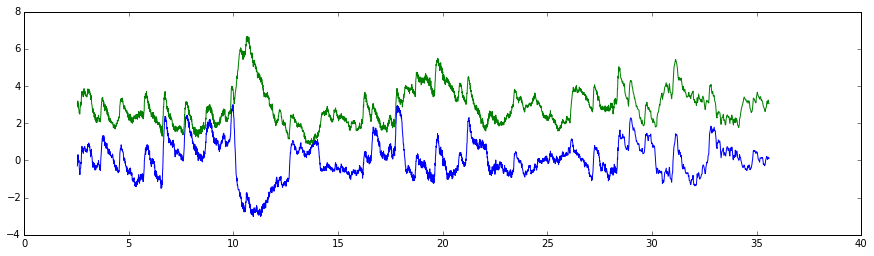

a


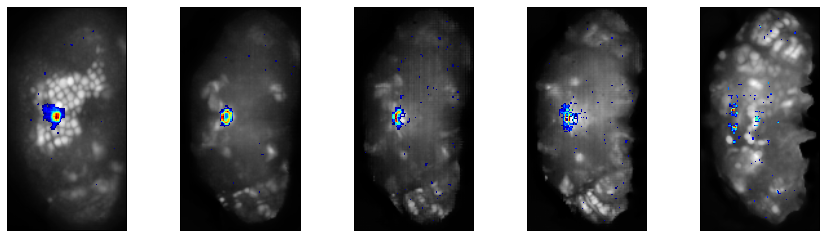

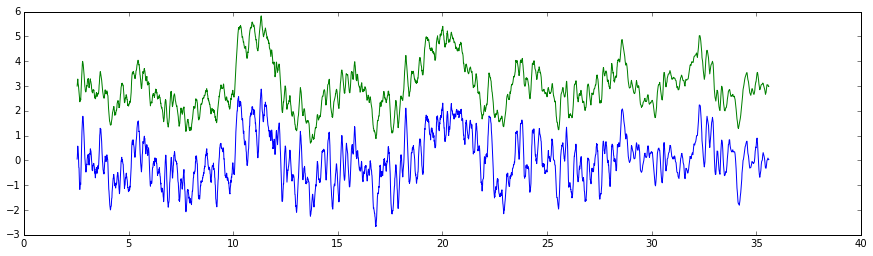

a


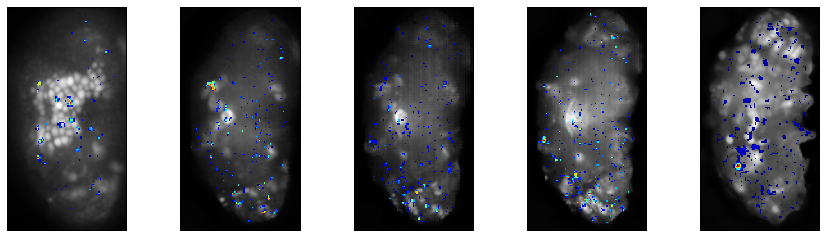

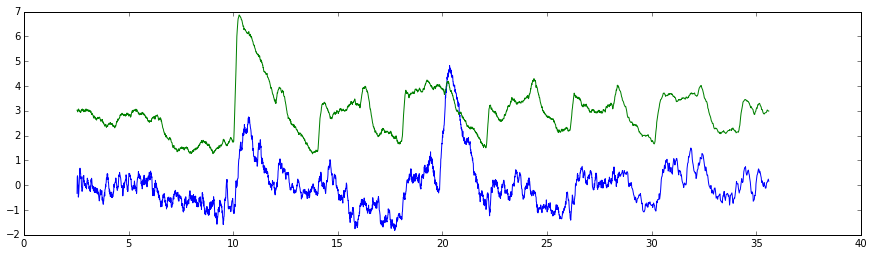

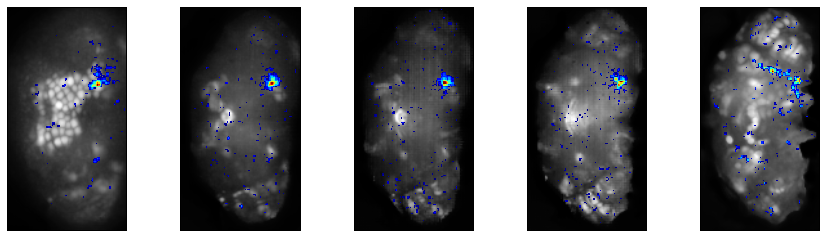

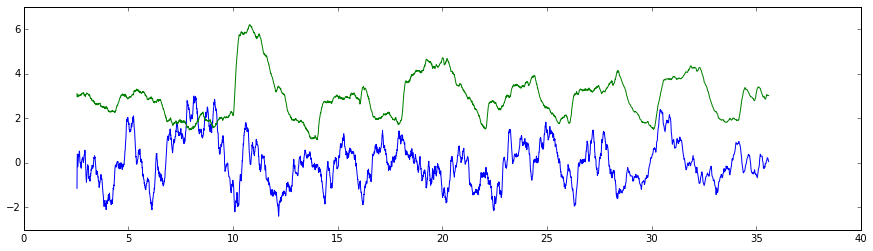

a


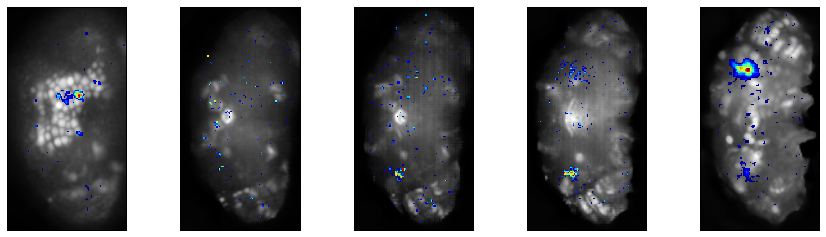

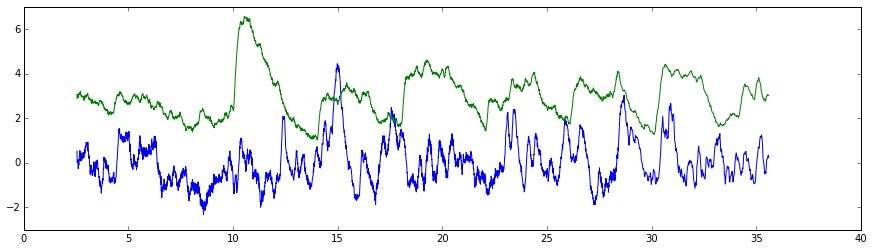

a


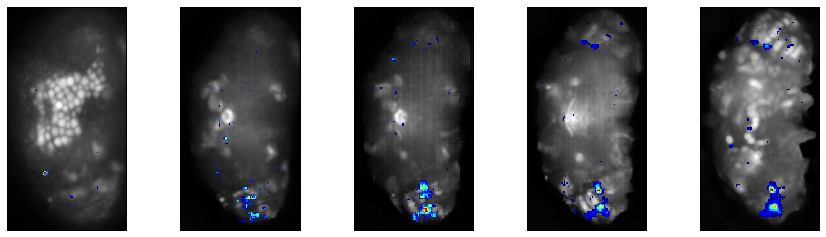

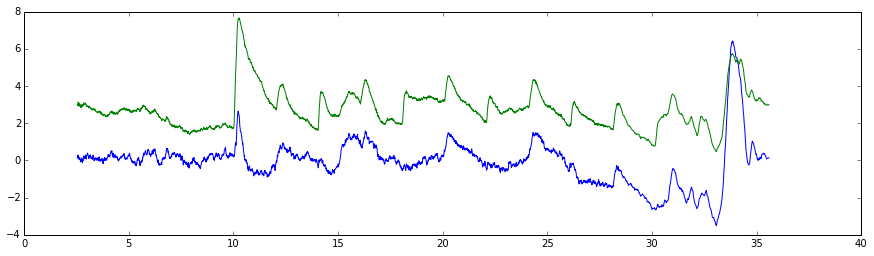

a


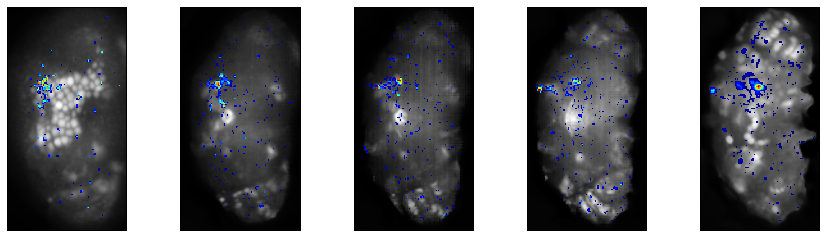

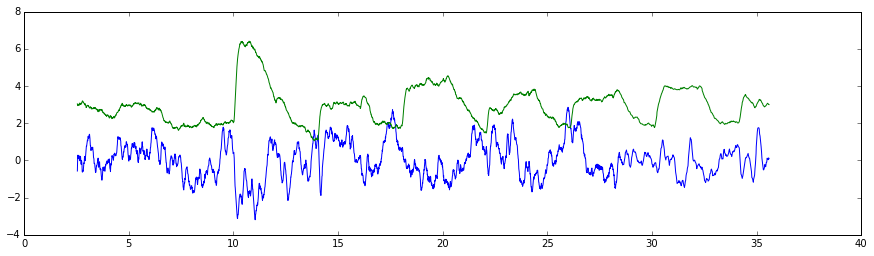

a


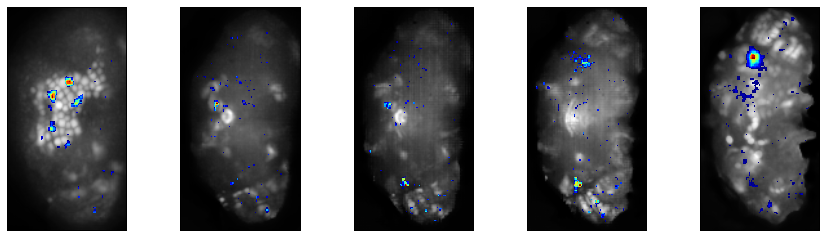

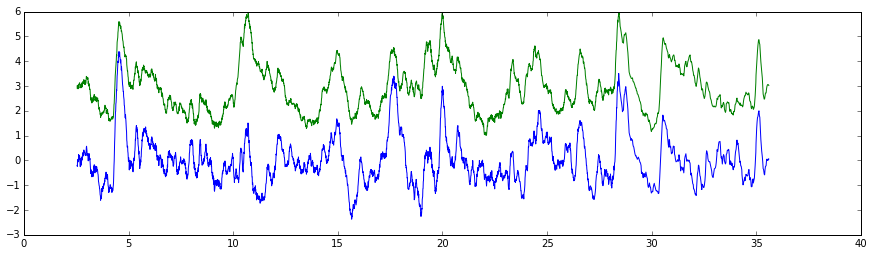

a


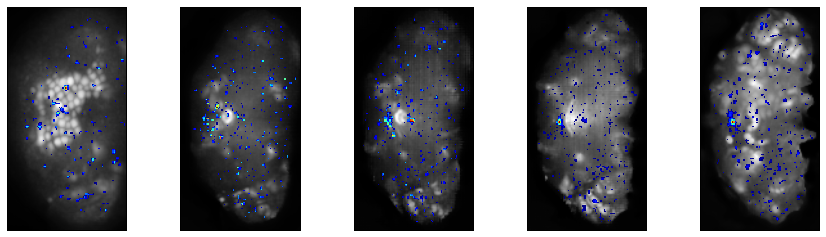

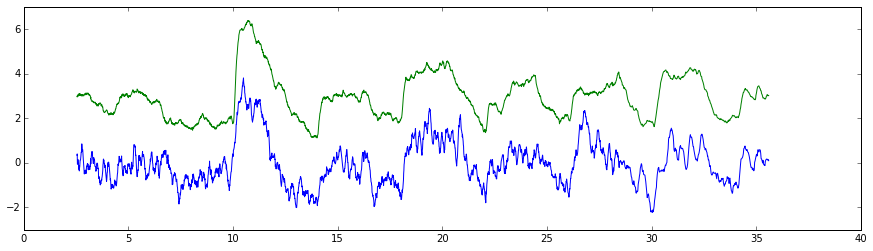

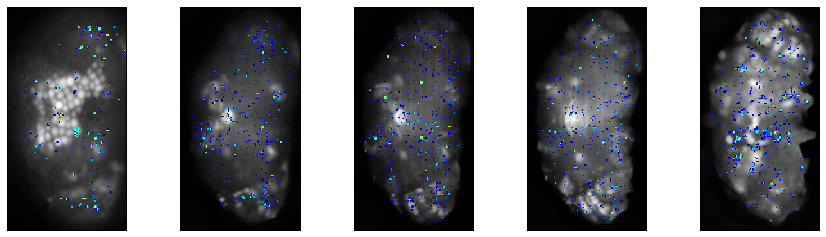

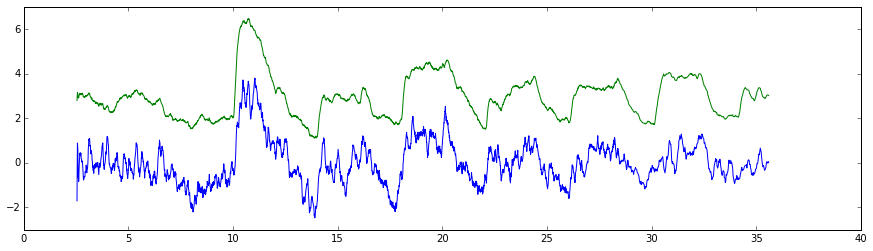

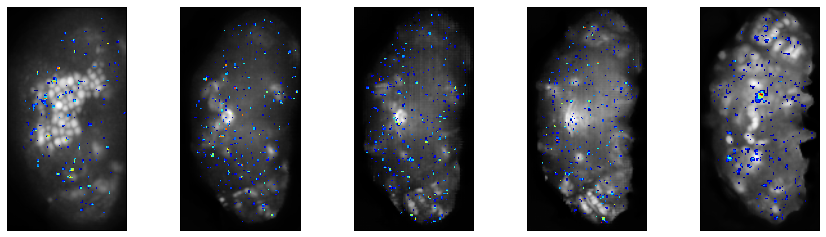

...

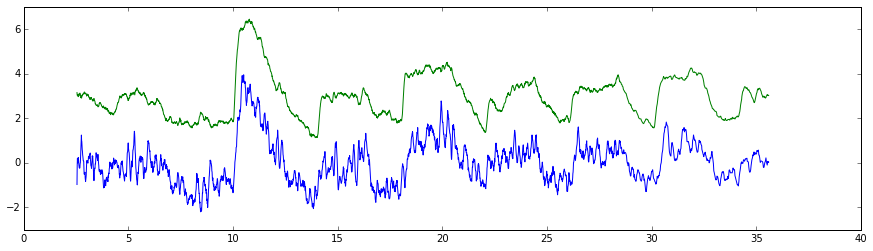

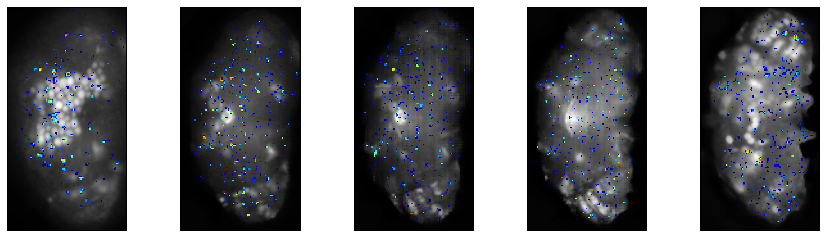

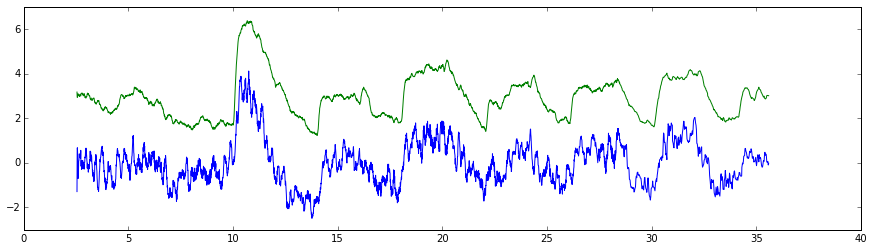

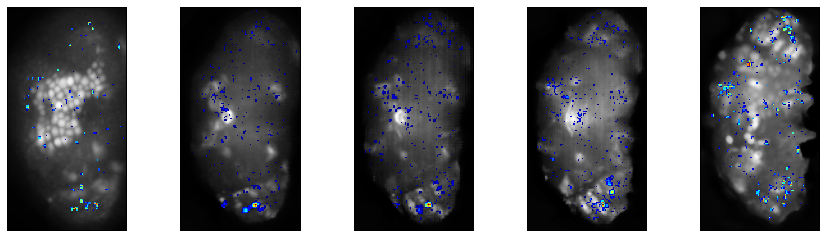

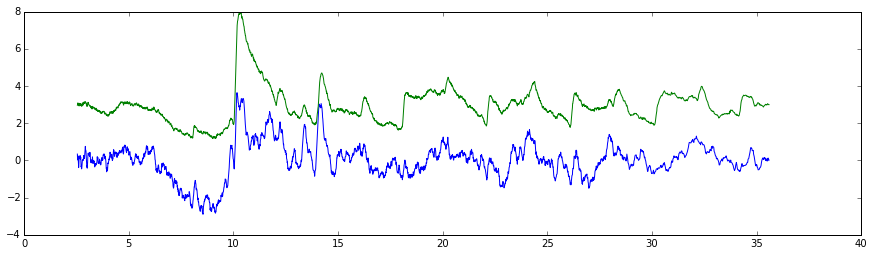

a


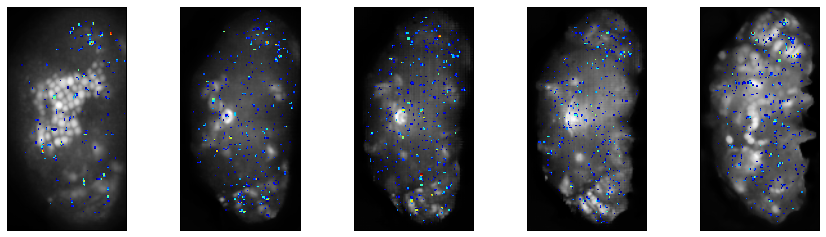

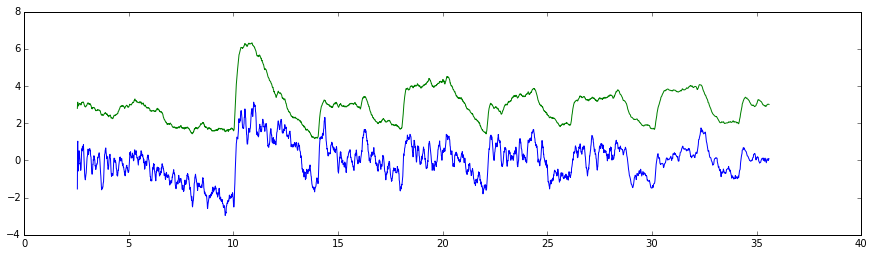

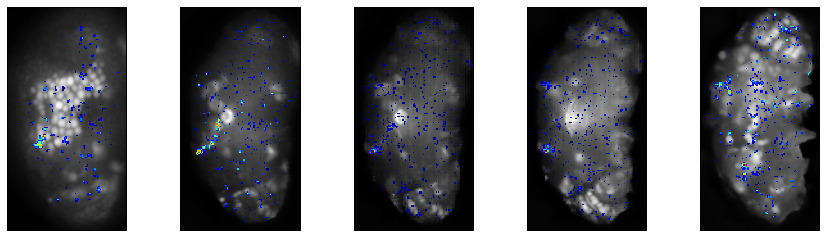

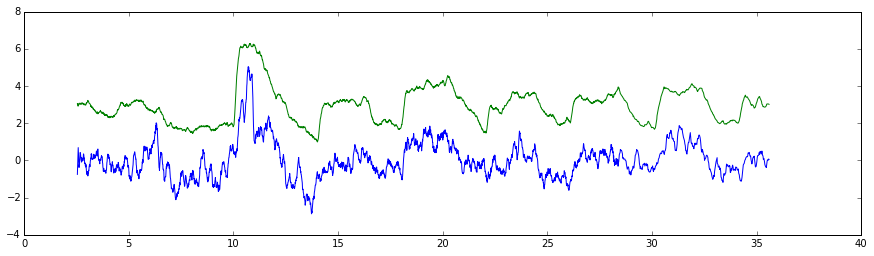

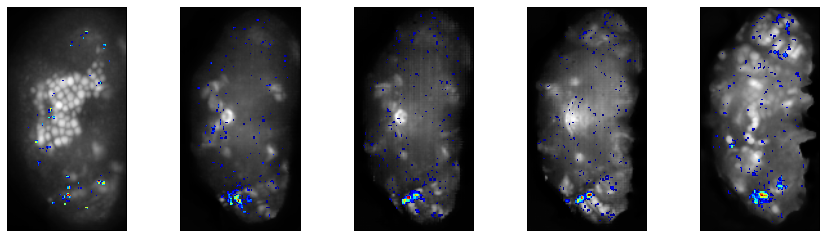

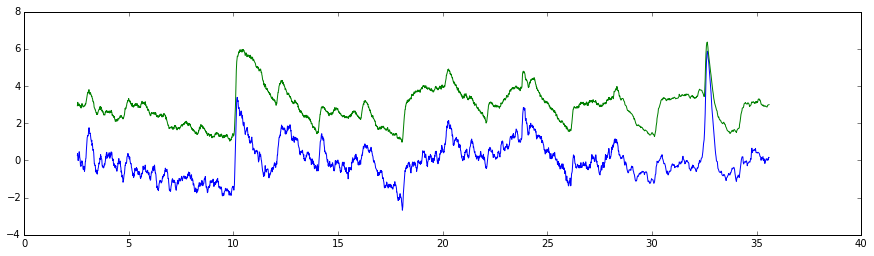

a


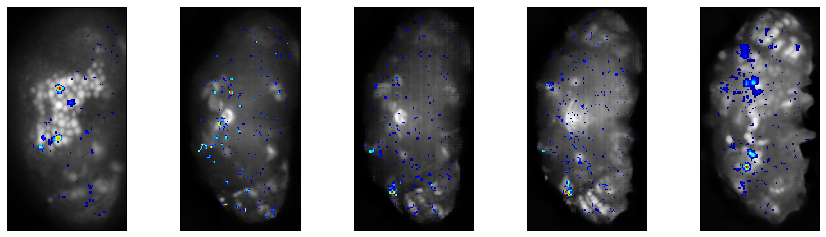

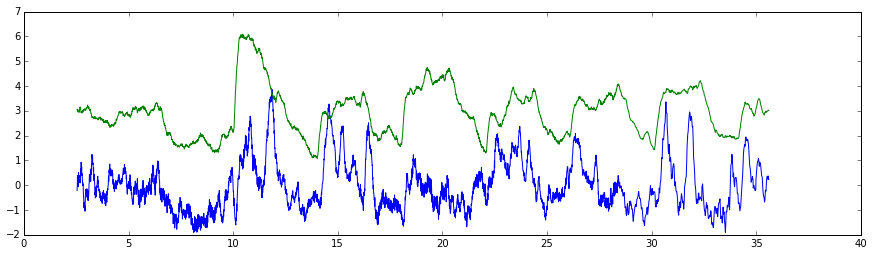

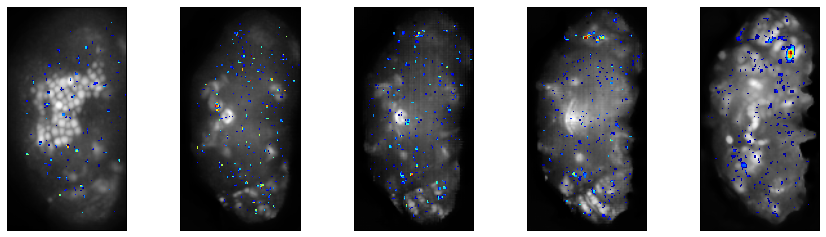

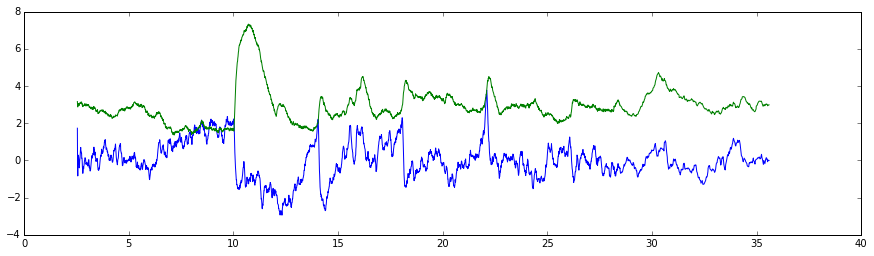

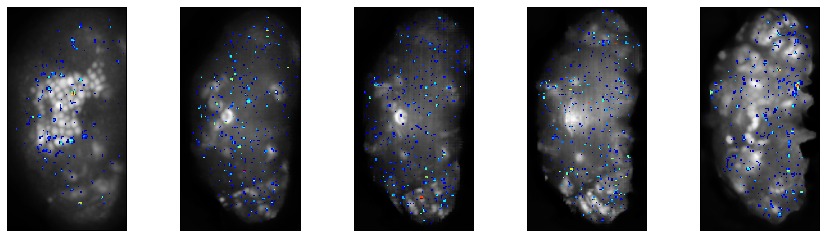

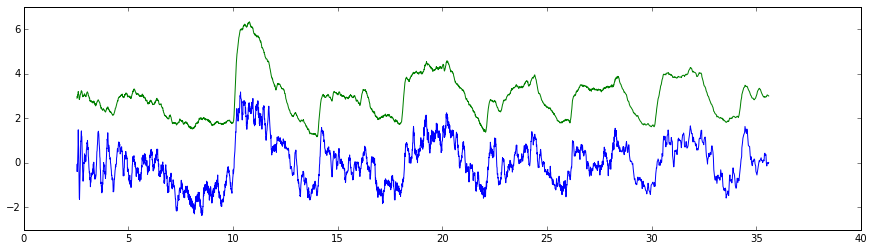

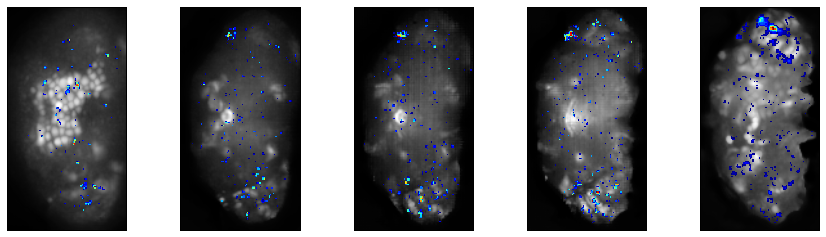

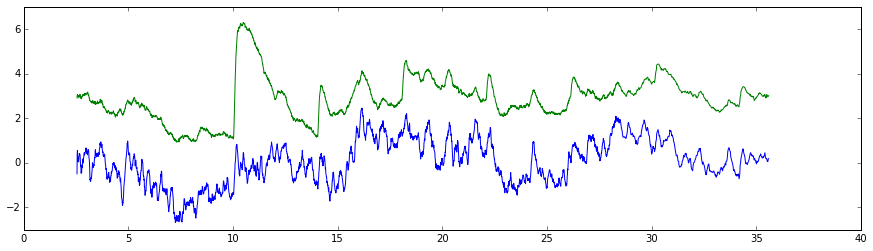

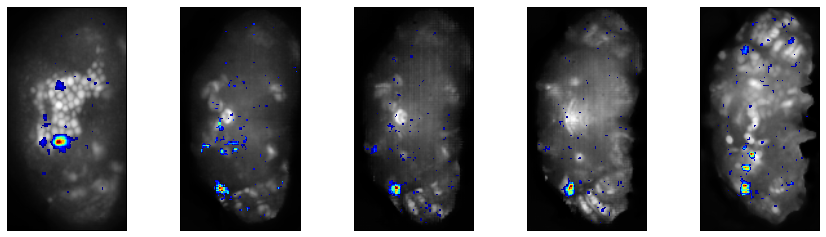

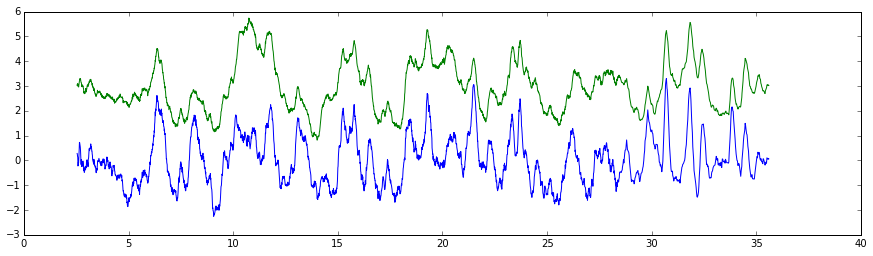

a


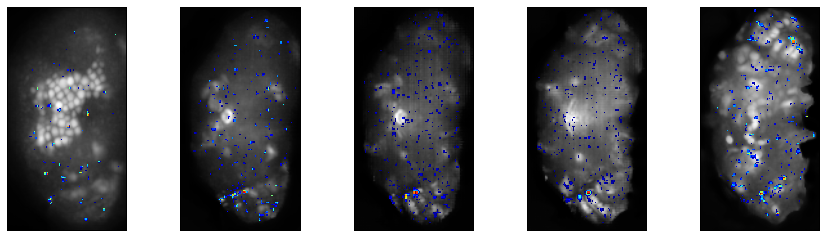

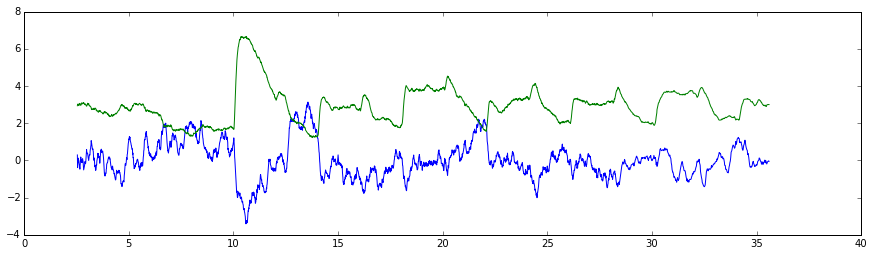

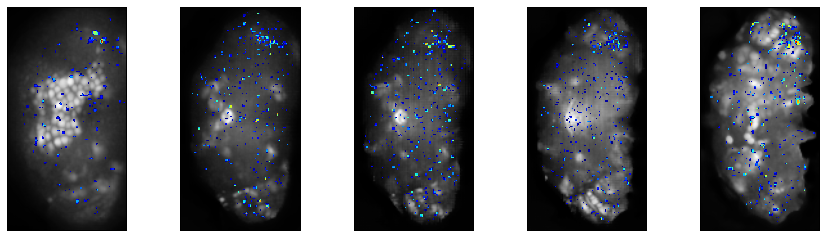

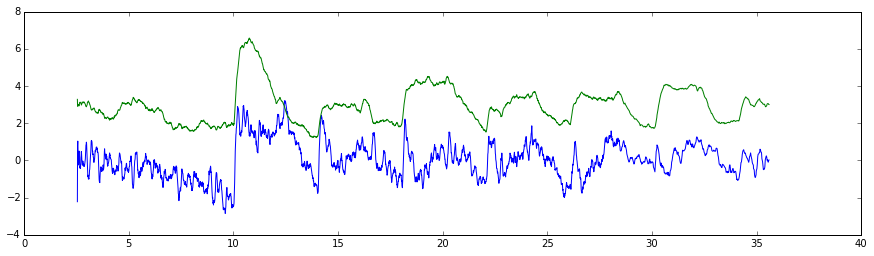

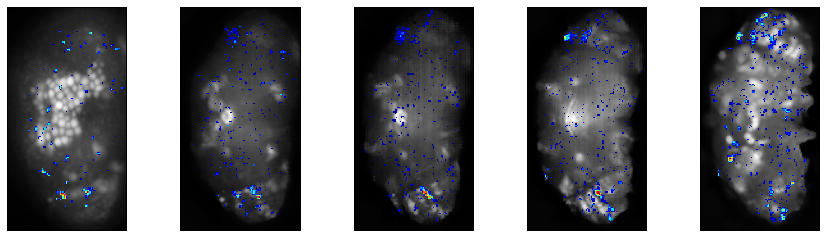

...

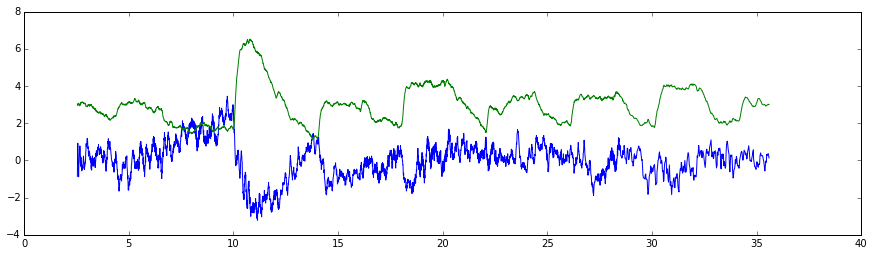

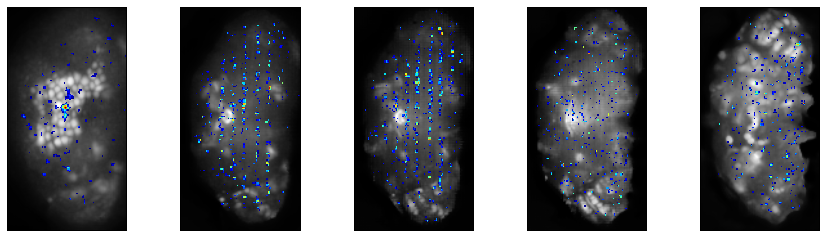

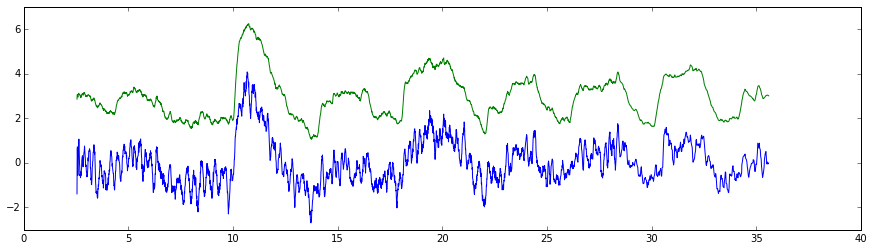

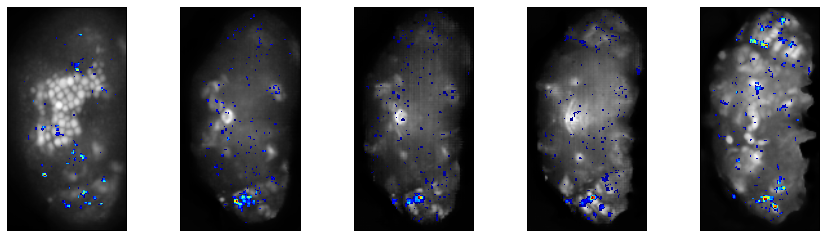

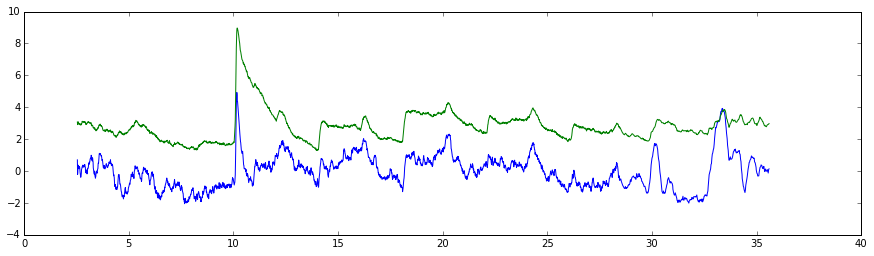

a


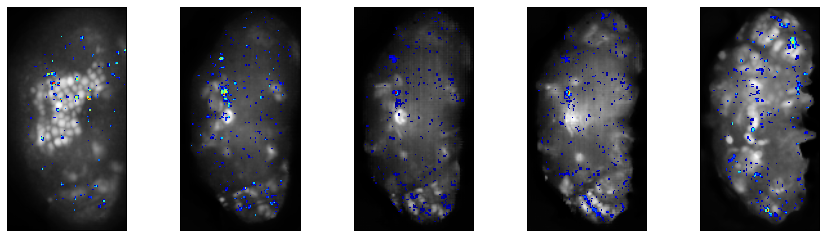

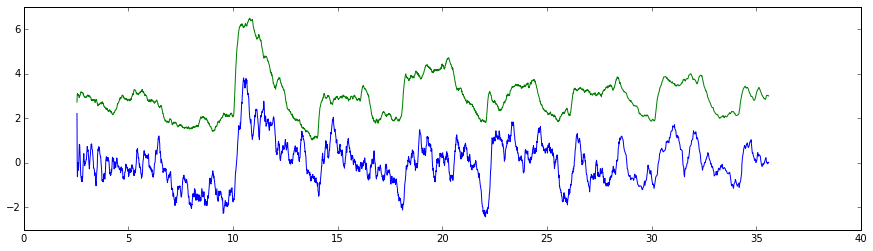

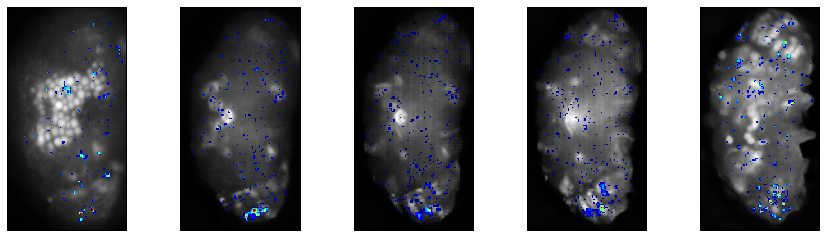

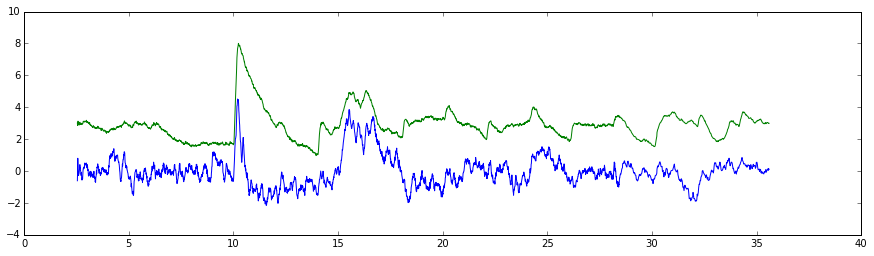

a


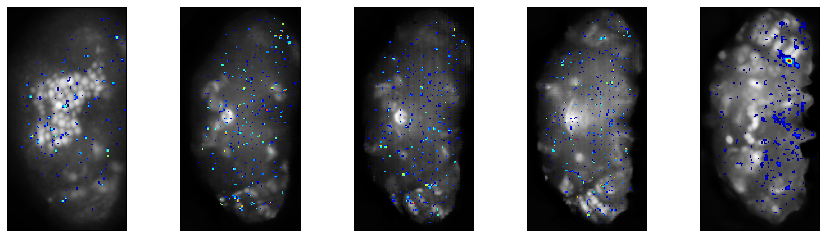

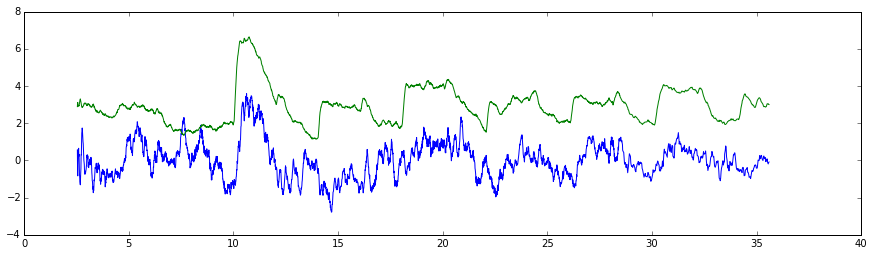

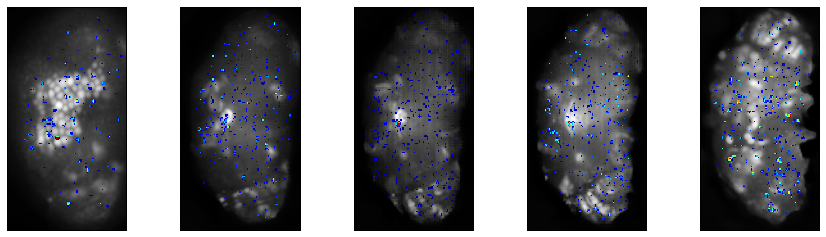

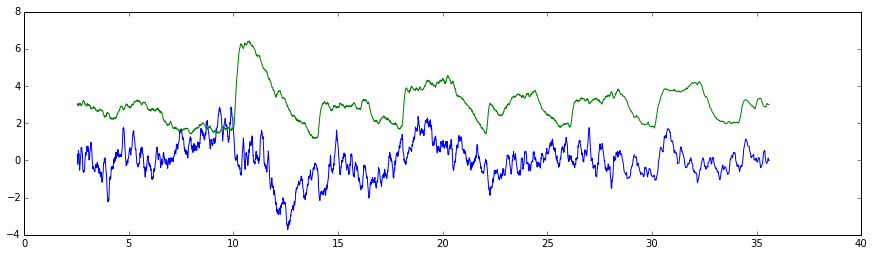

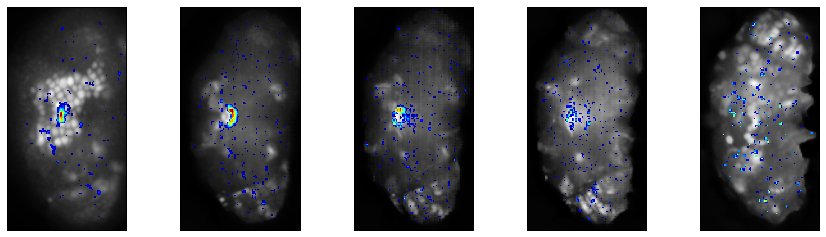

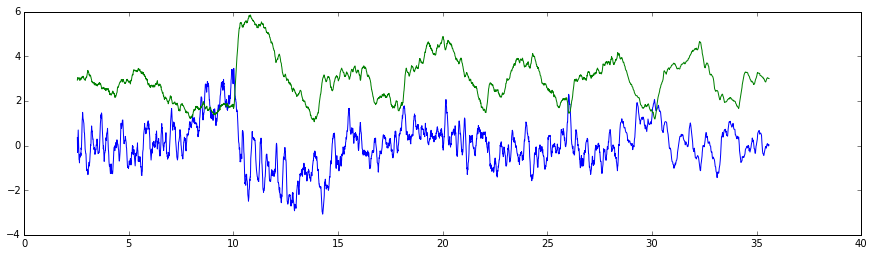

a


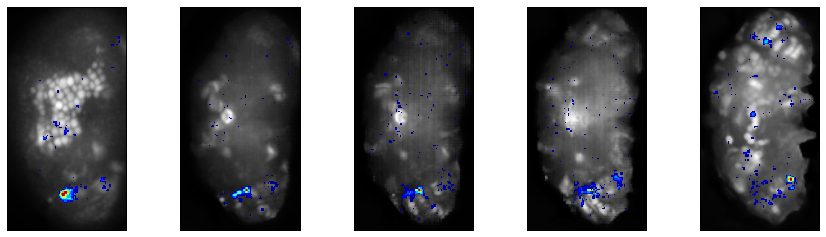

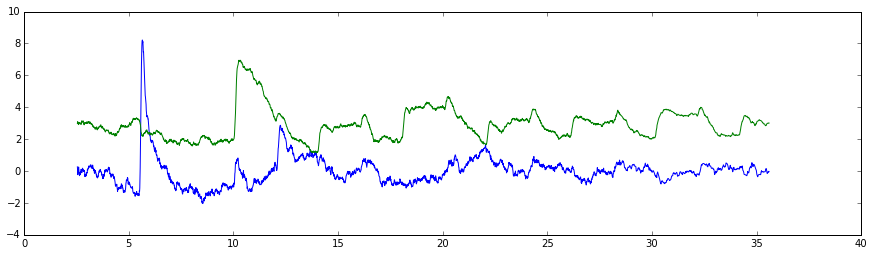

a


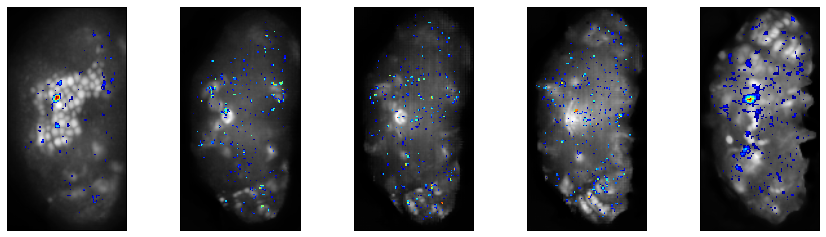

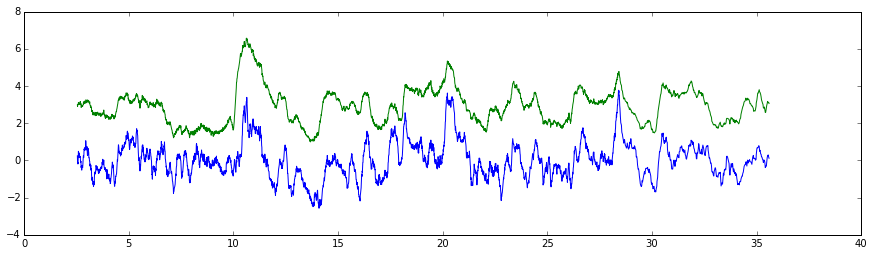

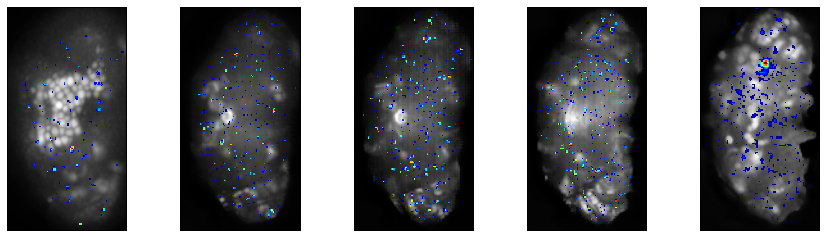

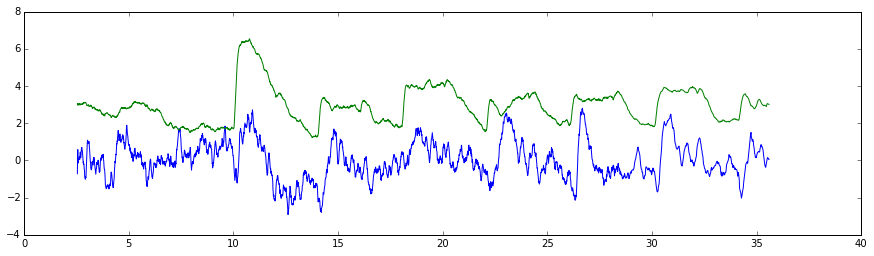

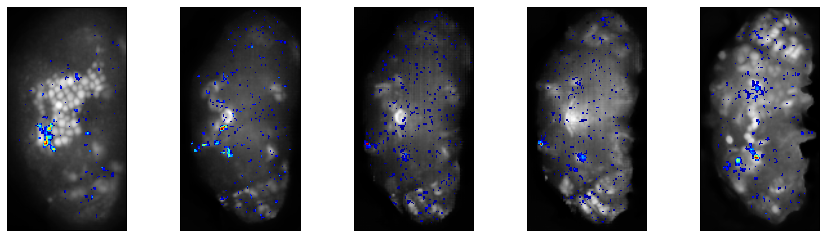

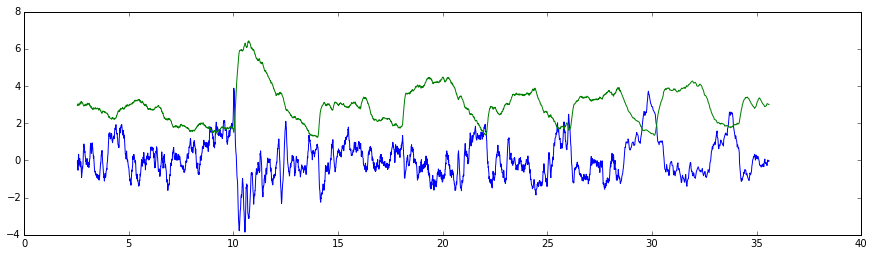

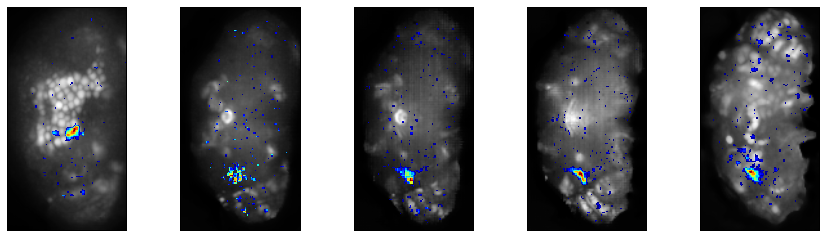

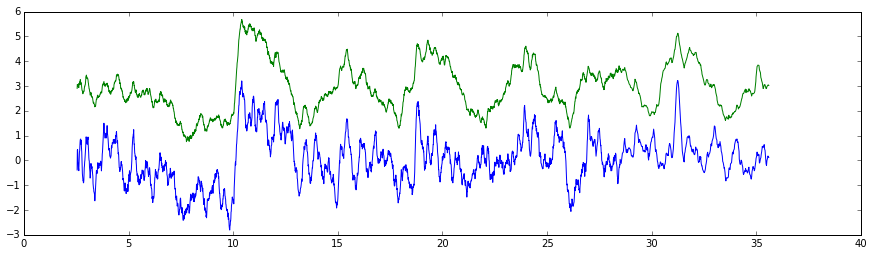

a


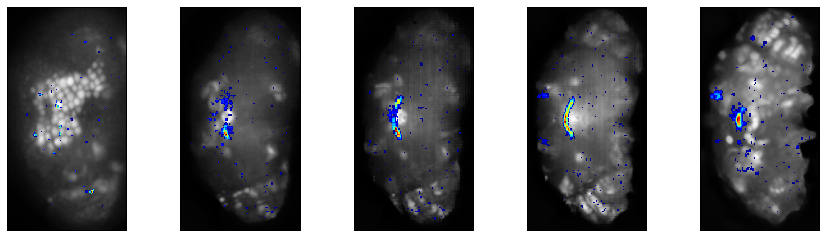

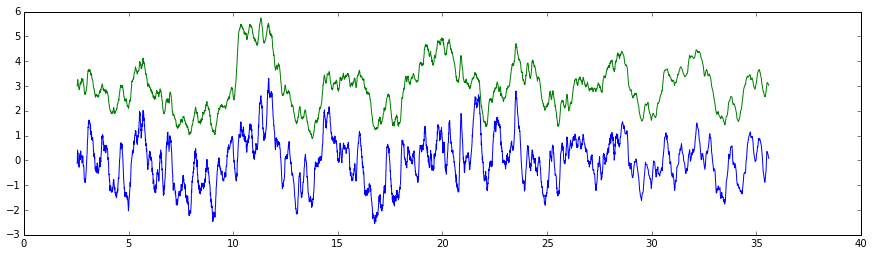

a


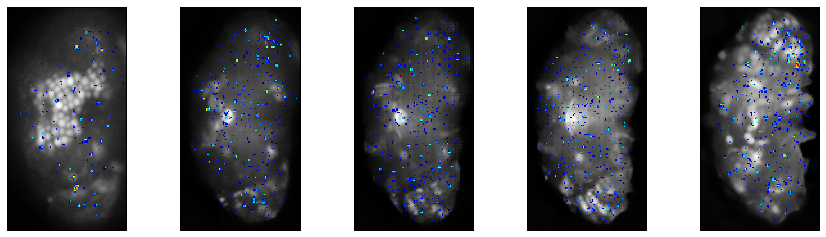

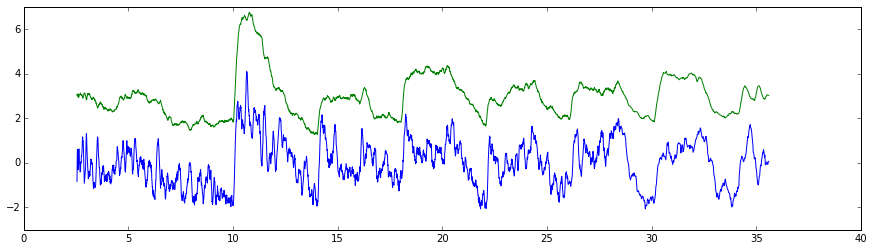

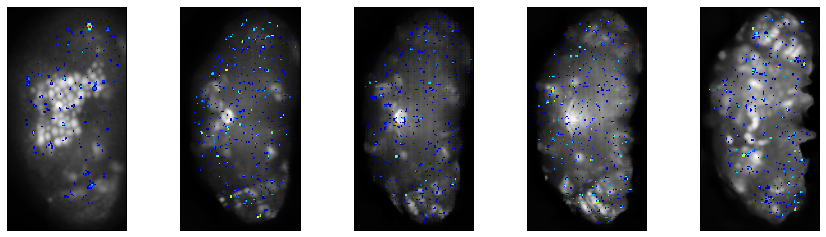

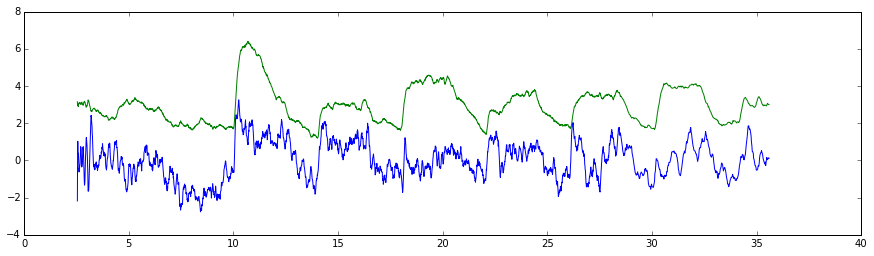

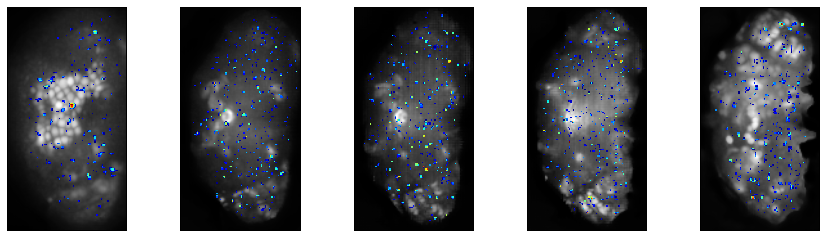

...

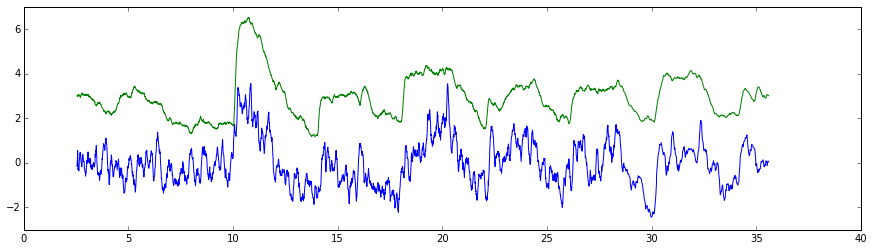

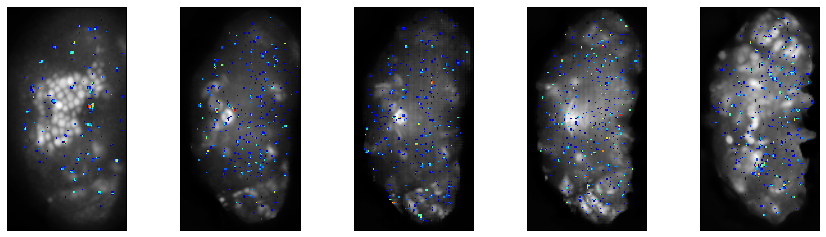

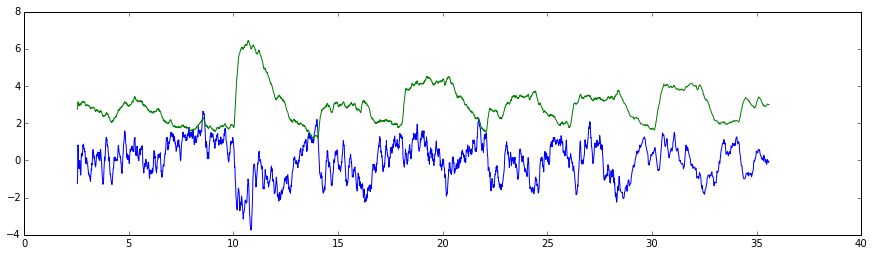

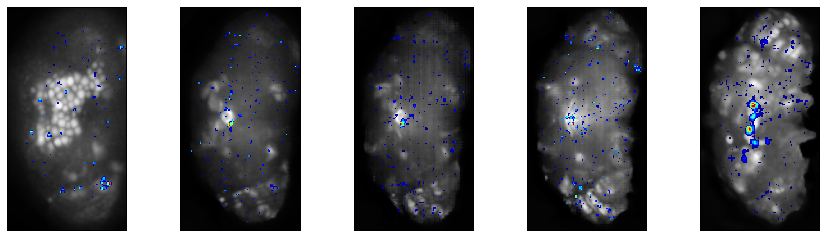

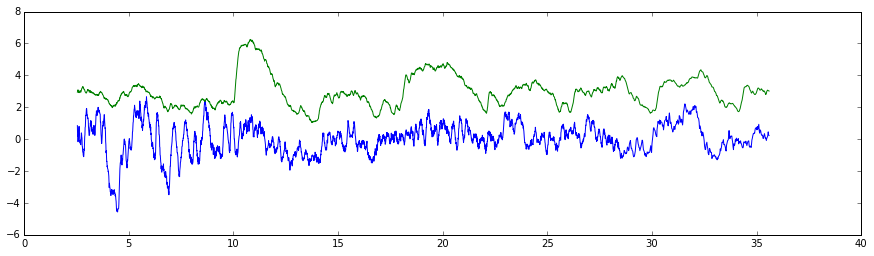

a


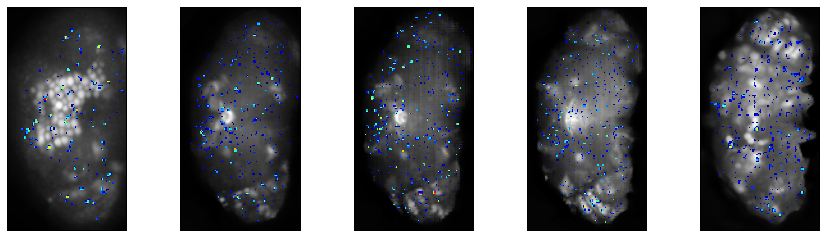

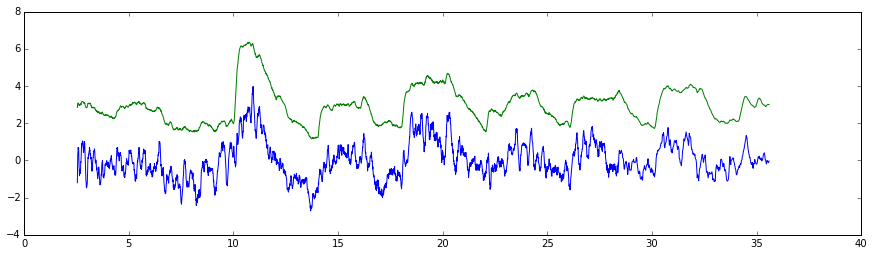

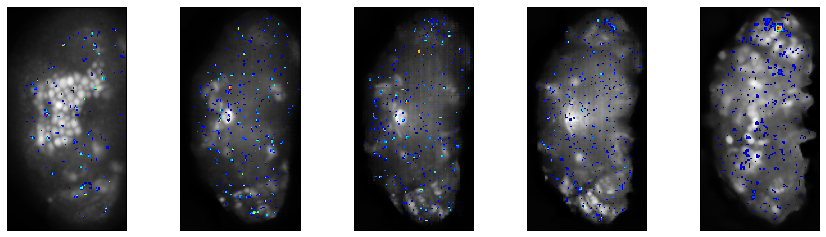

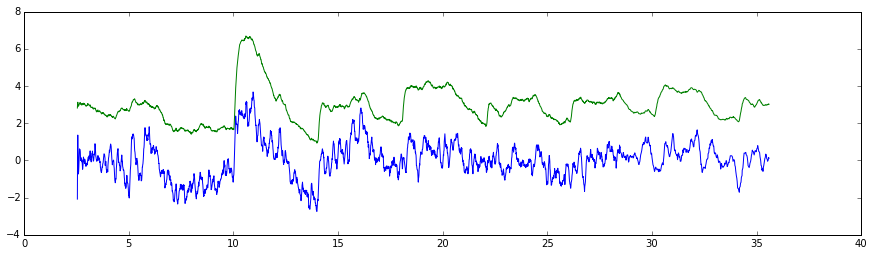

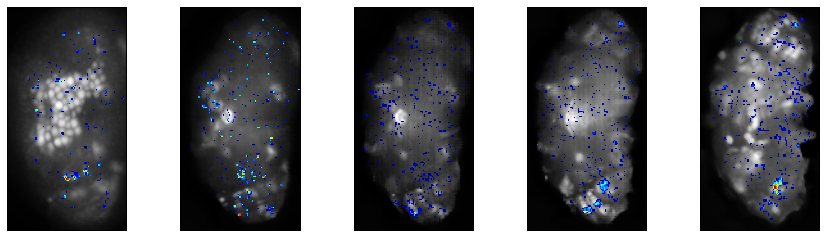

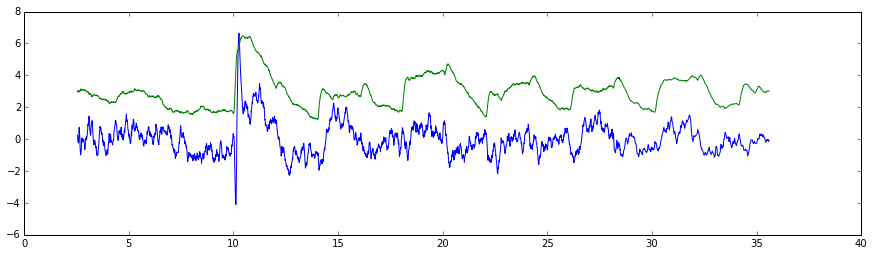

a


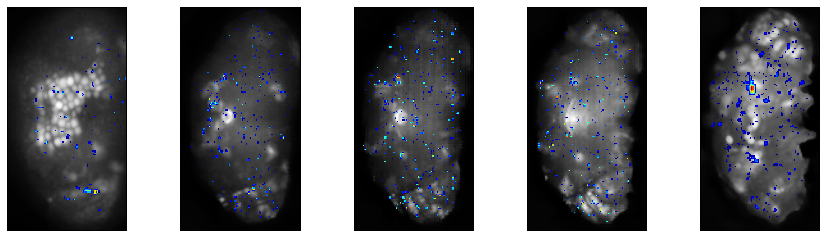

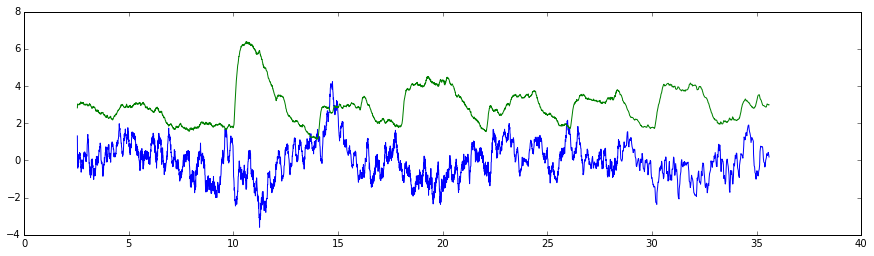

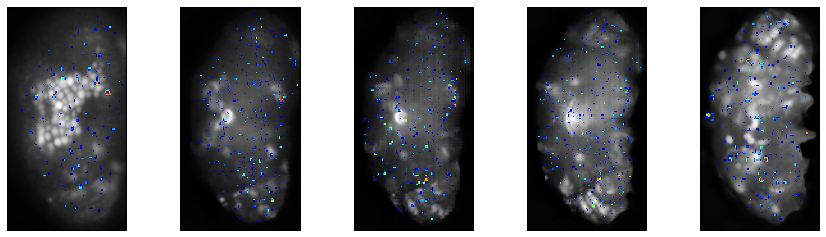

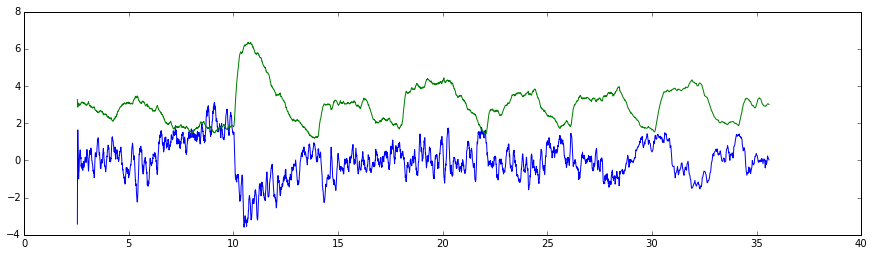

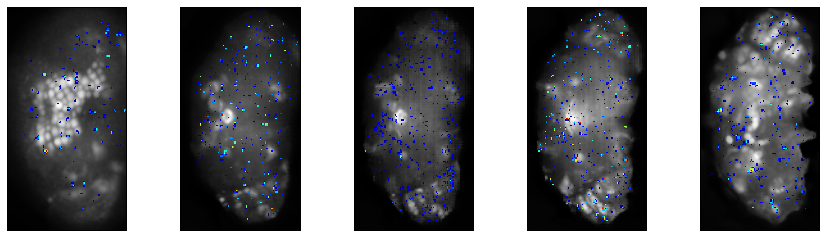

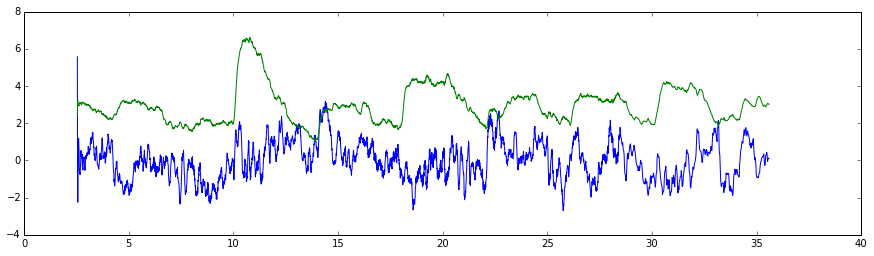

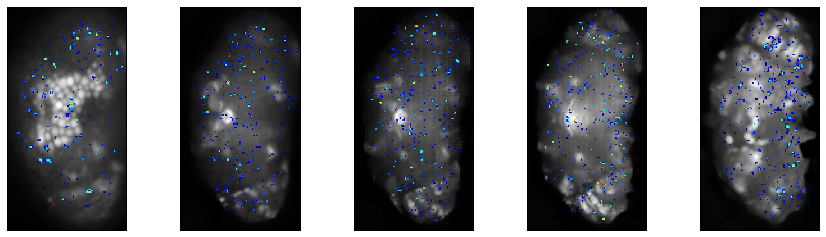

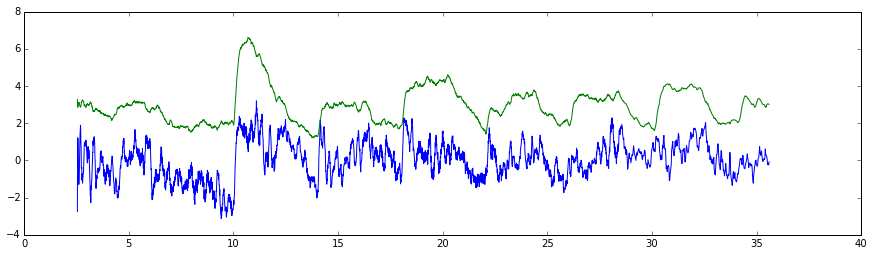

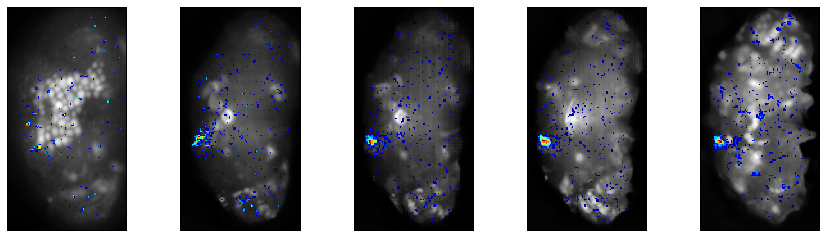

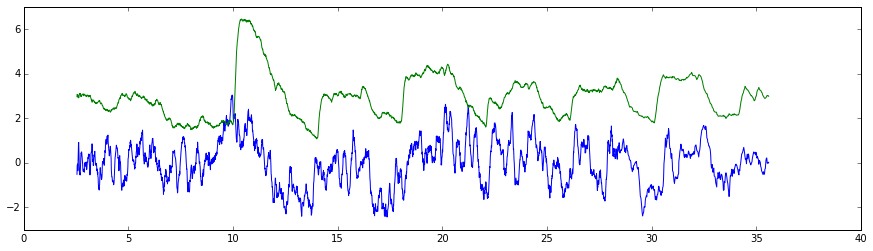

a


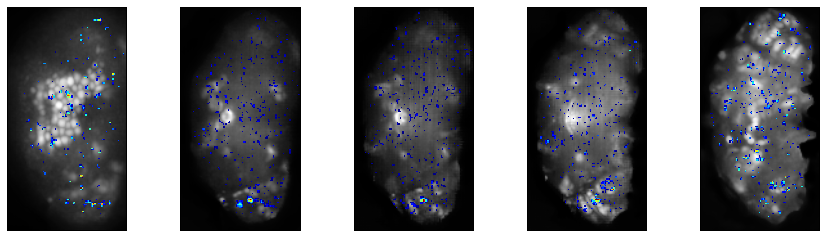

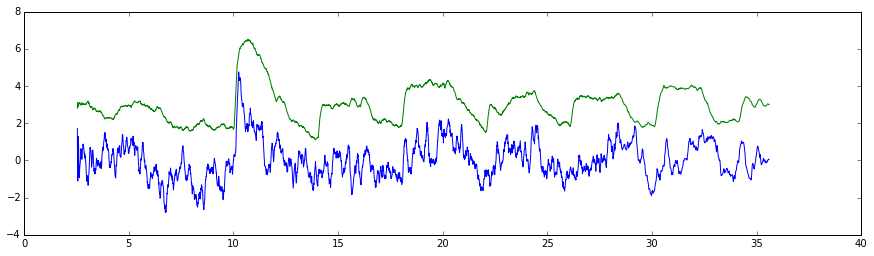

a


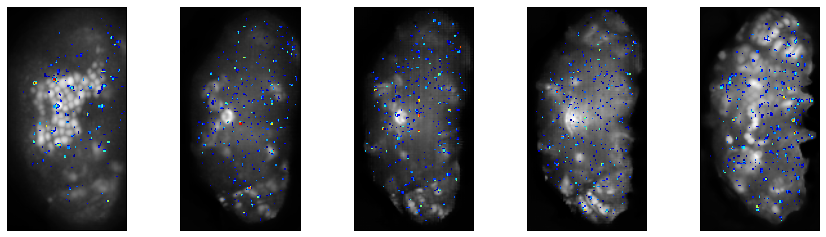

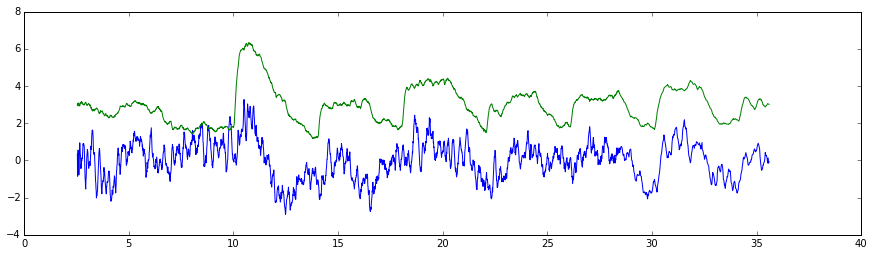

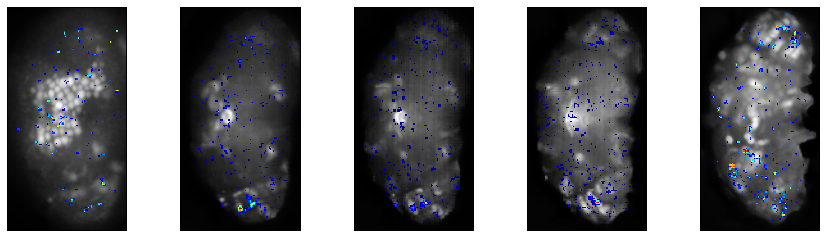

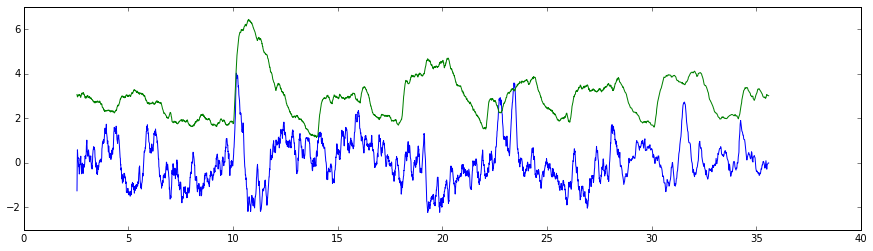

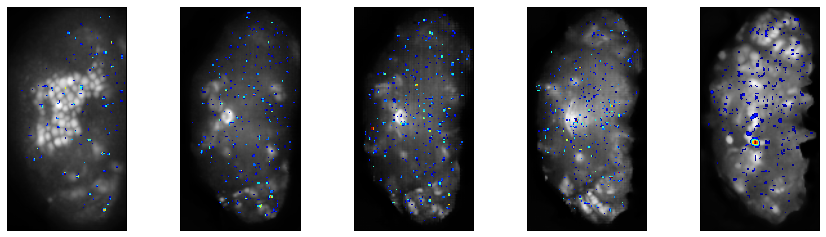

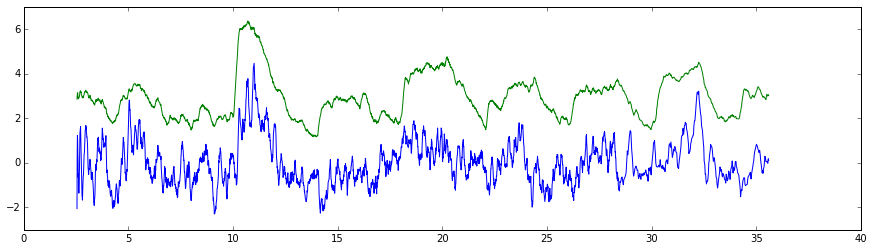

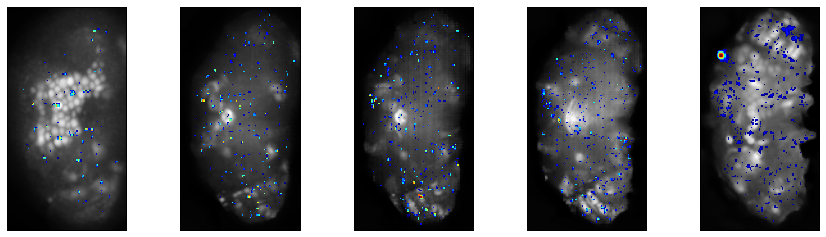

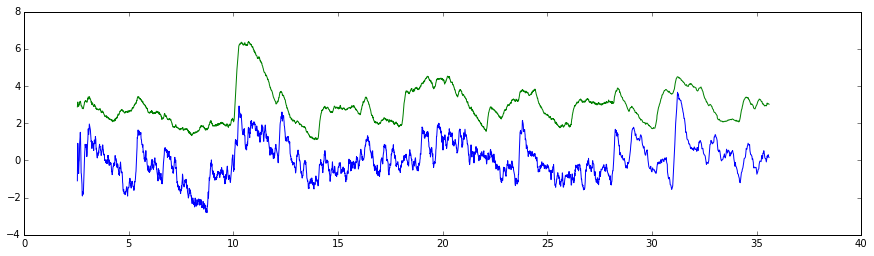

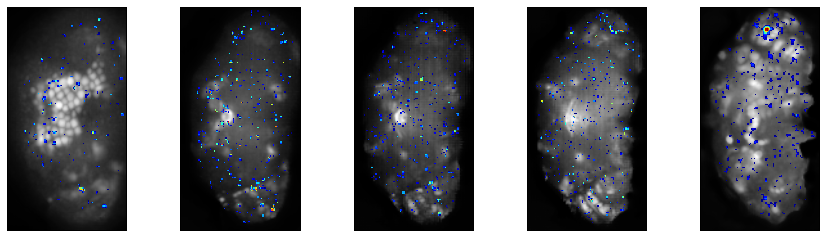

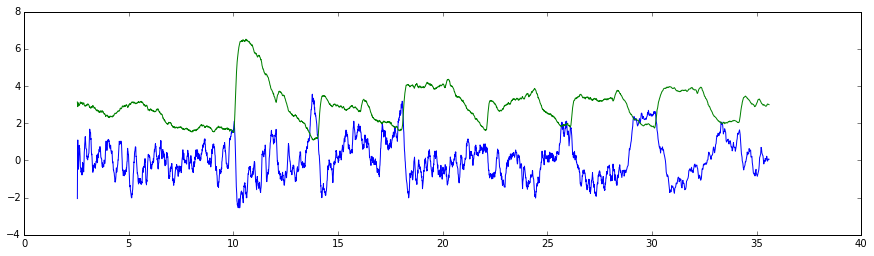

KeyboardInterrupt: 

In [38]:
for j in range(S[3]):

    a=''
    if S[2]>5:
        for i in range(Nstack):
            V=Dmaps[:,:,Indices[i],j]
            D1[:,:,i]=np.max(V,2)
        D2[:,:,:,j]=D1
        D1[D1==0]=np.nan
           
    else:
        for i in range(S[2]):
            V=Dmaps[:,:,i,Order[j]]
            D1[:,:,i]=V 

    #if CompMainName[j] != '':
        print(j)
        print(CompMainName[j])
    for i in range(Nstack):
        plt.subplot(1,5,i+1)
        plt.imshow(Dmean[:,:,i],cmap=plt.cm.gray)
        plt.imshow(D1[:,:,i], cmap=my_cmap,interpolation='none')
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
        
    plt.show()
    plt.plot(Time_fluoICA,DT[:,j]/np.sqrt(np.var(DT[:,j])))
    plt.plot(Time_fluoICA,DTroi[:,j]/np.sqrt(np.var(DTroi[:,j]))+3)               

    plt.show()
    a=raw_input()
    
    Label_ICs.append(a)
    if Label_ICs[j]!='':
        Good_ICs[j]=1

In [39]:
DT.shape

(2916, 199)

In [40]:
Dmaps.shape

(174, 93, 12, 199)

In [41]:
fn=open('/home/sophie/Desktop/862863GoodICs150.txt','w')
for i in range(S[3]):
    if Good_ICs[i]:
        print>>fn, i
        print>>fn, CompMainName[i]
        print>>fn, Good_ICs[i]

In [51]:
C1=np.zeros([6,3])
C1[0][:]=(1,0,0)
C1[1][:]=(0,1,0)
C1[2][:]=(0,0,1)
C1[3][:]=(1,1,0)
C1[4][:]=(0,1,1)
C1[5][:]=(1,0,1)
S1=DT.shape

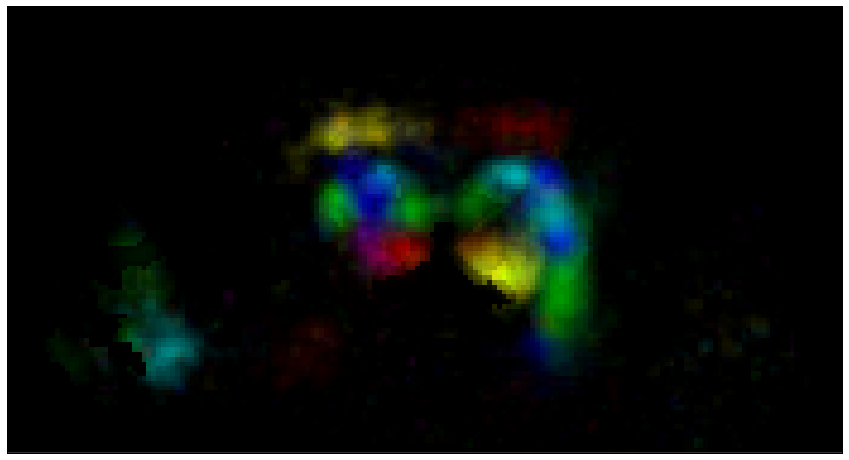

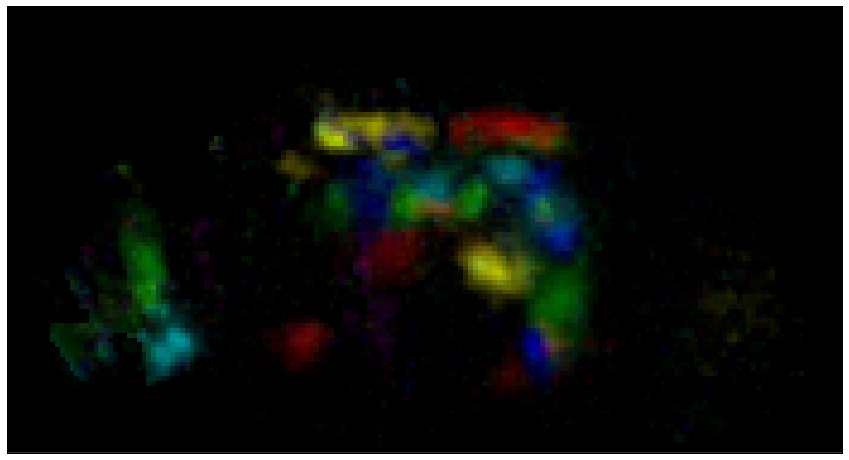

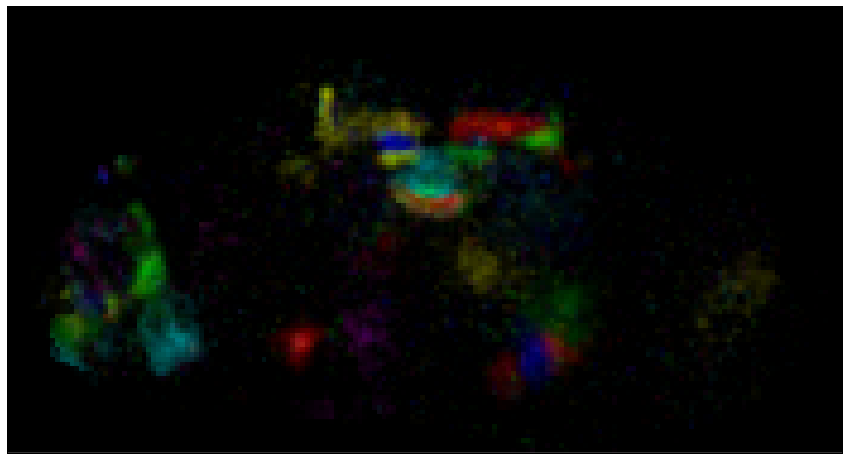

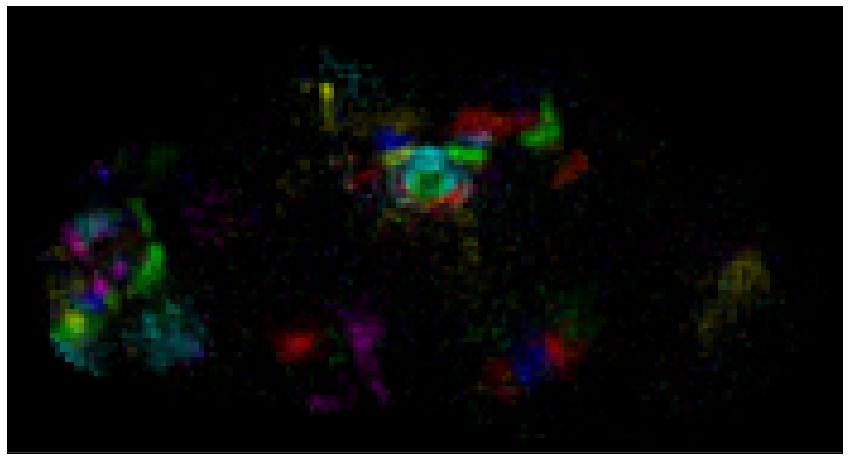

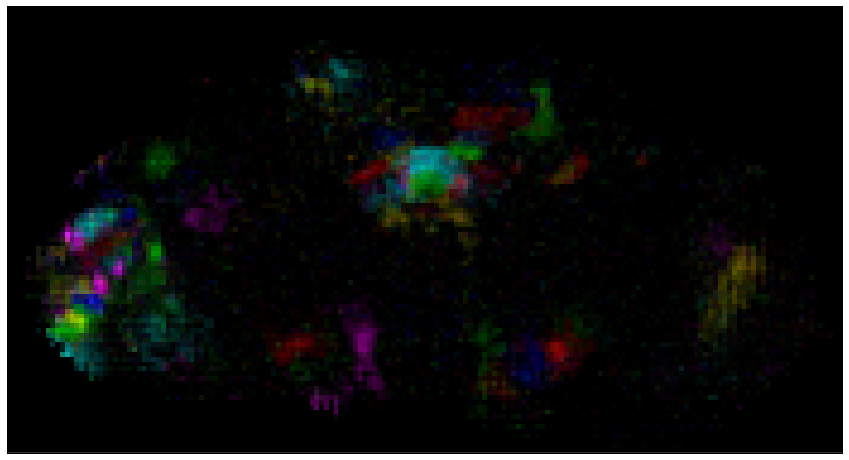

...

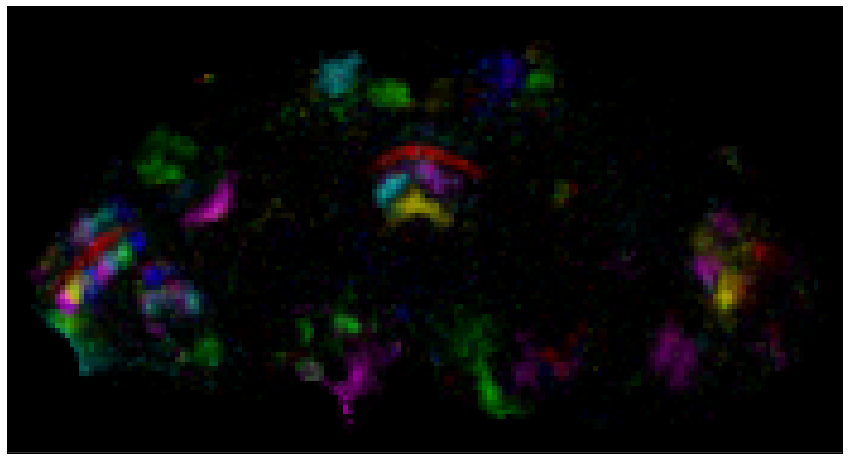

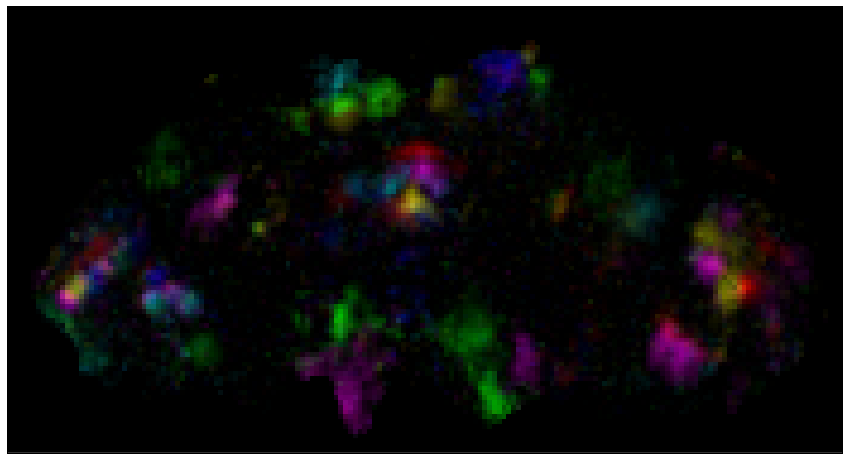

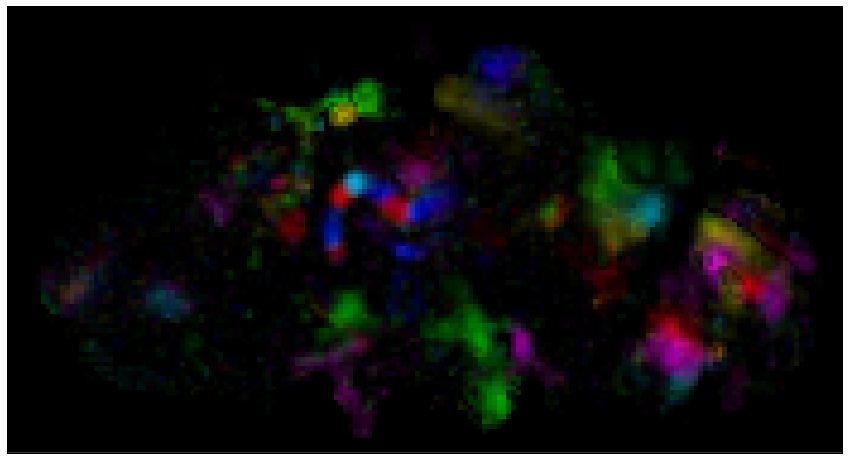

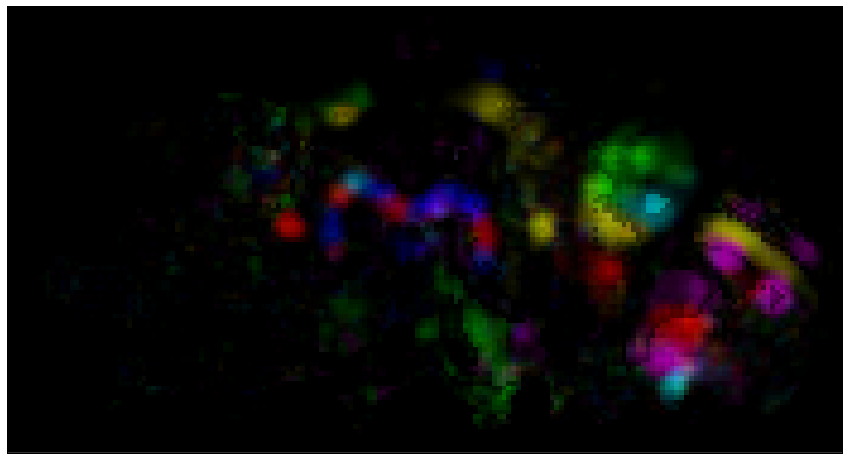

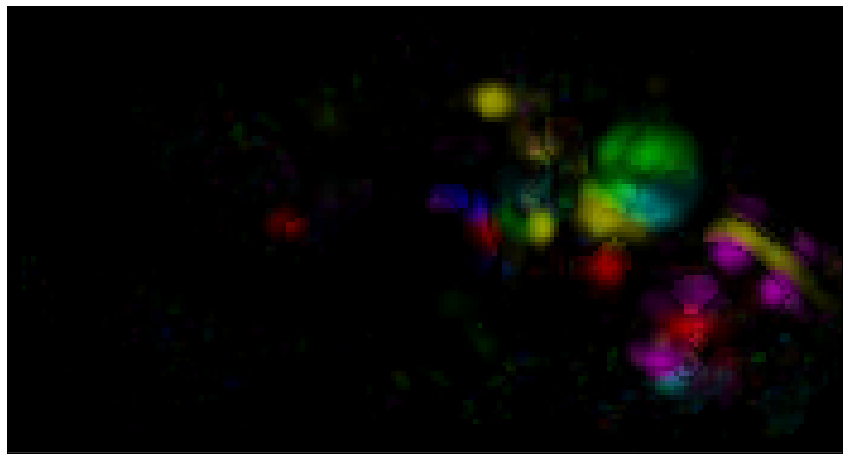

In [52]:
pylab.rcParams['figure.figsize'] = (20, 8)
Amap=np.zeros((S[0],S[1],S[2],3))
AllMaps=np.zeros((S[0],S[1],S[2],3))
Dmv=np.zeros((S[0],S[1],S[2]))
C=np.zeros((S[3],3))
i=0
for j in range(S[3]): 
    if Good_ICs[j]:
        C[j,:]=C1[j%6][:]
        Dmv[:,:,:]=data[:,:,:,j]/np.sqrt(np.var(np.reshape(data[:,:,:,j],S[0]*S[1]*S[2])))
        Dmv=Dmv-2.5
        Dmv[Dmv<0]=0

        for k in range(3):
            M=np.max(np.squeeze(np.reshape(Dmv[:,:,:],S[0]*S[1]*S[2])))
            Amap[:,:,:,k]=0.6*Dmv[:,:,:]*C[j,k]/M
        AllMaps=AllMaps+Amap   
    
for i in range(S[2]):
    Rotated=ndimage.rotate(AllMaps[:,:,i,:],-90)
    plt.imshow(Rotated,cmap=my_cmap,interpolation='none')
    frame1 = plt.gca()
    frame1.axes.get_xaxis().set_visible(False)
    frame1.axes.get_yaxis().set_visible(False)
    fig1=plt.gcf()
    name='/home/sophie/Desktop/862/862stack'+str(i)+'.png'
    fig1.savefig(name)
    plt.show() 
#plt.tight_layout(pad=0,w_pad=0,h_pad=0)

In [53]:
if len(Label_ICs)<S[3]:
    for j in range(S[3]-len(Label_ICs)):
      Label_ICs.append('')  

In [54]:
G=Good_ICs.tolist();

In [55]:
len(Good_ICs)

199

In [56]:
G.count(1)

84

# Reorder by larger sub-regions (presumed ~stimulus to motor)

In [57]:
LargerRegionsDic={'':'','AME_R':'OL','LO_R':'OL','NO':'CX','BU_R':'CX','PB':'CX','LH_R':'LH','LAL_R':'LX','SAD':'PENP'
               ,'CAN_R':'PENP','AMMC_R':'PENP','ICL_R':'INP','VES_R':'VMNP','IB_R':'INP','ATL_R':'INP','CRE_R':'INP'
               ,'MB_PED_R':'MB','MB_VL_R':'MB','MB_ML_R':'MB','FLA_R':'PENP','LOP_R':'OL','EB':'CX','AL_R':'AL',
                'ME_R':'OL','FB':'CX','SLP_R':'SNP','SIP_R':'SNP','SMP_R':'SNP','AVLP_R':'VLNP','PVLP_R':'VLNP',
                'IVLP_R':'VLNP','PLP_R':'VLNP','AOTU_R':'VLNP','GOR_R':'VMNP','MB_CA_R':'MB','SPS_R':'VMNP',
                'IPS_R':'VMNP','SCL_R':'INP','EPA_R':'VMNP','GNG':'GNG','PRW':'PENP','GA_R':'LX','AME_L':'OL'
                ,'LO_L':'OL','BU_L':'CX','LH_L':'LH','LAL_L':'LX','CAN_L':'PENP','AMMC_L':'PENP','ICL_L':'INP',
                'VES_L':'VMNP','IB_L':'INP','ATL_L':'INP','CRE_L':'INP','MB_PED_L':'MB','MB_VL_L':'MB',
                'MB_ML_L':'MB','FLA_L':'PENP','LOP_L':'OL','AL_L':'AL','ME_L':'OL','SLP_L':'SNP','SIP_L':'SNP',
                'SMP_L':'SNP','AVLP_L':'VLNP','PVLP_L':'VLNP','IVLP_L':'VLNP','PLP_L':'VLNP','AOTU_L':'VLNP',
                'GOR_L':'VMNP','MB_CA_L':'MB','SPS_L':'VMNP','IPS_L':'VMNP','SCL_L':'INP','EPA_L':'VMNP','GA_L':'LX'}

In [73]:
SmallRegionsSorted=['ME_L','ME_R','LO_R','LO_L','LOP_R','LOP_L','AME_R','AME_L',
                  'PLP_R','PLP_L','PVLP_R','PVLP_L','AVLP_R','AVLP_L','AOTU_R','AOTU_L','IVLP_R','IVLP_L',
                  'AL_R','AL_L',
                  'MB_CA_R','MB_CA_L','MB_PED_R','MB_PED_L','MB_VL_R','MB_VL_L','MB_ML_R','MB_ML_L',
                  'SMP_R','SMP_L','SIP_R','SLP_L','SLP_R','SIP_L',
                  'LH_R','LH_L',                  
                  'CRE_R','CRE_L','ICL_R','ICL_L','SCL_R','SCL_L','IB_R','IB_L',
                  'EB','ATL_R','ATL_L','PB','NO','FB',
                  'BU_R','BU_L','LAL_R','LAL_L','GA_R','GA_L',
                  'GOR_R','GOR_L','EPA_R','EPA_L','VES_R','VES_L','SPS_R','SPS_L','IPS_R','IPS_L',
                  'AMMC_R','AMMC_L','SAD','FLA_R','FLA_L','PRW','CAN_R','CAN_L',
                  'GNG','']

In [74]:
Tozip=range(len(SmallRegionsSorted))
SmallRegionsDic=dict(zip(SmallRegionsSorted,Tozip))

In [75]:
LargerRegion=[LargerRegionsDic[CompMainName[i]] for i in range(S[3])]

In [195]:
LargerRegionMask=[LargerRegionsDic[Names[i][0]] for i in range(75)]
LargerRegionMaskId=np.zeros(87)
for i in range(75):
    LargerRegionMaskId[Num[i]]=np.int(LargerRegionInd[LargerRegionMask[i]])

In [196]:
LargerRegionMaskId

array([  0.,   0.,   1.,   1.,   8.,   8.,   8.,   6.,   9.,  11.,  11.,
        11.,  10.,   3.,  10.,  10.,  10.,   5.,   5.,   5.,  11.,   0.,
         1.,   8.,   4.,   1.,   8.,   7.,   7.,   7.,   2.,   2.,   2.,
         2.,   2.,   3.,   5.,   3.,   3.,  10.,   3.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,  12.,  11.,   9.,   1.,   1.,   8.,
         6.,   9.,  11.,  11.,  10.,   3.,  10.,  10.,  10.,   5.,   5.,
         5.,  11.,   0.,   1.,   4.,   1.,   7.,   7.,   7.,   2.,   2.,
         2.,   2.,   2.,   3.,   5.,   3.,   3.,  10.,   3.,   9.])

In [200]:
sio.savemat('/home/sophie/Desktop/LargerRegionMaskId.mat',{'MaskId':LargerRegionMaskId})

In [76]:
LargerRegionInd={ 'OL':1,'VLNP':2,'VMNP':3,'AL':4,'MB':5,'LH':6,'SNP':7,'CX':8,'LX':9,'INP':10,'PENP':11,'GNG':12,'':13}

In [77]:
LargerRegionI=np.array([LargerRegionInd[LargerRegion[i]] for i in range(S[3])])

In [78]:
SmallRegion=np.array([SmallRegionsDic[CompMainName[i]] for i in range(S[3])])

In [79]:
NewOrder=np.argsort(SmallRegion)

In [80]:
SmallRegion[NewOrder]

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,
        3,  3,  3,  3,  4,  4,  4,  4,  6,  6,  6,  8,  8, 15, 16, 17, 18,
       18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 20, 20, 20, 20, 20, 20, 20,
       20, 20, 20, 21, 21, 21, 21, 22, 22, 24, 24, 24, 25, 25, 26, 26, 26,
       26, 27, 27, 27, 27, 27, 27, 27, 28, 28, 29, 29, 32, 34, 34, 34, 34,
       34, 35, 35, 35, 38, 41, 42, 43, 43, 44, 44, 44, 44, 44, 44, 44, 44,
       45, 46, 46, 46, 46, 47, 47, 47, 47, 47, 47, 47, 47, 48, 48, 48, 49,
       49, 49, 49, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50,
       50, 50, 50, 51, 51, 51, 51, 51, 51, 51, 52, 54, 54, 54, 54, 54, 54,
       54, 57, 57, 58, 59, 61, 62, 63, 64, 65, 65, 66, 66, 66, 66, 66, 69,
       70, 72, 72, 73, 73, 73, 75, 75, 75, 75, 75, 75])

# Plot all components together

In [81]:
if S[2]>5:
    Final_map=np.zeros([S[0],S[1],5,3])
    Fmaps=np.zeros([S[0],S[1],5,3])
else:
    Final_map=np.zeros([S[0],S[1],3]) 
    Fmaps=np.zeros([S[0],S[1],3])    
C=np.zeros([S[3],3])

In [82]:
GoodICo=Good_ICs[NewOrder]
D2o=D2[:,:,:,NewOrder]
LargerRegionIo=LargerRegionI[NewOrder]
Ind=np.array(range(S[3]))
Indexo=Ind[NewOrder]
DTo=DT[:,NewOrder]

In [83]:
C=np.zeros((S[3],3))
i=0
for j in range(S[3]):  
    if LargerRegionIo[j]<12 and GoodICo[j]:
        C[j,:]=C1[i%6][:]
        for k in range(3):           
            M=np.max(np.squeeze(np.reshape(D2o[:,:,:,j],S[0]*S[1]*5)))
            Fmaps[:,:,:,k]=0.6*D2o[:,:,:,j]*C[j,k]/M
        Final_map=Final_map+Fmaps
        #print(Indexo[j])
        i=i+1

In [84]:
np.max(np.max(np.max(Final_map[:,:,:,])))

1.1108927454289381

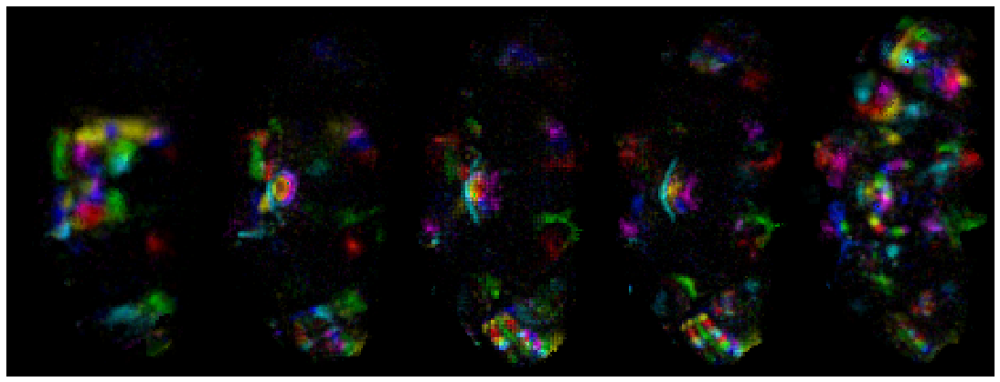

In [85]:
pylab.rcParams['figure.figsize'] = (15, 6)
C2=np.zeros(3)

Df=np.zeros([S[0],S[1],5,3]) 
  
for i in range(3):
    #Df[:,:,:,i]=Final_map[:,:,:,i]+Dmean/50
    #Df=Df/(np.max(np.max(Df)))
    Df[:,:,:,i]=Final_map[:,:,:,i]
    #Df=Df/(np.max(np.max(Df)))
    
if S[2]>5:
    N=Nstack
else:
    N=S[2]
for i in range(N):
    #if Good_ICs[j]:
        plt.subplot(1,N,i+1)
        plt.imshow(Dmean[:,:,i],cmap=plt.cm.gray)
        plt.imshow(Df[:,:,i,:],cmap=my_cmap,interpolation='none')
        frame1 = plt.gca()
        frame1.axes.get_xaxis().set_visible(False)
        frame1.axes.get_yaxis().set_visible(False)
plt.tight_layout(pad=0,w_pad=0,h_pad=0)
  

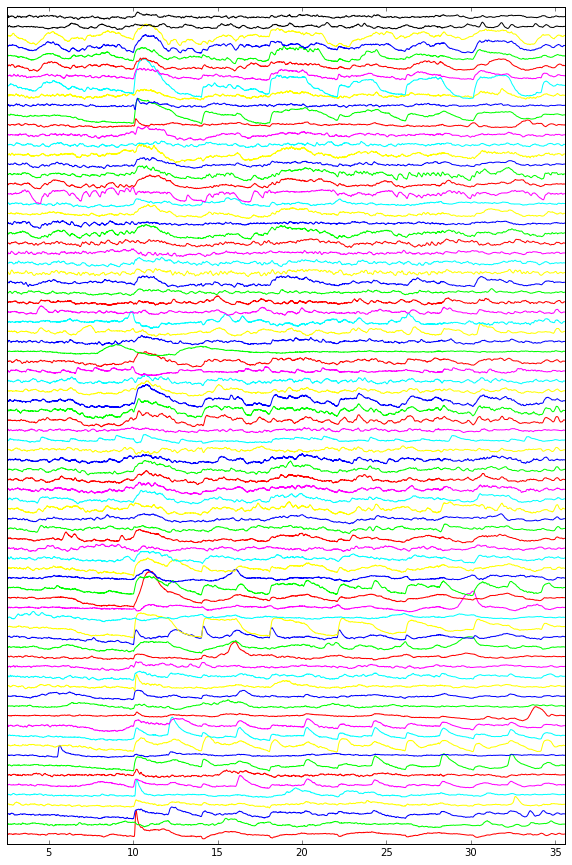

In [86]:
pylab.rcParams['figure.figsize'] = (10, 15)
h=0.5
i=0

for j in range(S[3]):
    if GoodICo[j]:
        plt.plot(Time_fluoICA,(DTo[:,j]+h*i),color=C[j,:]) 
        i=i+1
plt.xlim([np.min(Time_fluoICA),np.max(Time_fluoICA)])
plt.ylim([-0.5,h*i])
frame1 = plt.gca()
frame1.axes.get_yaxis().set_visible(False)
plt.show()

In [170]:
k=0
J=np.zeros(len(GoodICo[GoodICo==1]))
for j in range(len(GoodICo)):
    if GoodICo[j]:
        print(k)
        print([CompMainName[Indexo[j]]])
        J[k]=j
        k=k+1

0
['ME_L']
1
['ME_L']
2
['ME_L']
3
['ME_L']
4
['ME_L']
5
['ME_L']
6
['ME_L']
7
['ME_L']
8
['ME_L']
9
['ME_L']
10
['ME_L']
11
['ME_L']
12
['ME_L']
13
['ME_L']
14
['ME_L']
15
['ME_L']
16
['ME_L']
17
['ME_L']
18
['ME_R']
19
['ME_R']
20
['ME_R']
21
['ME_R']
22
['ME_R']
23
['LO_R']
24
['LO_R']
25
['LO_L']
26
['LOP_R']
27
['LOP_R']
28
['PLP_R']
29
['IVLP_R']
30
['IVLP_L']
31
['AL_R']
32
['AL_R']
33
['AL_R']
34
['AL_R']
35
['AL_R']
36
['AL_L']
37
['AL_L']
38
['AL_L']
39
['MB_CA_R']
40
['MB_CA_L']
41
['MB_VL_L']
42
['MB_ML_R']
43
['MB_ML_R']
44
['MB_ML_L']
45
['MB_ML_L']
46
['MB_ML_L']
47
['SMP_R']
48
['SMP_R']
49
['SMP_L']
50
['SMP_L']
51
['LH_R']
52
['LH_R']
53
['LH_R']
54
['LH_R']
55
['LH_L']
56
['IB_L']
57
['EB']
58
['EB']
59
['EB']
60
['EB']
61
['ATL_R']
62
['ATL_L']
63
['PB']
64
['PB']
65
['PB']
66
['PB']
67
['PB']
68
['FB']
69
['FB']
70
['FB']
71
['FB']
72
['BU_R']
73
['BU_R']
74
['BU_L']
75
['GA_R']
76
['SPS_R']
77
['SPS_L']
78
['IPS_R']
79
['IPS_L']
80
['AMMC_R']
81
['AMMC_R']
82
['']

In [171]:
Sets=[range(7),range(7,13),range(13,19),range(19,25),range(25,28),range(28,31),range(31,37),range(37,39),range(39,45),range(45,47),range(47,53),range(53,56),56,range(57,61),range(61,66),range(66,68),
      range(68,72),range(72,76),range(76,80),range(80,82)]

In [172]:
#Sets=[range(28),range(28,31),range(31,39),range(39,47),range(47,56),56,range(57,61),range(61,68),
#      range(68,72),range(72,76),range(76,80),range(80,82)]

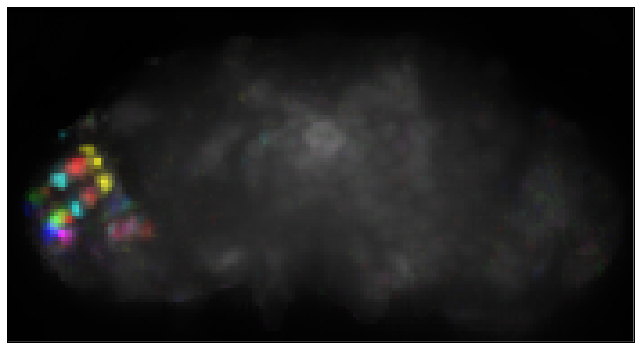

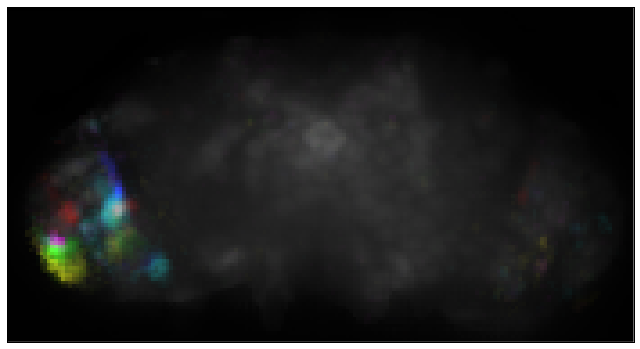

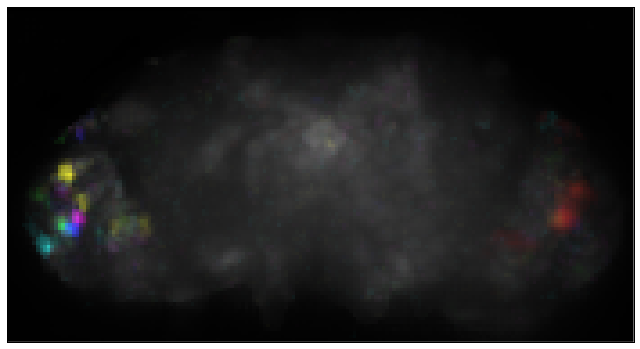

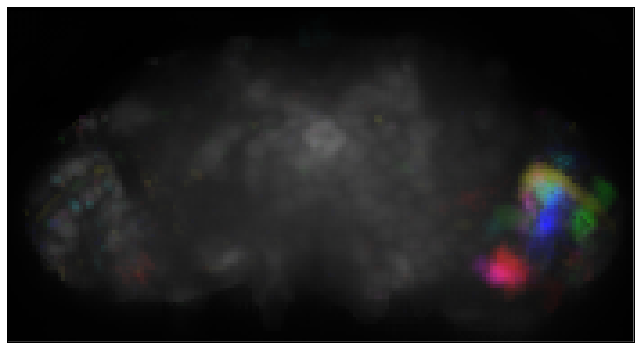

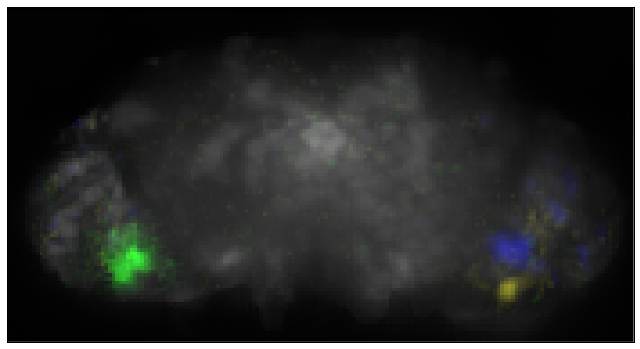

...

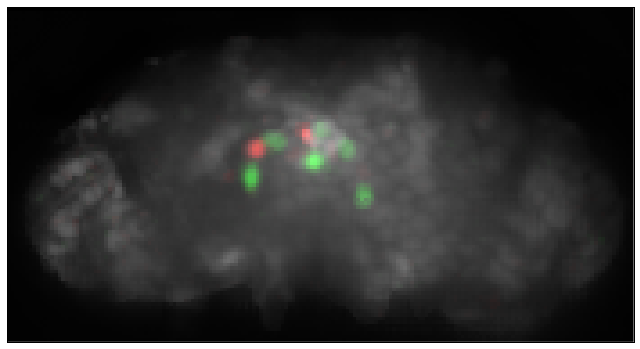

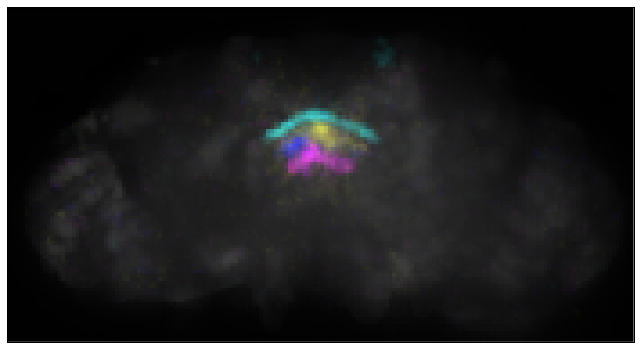

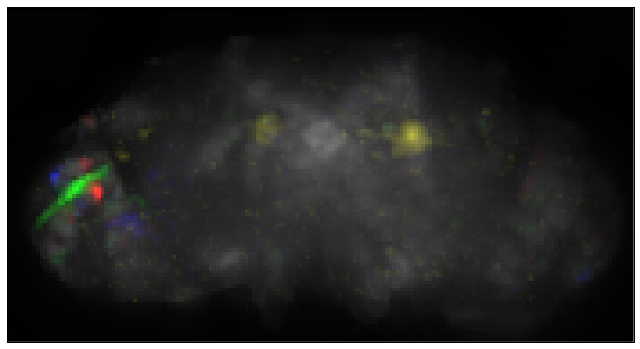

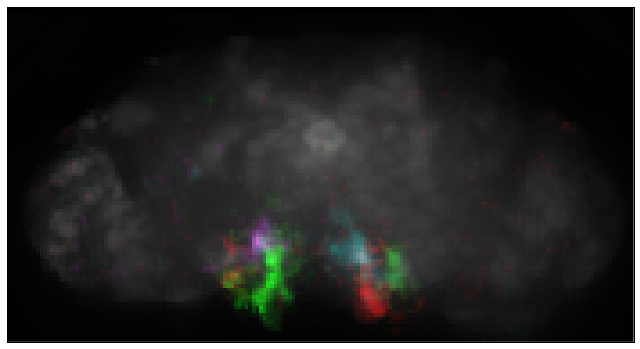

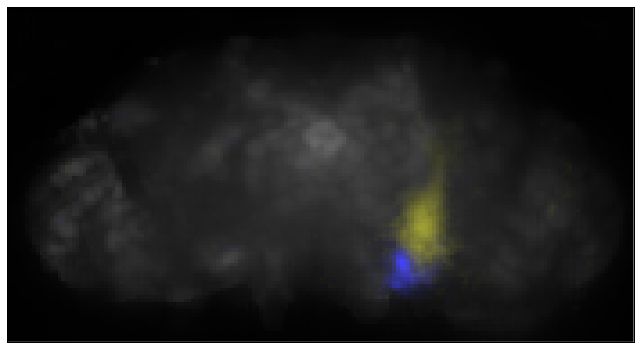

In [173]:
pylab.rcParams['figure.figsize'] = (12, 6)
SetId=np.zeros(1000)
n=0

for i in range(len(Sets)):
    
    Final_map2=np.zeros([S[0],S[1],3]) 
    Fmaps2=np.zeros([S[0],S[1],3]) 
    Final_map3=np.zeros([S[0],S[1],5,3]) 
    Fmaps3=np.zeros([S[0],S[1],5,3])     
     
    if type(Sets[i])==list:
        for j in np.array(Sets[i]):
            C=np.zeros((S[3],3))
            C[j,:]=C1[j%6][:]
            SetId[n]=i
            n=n+1
            for k in range(3):           
                M=np.max(np.squeeze(np.reshape(D2o[:,:,:,J[j]],S[0]*S[1]*5)))
                Fmaps2[:,:,k]=0.9*np.mean(D2o[:,:,:,J[j]],2)*C[j,k]/M
                for l in range(5):
                    M=np.max(np.squeeze(np.reshape(D2o[:,:,l,J[j]],S[0]*S[1],5)))
                    Fmaps3[:,:,l,k]=0.9*D2o[:,:,l,J[j]]*C[j,k]/M                
            Final_map2=Final_map2+Fmaps2
            Final_map3=Final_map3+Fmaps3            
                
    else:
        j=Sets[i]
        C[j,:]=C1[j%6][:]
        SetId[n]=i
        n=n+1
        for k in range(3):           
            M=np.max(np.squeeze(np.reshape(D2o[:,:,:,J[j]],S[0]*S[1]*5)))
            Fmaps2[:,:,k]=0.9*np.mean(D2o[:,:,:,J[j]],2)*C[j,k]/M
            for l in range(5):
                M=np.max(np.squeeze(np.reshape(D2o[:,:,l,J[j]],S[0]*S[1],5)))
                Fmaps3[:,:,l,k]=0.9*D2o[:,:,l,J[j]]*C[j,k]/M 
        Final_map2=Final_map2+Fmaps2
        Final_map3=Final_map3+Fmaps3   
                
    Df=np.zeros([S[0],S[1],3]) 
    Df2=np.zeros([S[0],S[1],5,3]) 
    
    for l in range(3):
        Df[:,:,l]=Final_map2[:,:,l]+np.mean(Dmean,2)/500
        for m in range(5):
            Df2[:,:,m,l]=Final_map3[:,:,m,l]+np.mean(Dmean,2)/500
    MM=np.max(np.max(Df))
    
    Rotated=ndimage.rotate(Df[:,:,:]/MM,-90)
    a=plt.imshow(Rotated,cmap=my_cmap,interpolation='none')
    frame1 = plt.gca()
    frame1.axes.get_xaxis().set_visible(False)
    frame1.axes.get_yaxis().set_visible(False)
    
    fig1=plt.gcf()
    name='/home/sophie/Desktop/862/862863image'+str(i)+'.png'
    fig1.savefig(name)
    plt.show()

In [174]:
Tstim=np.arange(0,np.max(Time_fluoICA),0.001)

Flashes=np.zeros(Tstim.shape[0])
Odor=np.zeros(Tstim.shape[0])
for i in range(Tstim.shape[0]):
    if (Tstim[i]>10 and Tstim[i]<12) or (Tstim[i]>14 and Tstim[i]<16) or (Tstim[i]>18 and Tstim[i]<20) or (Tstim[i]>22 and Tstim[i]<24)or (Tstim[i]>26 and Tstim[i]<28)or (Tstim[i]>30and Tstim[i]<32):
        Flashes[i]=1

Flashes[Flashes==0]=np.nan


In [175]:
# from http://stackoverflow.com/questions/3579568/choosing-a-file-in-python-with-simple-dialog
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
filename = askopenfilename() # show an "Open" dialog box and return the path to the selected file
print(filename)
Ua3=sio.loadmat(filename)

/home/sophie/Downloads/behavior862_863.mat


In [176]:
DTb.shape[0]

3557

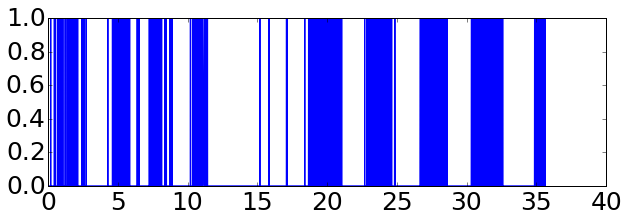

In [177]:
pylab.rcParams['figure.figsize'] = (10, 3)
DTb=Ua3['behavior862'].T
DTb.shape
Walk=np.array([float(DTb[i,2].T) for i in range(DTb.shape[0])])
Timeb=Ua3['T862'].T
plt.plot(Timeb,Walk)
Walk[Walk==0]=np.nan

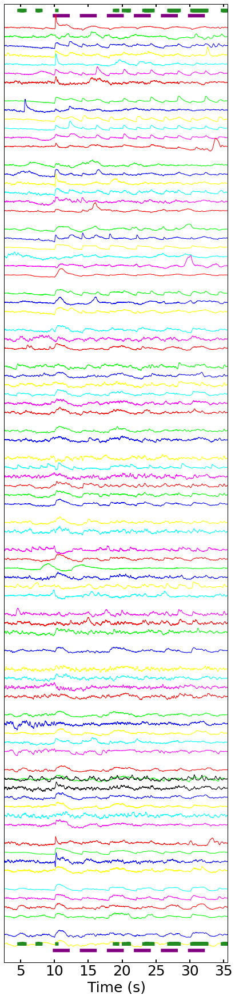

In [180]:
pylab.rcParams['figure.figsize'] = (10, 3)
C=np.zeros((S[3],3))
i=0
for j in range(S[3]):  
    if LargerRegionIo[j]<12 and GoodICo[j]:
        C[j,:]=C1[i%6][:]
        i=i+1

pylab.rcParams['figure.figsize'] = (7, 30)
h=7
i=0
plt.plot(Tstim,Flashes+8,linewidth=6,color='purple')
plt.plot(Timeb,Walk+12,linewidth=6,color='forestgreen')

for j in range(S[3]):
    if GoodICo[j]:
        plt.plot(Time_fluoICA,(DTo[:,j]/np.sqrt(np.var(DTo[:,j]))-h*i-h*SetId[i]),color=C[j,:]) 
        i=i+1
        
plt.plot(Tstim,Flashes-h*i-h*np.max(SetId)+15,linewidth=6,color='purple')
plt.plot(Timeb,Walk-h*i-h*np.max(SetId)+20,linewidth=6,color='forestgreen')

#plt.plot(Tstim,Flashes-h*i-h*np.max(SetId)+514,linewidth=4,color='purple')

plt.xlim([np.min(Time_fluoICA),np.max(Time_fluoICA)])
plt.ylim([-h*i-h*np.max(SetId)+7,18])
frame1 = plt.gca()
frame1.axes.get_yaxis().set_visible(False)
frame1.axes.set_xlabel('Time (s)')
frame1.xaxis.set_tick_params(width=2,length=5)
matplotlib.rcParams.update({'font.size': 25})
plt.savefig('/home/sophie/Desktop/862/862863imagegraph.svg')
plt.show()

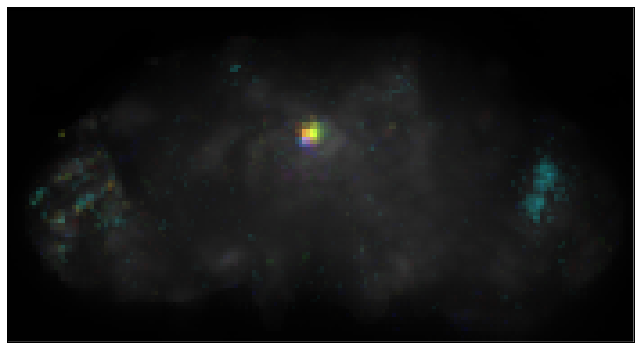

In [164]:
pylab.rcParams['figure.figsize'] = (12, 6)
SetId=np.zeros(1000)
n=0

Final_map2=np.zeros([S[0],S[1],3]) 
Fmaps2=np.zeros([S[0],S[1],3]) 
Final_map3=np.zeros([S[0],S[1],5,3]) 
Fmaps3=np.zeros([S[0],S[1],5,3])     

for j in range(61,68):
    C=np.zeros((S[3],3))
    C[j,:]=C1[(j)%6][:]
    SetId[n]=i
    n=n+1
    for k in range(3):           
        M=np.max(np.squeeze(np.reshape(D2o[:,:,:,J[j]],S[0]*S[1]*5)))
        Fmaps2[:,:,k]=0.9*np.mean(D2o[:,:,1:4,J[j]],2)*C[j,k]/M
        for l in range(5):
            M=np.max(np.squeeze(np.reshape(D2o[:,:,l,J[j]],S[0]*S[1],5)))
            Fmaps3[:,:,l,k]=0.9*D2o[:,:,l,J[j]]*C[j,k]/M                
        Final_map2=Final_map2+Fmaps2
        Final_map3=Final_map3+Fmaps3            
                

                
Df=np.zeros([S[0],S[1],3]) 
Df2=np.zeros([S[0],S[1],5,3]) 
    
for l in range(3):
    Df[:,:,l]=Final_map2[:,:,l]+np.mean(Dmean,2)/300
    for m in range(5):
        Df2[:,:,m,l]=Final_map3[:,:,m,l]+np.mean(Dmean,2)/300
MM=np.max(np.max(Df))
    
Rotated=ndimage.rotate(Df[:,:,:]/MM,-90)
a=plt.imshow(Rotated,cmap=my_cmap,interpolation='none')
frame1 = plt.gca()
frame1.axes.get_xaxis().set_visible(False)
frame1.axes.get_yaxis().set_visible(False)

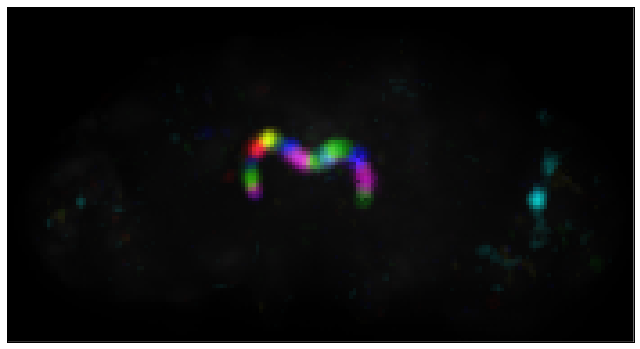

In [165]:
pylab.rcParams['figure.figsize'] = (12, 6)
SetId=np.zeros(1000)
n=0

Final_map2=np.zeros([S[0],S[1],3]) 
Fmaps2=np.zeros([S[0],S[1],3]) 
Final_map3=np.zeros([S[0],S[1],5,3]) 
Fmaps3=np.zeros([S[0],S[1],5,3])     

for j in range(61,68):
    C=np.zeros((S[3],3))
    C[j,:]=C1[(j)%6][:]
    SetId[n]=i
    n=n+1
    for k in range(3):           
        M=np.max(np.squeeze(np.reshape(D2o[:,:,:,J[j]],S[0]*S[1]*5)))
        Fmaps2[:,:,k]=0.9*np.mean(D2o[:,:,4:5,J[j]],2)*C[j,k]/M
        for l in range(5):
            M=np.max(np.squeeze(np.reshape(D2o[:,:,l,J[j]],S[0]*S[1],5)))
            Fmaps3[:,:,l,k]=0.9*D2o[:,:,l,J[j]]*C[j,k]/M                
        Final_map2=Final_map2+Fmaps2
        Final_map3=Final_map3+Fmaps3            
                

                
Df=np.zeros([S[0],S[1],3]) 
Df2=np.zeros([S[0],S[1],5,3]) 
    
for l in range(3):
    Df[:,:,l]=Final_map2[:,:,l]+np.mean(Dmean,2)/300
    for m in range(5):
        Df2[:,:,m,l]=Final_map3[:,:,m,l]+np.mean(Dmean,2)/300
MM=np.max(np.max(Df))
    
Rotated=ndimage.rotate(Df[:,:,:]/MM,-90)
a=plt.imshow(Rotated,cmap=my_cmap,interpolation='none')
frame1 = plt.gca()
frame1.axes.get_xaxis().set_visible(False)
frame1.axes.get_yaxis().set_visible(False)

In [ ]:
TS=np.zeros((S[3],86))
for i in range(1,86):
    for j in range(S[3]):
        TS[j,i]=np.mean(np.mean(np.mean(np.multiply(MasksResized[:,:,:,i],data[:,:,:,j]))))